# tflow velocity module
## Introduction
... A general treatment of a scalar/vector/tensor field

In [79]:
%matplotlib inline
# %matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import glob
import os
from importlib import reload

import tflow.graph as graph
# import library.basics.formatarray as fa
# import library.tools.rw_data as rw
# import ilpm.velocity as vel
import tflow.velocity as vel
# import library.field.velocity as vel
savedir = './results/'

In [80]:
# Plotting settings
## STYLE
graph.show_plot_styles()
graph.use_plot_style('default')


## DETAILS
__fontsize__ = 24
__figsize__ = (8, 8)
cmap = 'magma'

# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize': 16, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
          
          'lines.linewidth': 5,
         'lines.markersize': 16}

graph.update_figure_params(params)
# reset params
# pylab.rcParams.update(params)

['default', 'Solarize_Light2', '_classic_test_patch', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn', 'seaborn-bright', 'seaborn-colorblind', 'seaborn-dark', 'seaborn-dark-palette', 'seaborn-darkgrid', 'seaborn-deep', 'seaborn-muted', 'seaborn-notebook', 'seaborn-paper', 'seaborn-pastel', 'seaborn-poster', 'seaborn-talk', 'seaborn-ticks', 'seaborn-white', 'seaborn-whitegrid', 'tableau-colorblind10']


# General treatment

## For demo, use a slice of turbulent velocity field

velocity shape (height, width, depth, duration):  (1024, 1024, 2, 2)


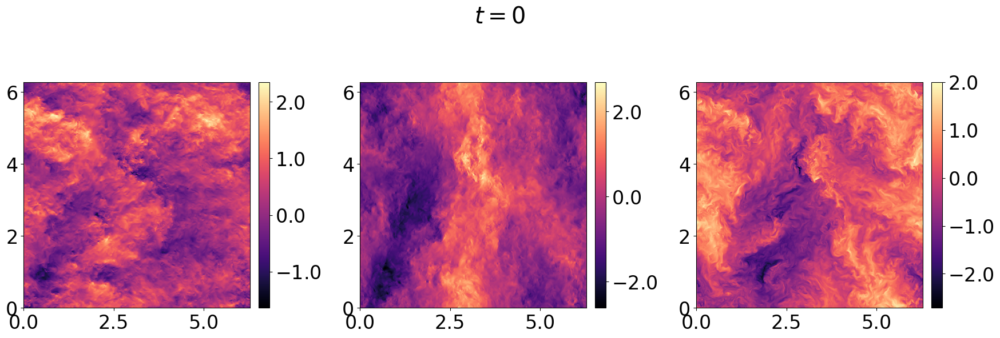

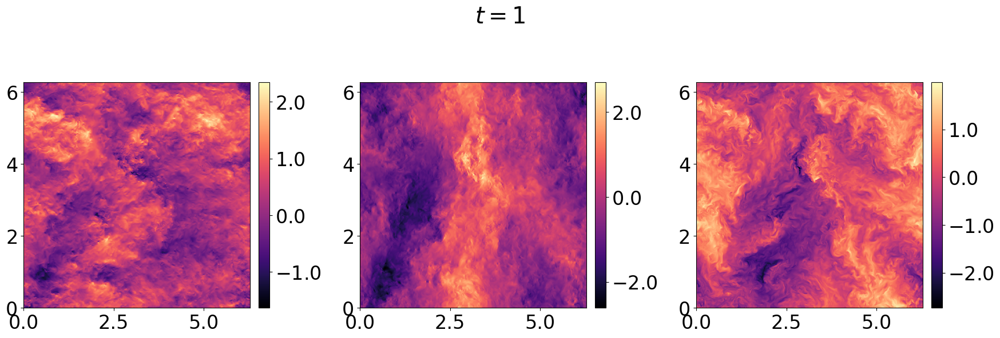

In [40]:
import importlib
importlib.reload(vel)
# Load a sample turbulent velocity field
dx = dy= dz = 2 * np.pi / 1024
udata, xx, yy, zz = vel.get_sample_turb_field_3d(return_coord=True)
ux, uy, uz = udata[0, ...], udata[1, ...], udata[2, ...]
print('velocity shape (height, width, depth, duration): ', uz.shape)

# Heat map of ux, uy, uz
t0 = 0
z0 = 0
fig1, ax11, cc21 = graph.color_plot(xx[..., z0], yy[..., z0], ux[..., z0, t0], fignum=1, subplot=131)
fig1, ax12, cc22 = graph.color_plot(xx[..., z0], yy[..., z0], uy[..., z0, t0], fignum=1, subplot=132)
fig1, ax13, cc23 = graph.color_plot(xx[..., z0], yy[..., z0], uz[..., z0, t0], fignum=1, subplot=133, figsize=(18, 6))
graph.suptitle('$t=0$')

t0 = 1
fig2, ax21, cc21 = graph.color_plot(xx[..., z0], yy[..., z0], ux[..., z0, t0], fignum=2, subplot=131)
fig2, ax22, cc22 = graph.color_plot(xx[..., z0], yy[..., z0], uy[..., z0, t0], fignum=2, subplot=132)
fig2, ax23, cc23 = graph.color_plot(xx[..., z0], yy[..., z0], uz[..., z0, t0], fignum=2, subplot=133, figsize=(18, 6))
graph.suptitle('$t=1$')
graph.show()

In [11]:
udata.shape

(3, 1024, 1024, 2, 2)

In [12]:
# udata_2d = udata[:2, :, :, 0, 0]
# epsilon = 0.0928
# nu = 0.000185
# vel.plot_energy_spectra(udata, dx, dy, dz, nu=nu, epsilon_guess=epsilon, plot_e22=True, plot_ek=True)
# # vel.plot_energy_spectra(udata_2d, dx, dy, nu=nu, epsilon_guess=epsilon, plot_e22=True, plot_ek=True)

AttributeError: module 'tflow.velocity' has no attribute 'plot_energy_spectra'

## Get vorticity field

## Get energy and enstrophy field

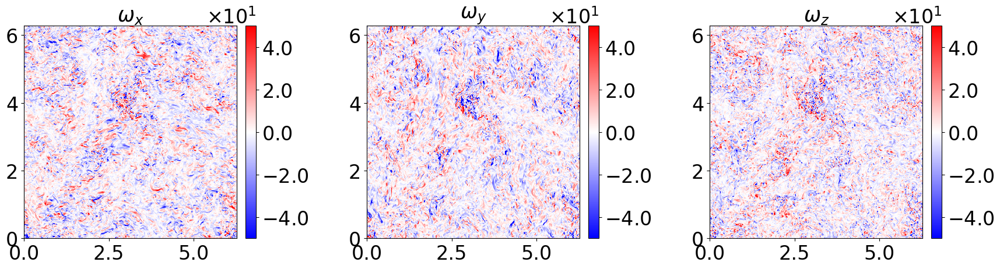

In [41]:
reload(vel)

dx = dy= dz = 2 * np.pi / 1024
omega = vel.curl(udata, dx=dx, dy=dy, dz=dz, xx=xx, yy=yy, zz=zz)

t0 = 0
z0 = 0
omegax = omega[0, ..., z0, t0]
omegay = omega[1, ..., z0, t0]
omegaz = omega[2, ..., z0, t0]
fig1, ax1, cc1 = graph.color_plot(xx[..., z0], yy[..., z0], omegax, fignum=1, subplot=131, cmap='bwr', vmin=-50, vmax=50)
fig2, ax2, cc2 = graph.color_plot(xx[..., z0], yy[..., z0], omegay, fignum=1, subplot=132, cmap='bwr', vmin=-50, vmax=50)
fig3, ax3, cc3 = graph.color_plot(xx[..., z0], yy[..., z0], omegaz, fignum=1, subplot=133, cmap='bwr', vmin=-50, vmax=50, figsize=(18, 6))

# graph.add_colorbar(cc1, ax=ax1)
# graph.add_colorbar(cc2, ax=ax2)
# graph.add_colorbar(cc3, ax=ax3)

graph.title(ax1, '$\omega_x$', fontsize=25)
graph.title(ax2, '$\omega_y$', fontsize=25)
graph.title(ax3, '$\omega_z$', fontsize=25)
graph.show()

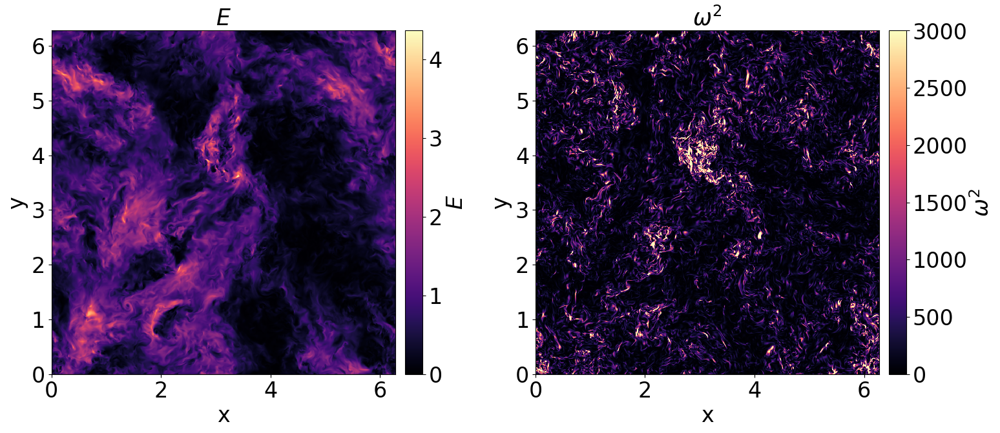

In [42]:
reload(vel)
z0, t0= 0, 0

energy = vel.get_energy(udata)
enstrophy = vel.get_enstrophy(udata, dx=dx, dy=dy, dz=dz)
fig1, ax1, cc1 = graph.color_plot(xx[..., z0], yy[..., z0], energy[..., z0, t0], fignum=1, subplot=121, vmin=0, cbar=False)
fig1, ax2, cc2 = graph.color_plot(xx[..., z0], yy[..., z0], enstrophy[..., z0, t0], fignum=1, subplot=122, vmin=0, vmax=3000, figsize=(16, 8), cbar=False)

graph.add_colorbar(cc1, ax=ax1, label='$E$')
graph.add_colorbar(cc2, ax=ax2, label='$\omega ^2$')

graph.title(ax1, '$E$', fontsize=25)
graph.title(ax2, '$\omega ^2$', fontsize=25)
graph.labelaxes(ax1, 'x', 'y')
graph.labelaxes(ax2, 'x', 'y')

fig1.tight_layout()

# Time Evolution

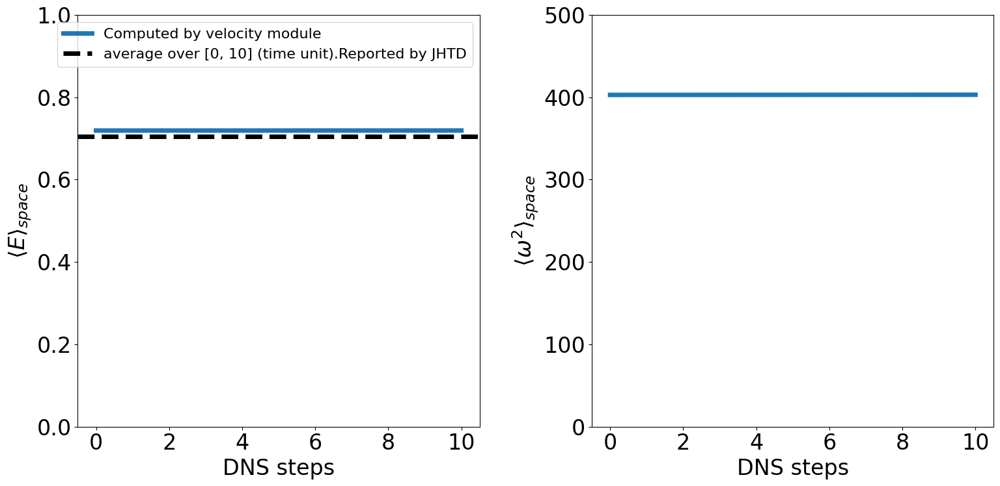

In [39]:
e_space_avg = vel.get_spatial_avg_energy(udata)[0]
enst_space_avg = vel.get_spatial_avg_enstrophy(udata, dx=dx, dy=dy, dz=dz, xx=xx, yy=yy, zz=zz)[0]
time = [0, 10]
fig, ax = graph.plot(time, e_space_avg, label='Computed by velocity module', subplot=121)
fig, ax2 = graph.plot(time, enst_space_avg, subplot=122, figsize=(16, 8 ))
graph.axhline(ax, y=0.705, label='average over [0, 10] (time unit).Reported by JHTD')
ax.set_ylim(bottom=0, top=1)
ax2.set_ylim(bottom=0, top=500)
ax.legend()
graph.labelaxes(ax, 'DNS steps', '$\\langle E \\rangle_{space}$')
graph.labelaxes(ax2, 'DNS steps', '$\\langle \omega^2 \\rangle_{space}$')
fig.tight_layout()

# Energy spectrum

## Energy spectrum
... 3D requires a fix.

Using tqdm_notebook. If this is a mistake, set notebook=False
0.4411862822788113 0.6239316239316242 1.4142135623730148
0.4411862822788113 0.6239316239316242 1.4142135623730148
Check Parseval theorem:  524811.6514194042 524811.6514194639
Spatially averagd energy:  0.5004993929094924 [0.50049939 0.50060054]


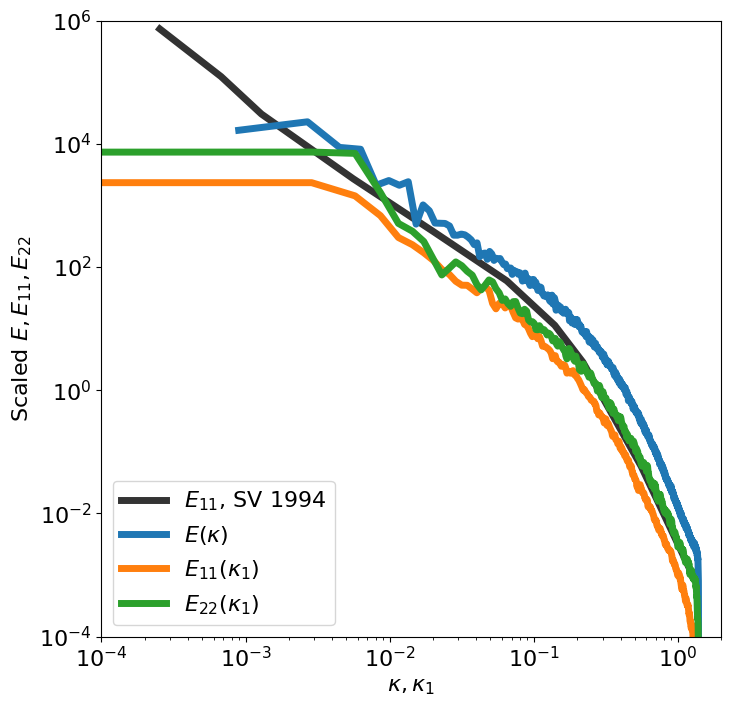

In [223]:
import importlib
importlib.reload(vel)
__fontsize__ = 16
__figsize__ = (8, 8)
cmap = 'magma'

# Basic numbers about JHTD data
z0, t0 = 0 , 0
L = udata[0].shape[0] # system size
Lx, Ly, Lz = 2 * np.pi, 2 * np.pi, 2 * np.pi
dx = dy= dz = 2 * np.pi / 1023
epsilon = 0.0928
nu = 0.000185
eta = 0.00280

udata2d = udata[:2, :, :, 0, :]
xx, yy = vel.get_equally_spaced_grid(udata2d, spacing=dx)

# Parameters to conduct analysis.
# In order to avoid strange behavior due to periodic boundary condition, 
# use data only in a specified region: u[y0:y1, x0:x1, z0:z1, :]
x0, x1, y0, y1, z0, z1 = 0, 700, 0, 700, 0, 2

# Display results corresponding to t=0
t = 0 

# PLOTTING
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize': 16, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)

dx = dy = 2*np.pi/1024.
height, width, duration = udata2d[0].shape
n_samples = width * height
n = n_samples

ek2d, ks = vel.get_energy_spectrum_nd(udata2d, dx=dx, dy=dy)
ek_s, ek_s_err, kr_s = vel.get_rescaled_energy_spectrum(udata2d, dx=dx, dy=dx,epsilon=epsilon, nu=nu)
eij_s, eij_s_err, k_s = vel.get_1d_rescaled_energy_spectrum(udata2d, dx=dx, dy=dx,epsilon=epsilon, nu=nu)
e11, e22 = eij_s[0, ...], eij_s[1, ...]


fig3, ax3 = graph.plot_saddoughi(fignum=3, color='k', label='$E_{11}$, SV 1994', alpha=0.8)
fig3, ax3 = graph.plot(kr_s[:, 0], ek_s[:, 0], fignum=3, label='$E(\kappa)$')
fig3, ax3 = graph.plot(k_s[:, 0], e11[:, 0], fignum=3, label='$E_{11}(\kappa_1)$')
fig3, ax3 = graph.plot(k_s[:, 0], e22[:, 0], fignum=3, label='$E_{22}(\kappa_1)$')



graph.tologlog(ax3)
graph.setaxes(ax3, 10**-4, 2, 10**-4, 10**6)
# graph.setaxes(ax3, 10**-4, 2, 10**1.8, 10**2.5)
graph.labelaxes(ax3, '$\kappa, \kappa_1$', 'Scaled $E, E_{11}, E_{22}$')
ax3.legend(loc=3)

energy = vel.get_energy(udata2d)
e_space_avg, _ = vel.get_spatial_avg_energy(udata2d)
print('Check Parseval theorem: ',  np.sum(energy[..., 0]), np.sum(ek2d[..., 0]))
print('Spatially averagd energy: ', np.sum(ek2d[..., 0]) / n, e_space_avg)
# graph.save('./jhtd_espec')

## Rescaled Energy spectrum
... Again, be careful about the convetion regarding $k$. fapm.velocity uses $k=2\pi / L$ but the popular convention in turbulence community is $k=1/L$.
... Notice that I plotted using $k/(2\pi)$.

In [30]:
reload(vel)
epsilon = 0.103
nu = 0.000185
eta = (nu**3 / epsilon) ** 0.25
# Plot results corresponding to t=0
t0 = 0

Using tqdm_notebook. If this is a mistake, set notebook=False
0.4411862822788113 0.6239316239316242 1.4142135623730148
0.4411862822788113 0.6239316239316242 1.4142135623730148


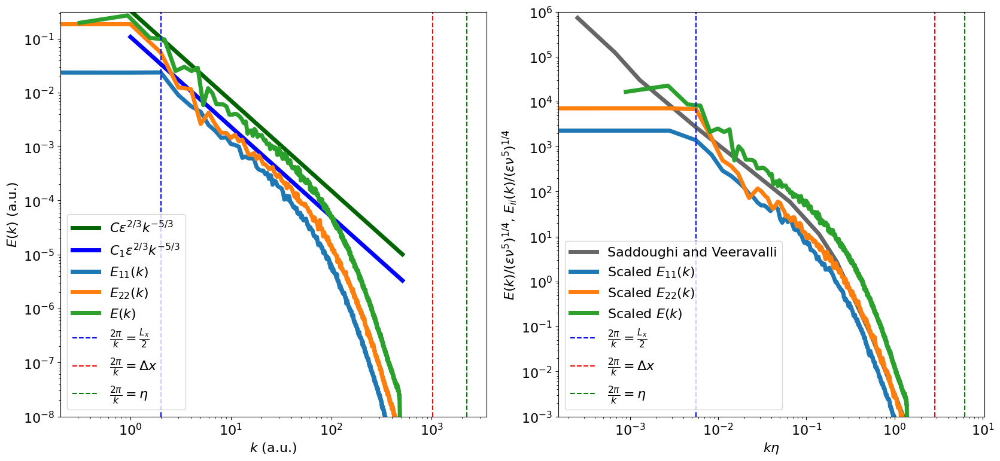

In [224]:
import importlib
importlib.reload(vel)
# PLOTTING
__fontsize__ = 16
__figsize__ = (17, 8)
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize': 16, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)


epsilon=0.103

# Compute E(k)
ek, ek_err, kr = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx)

# Computing e11, e22
dx = 2*np.pi / 1024.
eii_arr, eii_err_arr, kx = vel.get_1d_energy_spectrum(udata2d, dx=dx)
eii_arr_s, eii_err_arr_s, kx_s = vel.get_1d_rescaled_energy_spectrum(udata2d, epsilon=epsilon, nu=nu, dx=dx)


e11k, e11k_err = eii_arr[0, :, 0], eii_err_arr[0, :, 0]
e22k, e22k_err = eii_arr[1, :, 0], eii_err_arr[1, :, 0]
fig1, ax1 = graph.plot(kx, vel.kolmogorov_53_uni(kx, epsilon, c=1.5), fignum=1, subplot=121, color='darkgreen', label='$C\epsilon^{2/3}k^{-5/3}$', linewidth=5)
fig1, ax1 = graph.plot(kx, vel.kolmogorov_53_uni(kx, epsilon, c=1.5*18./55.), fignum=1, subplot=121,
                       color='b', label='$C_1\epsilon^{2/3}k^{-5/3}$', linestyle='-', linewidth=5)
fig1, ax1 = graph.plot(kx, e11k, fignum=1, subplot=121, label='$E_{11}(k)$', linewidth=5)
fig1, ax1 = graph.plot(kx, e22k, fignum=1, subplot=121, label='$E_{22}(k)$', linewidth=5)
fig1, ax1 = graph.plot(kr[:, 0], ek[:, 0], fignum=1, subplot=121, label='$E(k)$', linewidth=5, color='C2')
# fig1, ax1, cc11 = graph.errorfill(kx, e11k, e11k_err, fignum=1, subplot=121, label='$E_{11}(k)$', linewidth=5)
# fig1, ax1, cc12 = graph.errorfill(kx, e22k, e22k_err, fignum=1, subplot=121, label='$E_{22}(k)$', linewidth=5)
# fig1, ax1, cc13 = graph.errorfill(kr[:, 0], ek[:, 0], ek_err[:, 0], fignum=1, subplot=121, label='$E(k)$', linewidth=5, color='C2')

# rescaled spectrum
e11k_s, e11k_err_s  = eii_arr_s[0, :, 0], eii_err_arr_s[0, :, 0]
e22k_s, e22k_err_s  = eii_arr_s[1, :, 0], eii_err_arr_s[0, :, 0]

fig1, ax2 = graph.plot_saddoughi(fignum=1, subplot=122, color='k', linewidth=5, label='Saddoughi and Veeravalli')
fig1, ax2 = graph.plot(kx_s[:, 0], e11k_s, fignum=1, subplot=122, linewidth=5,  label='Scaled $E_{11}(k)$')
fig1, ax2 = graph.plot(kx_s[:, 0], e22k_s, fignum=1, subplot=122, linewidth=5,  label='Scaled $E_{22}(k)$')
fig1, ax2 = graph.plot(kr_s[:, 0], ek_s[:, 0], fignum=1, subplot=122, label='Scaled $E(k)$', linewidth=5, color='C2')

# fig1, ax2, cc21 = graph.errorfill(kx_s, e11k_s, e11k_err_s, fignum=1, subplot=122, linewidth=5,  label='Scaled $E_{11}(k)$')
# fig1, ax2, cc22 = graph.errorfill(kx_s, e22k_s, e22k_err_s, fignum=1, subplot=122, linewidth=5,  label='Scaled $E_{22}(k)$')
# fig1, ax2, cc23 = graph.errorfill(kr_s[:, 0], ek_s[:, 0], ek_err_s[:, 0], fignum=1, subplot=122, label='Scaled $E(k)$', linewidth=5, color='C2')


graph.tologlog(ax1)
graph.tologlog(ax2)


graph.axvline(ax1, x= 2*np.pi/ Lx * 2, label='$\\frac{2 \pi}{k}=\\frac{L_x}{2}$', color='blue', linewidth=1.5)
graph.axvline(ax1, x= 2*np.pi/ dx, color='red', label='$\\frac{2 \pi}{k}=\Delta x$', linewidth=1.5)
graph.axvline(ax1, x= 2*np.pi/ eta, label='$\\frac{2 \pi}{k}=\eta$', color='green', linewidth=1.5)

graph.axvline(ax2, x= 2*np.pi* eta/ Lx * 2, label='$\\frac{2 \pi}{k}=\\frac{L_x}{2}$', color='blue', linewidth=1.5)
graph.axvline(ax2, x= 2*np.pi* eta/ dx, color='red', label='$\\frac{2 \pi}{k}=\Delta x$', linewidth=1.5)
graph.axvline(ax2, x= 2*np.pi, label='$\\frac{2 \pi}{k}=\eta$', color='green', linewidth=1.5) 

ax1.legend(loc=3, fontsize=16)
ax2.legend(loc=3, fontsize=16)

graph.labelaxes(ax1, '$k$ (a.u.)',  '$E(k)$ (a.u.)')
graph.labelaxes(ax2, '$k \eta$',  '$E(k) / (\epsilon \\nu ^5)^{1/4}$, $E_{ii}(k) / (\epsilon \\nu ^5)^{1/4}$')

ax1.set_ylim(10**-8, 10**-0.5)
ax2.set_ylim(10**-3, 10**6)

fig1.tight_layout()

savedir = '/Volumes/labshared4/takumi/iPython_Notebooks/tutorials/'
# graph.save(savedir + 'e_spec_comp_jhtd_2')
# graph.save(savedir + 'e_spec_comp_jhtd_2', ext='png')

## Dissipation Spectrum, Rescaled Dissipation Spectrum

Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False


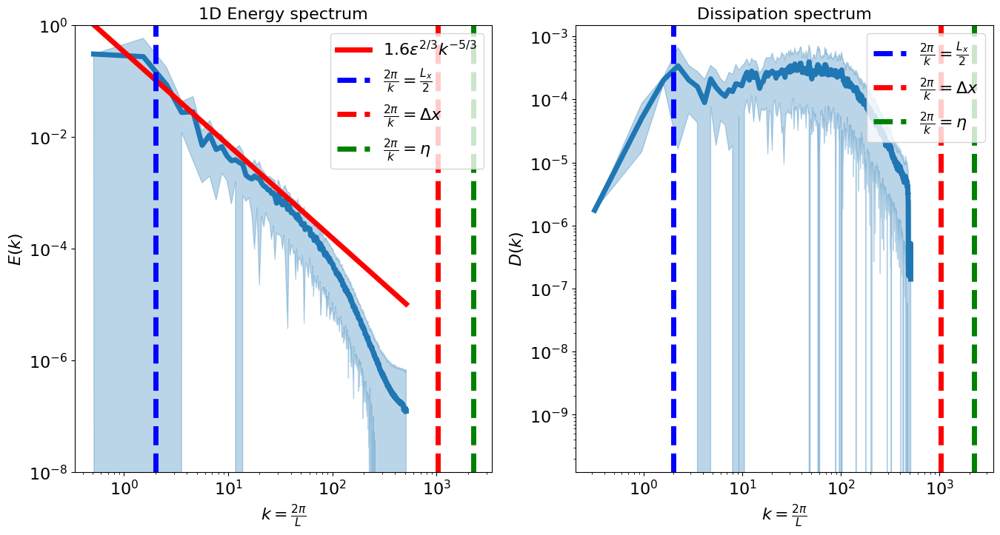

In [32]:
reload(vel)
# Basic numbers about JHTD data
z0, t0 = 0 , 0
L = udata[0].shape[0] # system size
Lx, Ly, Lz = 2 * np.pi, 2 * np.pi, 2 * np.pi
dx = dy= dz = 2 * np.pi / 1023
epsilon = 0.0928
nu = 0.000185
eta = 0.00280

# Parameters to conduct analysis.
# In order to avoid strange behavior due to periodic boundary condition, 
# use data only in a specified region: u[y0:y1, x0:x1, z0:z1, :]
x0, x1, y0, y1, z0, z1 = 0, 1000, 0, 1000, 0, 2

# Display results corresponding to t=0
t = 0 
# Plot 1D energy spectrum
e_k, e_k_err, k1d = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, dz=dx, nkout=500, x0=x0, x1=x1, y0=y0, y1=y1,z0=z0, z1=z1)
fig1, ax, patch = graph.errorfill(k1d[:, t0], e_k[:, t0], e_k_err[:,t0], fignum=1, subplot=121, figsize=(16, 8))
fig1, ax = graph.plot(k1d[:, t0], vel.kolmogorov_53_uni(k1d[:, t0], epsilon), color='r', fignum=1, subplot=121, figsize=(16, 8), label='$1.6\epsilon^{2/3} k^{-5/3}$')

# Plot dissipation spectrum
D_k, D_k_err, k1d_ = vel.get_dissipation_spectrum(udata2d, nu, dx=dx, dy=dx, dz=dx, nkout=None, x0=x0, x1=x1, y0=y0, y1=y1,z0=z0, z1=z1)
fig1, ax2, patch = graph.errorfill(k1d_[:, t0], D_k[:, t0] , D_k_err[:, t0] , fignum=1, subplot=122, figsize=(16, 8))

graph.labelaxes(ax, '$k=\\frac{2\pi}{L}$', '$E(k)$')
graph.labelaxes(ax2, '$k=\\frac{2\pi}{L}$', '$D(k)$')
graph.title(ax, '1D Energy spectrum')
graph.title(ax2, 'Dissipation spectrum')

graph.axvline(ax, x= 2*np.pi/ Lx * 2, label='$\\frac{2 \pi}{k}=\\frac{L_x}{2}$', color='blue') # Don't trust spectra for k greater than this value. this is due to p.b.c.
graph.axvline(ax, x= 2*np.pi/ dx, color='red', label='$\\frac{2 \pi}{k}=\Delta x$')
graph.axvline(ax, x= 2*np.pi/ eta, label='$\\frac{2 \pi}{k}=\eta$', color='green') # Don't trust spectra for k greater than this value. this is due to p.b.c.

graph.axvline(ax2, x= 2*np.pi/ Lx * 2, label='$\\frac{2 \pi}{k}=\\frac{L_x}{2}$', color='blue') # Don't trust spectra for k greater than this value. this is due to p.b.c.
graph.axvline(ax2, x= 2*np.pi/ dx, color='red', label='$\\frac{2 \pi}{k}=\Delta x$')
graph.axvline(ax2, x= 2*np.pi/ eta, label='$\\frac{2 \pi}{k}=\eta$', color='green') # Don't trust spectra for k greater than this value. this is due to p.b.c.

ax.legend(loc=1, fontsize=16)
ax2.legend(loc=1, fontsize=16)

ax.set_ylim(10**-8, 10**0)

graph.tologlog(ax)
graph.tologlog(ax2)

# graph.save(savedir + 'diss_spec', ext='png')


## Scaled dissipation spectrum

Using tqdm_notebook. If this is a mistake, set notebook=False
dissipation rate, Kolmogorov scale:  0.0928 0.002874033342784674


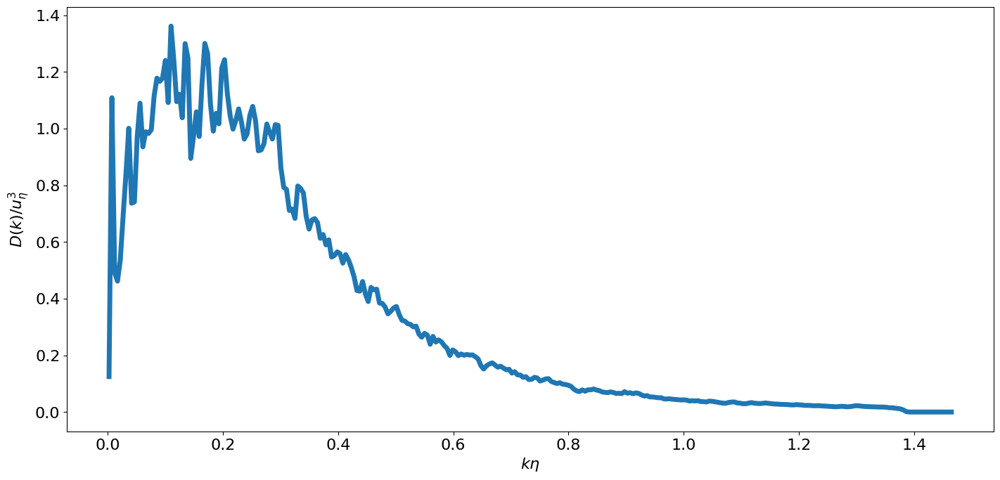

In [33]:
reload(vel)
t0 = 0
D_k_norm, D_k_err_norm, k_norm = vel.get_rescaled_dissipation_spectrum(udata2d, dx=dx, dy=dy, dz=dz, epsilon=epsilon, nu=nu, nkout=300)
fig, ax = graph.plot(k_norm[:, t0], D_k_norm[:, t0])
graph.labelaxes(ax, '$k\eta$', '$D(k)/u_\eta^3$')

# Dissipation rate $\epsilon$
1. $\epsilon \equiv 2 \nu \langle s_{ij} s_{ij}\rangle = \nu \langle \partial_i u_j \partial_i u_j \rangle = \nu \langle \omega_k \omega_k \rangle$ <br>
... Must estimate 5 out of 9 components for 2D case<br>
... With isotropy, $\epsilon=6\nu \langle (\partial_1 u_1)^2 + (\partial_2 u_2)^2 + \partial_1 u_2 \partial_2 u_1 \rangle$<br>
... <font color='red'>Highly depends on the accurate measurement of velocity gradient</font>
1. $\epsilon_{iso} = 15\nu \langle (\frac{\partial u_1}{\partial x_1})^2 \rangle=15\nu\frac{u_{i,rms}^2}{\lambda_g^2}=30\nu\frac{u_{i,rms}^2}{\lambda_f^2}$<br>
... isotropic turbulence
1. $\epsilon_{spec} = \int_0^\infty 2 \nu \kappa^2 E(\kappa) d\kappa$ <br>
... Must know the entire 1D energy spectrum.<br>
1. Estimate $\epsilon$ from structure function, collapse of the rescaled 1D energy spectra to the master curve, isotropic integral scale formula $L_{large~eddy}=\frac{k^{3/2}}{\epsilon}$, isotropic Taylor length scale formula 1. $\lambda_{iso} = \sqrt{\frac{15\nu u_{i,rms}^2}{\epsilon}}$ 

## 1.  $\epsilon \equiv 2 \nu \langle s_{ij} s_{ij}\rangle$ <br>
... With isotropy, $\epsilon=6\nu \langle (\partial_1 u_1)^2 + (\partial_2 u_2)^2 + \partial_1 u_2 \partial_2 u_1 \rangle$<br>

In [34]:
import importlib
importlib.reload(vel)
epsilon = vel.get_epsilon_using_sij(udata, dx=dx, dy=dy, dz=dz, nu=0.000185)
print('epsilon (using all 9 components of sij): ', epsilon)
vdata = np.stack((ux[:, :, 0, :], uy[:, :, 0, :]))
epsilon_2d = vel.get_epsilon_using_sij(vdata, dx=dx, dy=dy, nu=0.000185)
print('epsilon (approximated using only 4 components of sij (2D data): ', epsilon_2d)

print('Reported epsilon (average over space and time): ', 0.103)

epsilon (using all 9 components of sij):  [0.09492321 0.09488431]
epsilon (approximated using only 4 components of sij (2D data):  [0.14212338 0.1421198 ]
Reported epsilon (average over space and time):  0.103


## 2.  $\epsilon_{iso} = 15\nu \langle (\frac{\partial u_1}{\partial x_1})^2 \rangle=15\nu\frac{u_{i,rms}^2}{\lambda_g^2}=30\nu\frac{u_{i,rms}^2}{\lambda_f^2}$<br>
... isotropic turbulence<br>
... MUST compute $\lambda_{f,g}$ first

In [35]:
import importlib
importlib.reload(vel)
epsilon_iso = vel.get_epsilon_iso(udata, lambda_f=lambda_f, lambda_g=lambda_g, nu=nu)
print(epsilon_iso)

NameError: name 'lambda_f' is not defined

## 3. $\epsilon_{spec} = \int_0^\infty 2 \nu \kappa^2 E(\kappa) d\kappa$ <br>
... Must know the entire 1D energy spectrum.<br>
... <font color='red'>This method does not work unless you have a full, accurate 1D energy spectrum. </font>

In [36]:
import importlib
importlib.reload(vel)
epsilon_spec = vel.get_epsilon_using_diss_spectrum(udata2d, nu, dx=dx, dy=dy, dz=dz)
print(epsilon_spec)

Using tqdm_notebook. If this is a mistake, set notebook=False
[0.04588025 0.0459463 ]


# Two-point velocity autocorrelation functions/tensor
... Two-point velocity autocorrelation functions: $f(r, t)$, $g(r, t)$ (long., trans.)<br>
...... Taylor microscales $\lambda_f$, $\lambda_g$<br>
... Two-point velocity autocorrelation tensor: $R_{ij}(\vec{r}, t)=\langle u_i(\vec{x}) u_j(\vec{x}+\vec{r})\rangle$ <br>
... Assumptions: Isotropy and Homogeneity

## Please read! (computation tricks)
Computing two-point autocorrelation functions are computationally expensive because it needs to compute statistics of a certain quantity. Some tricks are implemented for fast turnout time. The responsible parameters are: coarse and coarse2
1. coarse: Samples r. If coarse == 1, samples all possible r. If coarse is 0.1, it samples only 10% of possible r. Range: (0,1] 
1. coarse2: This adjusts the number of data points with which statistics is calculated. Range: (0, 1]

"vel.get_two_point_vel_corr_iso" computes $R_{ij}$ and autocorrelation functions $f(r,t)$, $g(r,t)$. This could take a while. Choose coarse and coarse2 wisely.

In [38]:
from tflow import velocity as vel
reload(vel)
time = [0, 10 * 0.0002]
# Rij, autocorrs = vel.get_two_point_vel_corr_iso(udata, xx, yy, zz, time, n_bins=None, coarse=0.2, coarse2=0.2, return_rij=True)
autocorrs = vel.get_two_point_vel_corr_iso(udata2d, xx, yy, time, n_bins=None, coarse=0.2, coarse2=0.2, return_rij=False)

Compute two-point velocity autocorrelation
Using tqdm_notebook. If this is a mistake, set notebook=False



Using tqdm_notebook. If this is a mistake, set notebook=False


## Autocorrelation functions
... Autocorrelation functions $f(\vec{r}, \vec{x}, t)$ and $g(\vec{r}, \vec{x}, t)$ essentially have the same amount of information as $R_{ij}(\vec{r}, \vec{x}, t)$. <br>
... 1D Energy spectrum function is merely just a part of $R_{ij}$ and is equally meaningful as $f(\vec{r}, \vec{x}, t)$. <br>
... Once you massage these quantities by assuming isotropy and homogeneity, it becomes somewhat manageable. That is, <br>
.......$f(\vec{r}, \vec{x}, t)$ and $g(\vec{r}, \vec{x}, t)$ $\rightarrow$ $f(r, t)$ and $g(r, t)$<br>
.......$R_{ij}(\vec{r}, \vec{x}, t)$ $\rightarrow$ $R_{ij}(\vec{r}, t)$

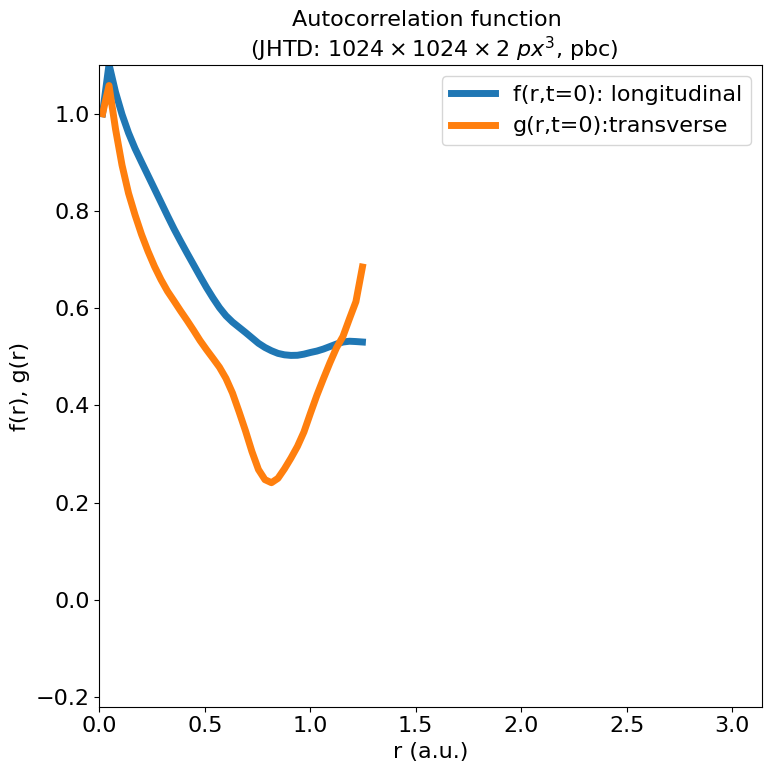

In [39]:
# Plot t=0 results
t0 = 0

# autocorrs is a tuple in which autocorrelation functions are stored.
r_long, f_long, f_err_long, r_tran, g_tran, g_err_tran = autocorrs

fig, ax = graph.plot(r_long[:, t0], f_long[:, t0], label='f(r,t=0): longitudinal')
fig, ax = graph.plot(r_tran[:, t0], g_tran[:, t0], label='g(r,t=0):transverse', figsize=(8, 8))
graph.title(ax, 'Autocorrelation function \n (JHTD: $1024 \\times 1024 \\times 2$ $px^3$, pbc)')
ax.legend(loc=1)
graph.labelaxes(ax, 'r (a.u.)', 'f(r), g(r)')
graph.setaxes(ax, 0, np.pi, -0.22, 1.1)
fig.tight_layout()
savedir = './results/'
# graph.save(savedir + 'autocorr_t0', ext='png')

## $R_{ij}$ is technically a function with arguments (i, j, (x, y, z), t, udata)

In [715]:
print Rij(0, 0, (0.0001, 0, 0), 0, udata) # should equal <ux^2> more or less
print Rij(1, 1, (0.001, 0, 0), 0, udata) # should equal <uy^2> more or less
print Rij(2, 2, (0.001, 0, 0), 0, udata) # should equal <uy^2> more or less 

print np.nanmean(udata[0]**2, axis=(0,1,2)), np.nanmean(udata[1]**2, axis=(0,1,2)), np.nanmean(udata[2]**2, axis=(0,1,2))

print 'Normalizing factor error: ', Rij(0, 0, (0.0001, 0, 0), 0, udata) / np.nanmean(udata[0]**2, axis=(0,1,2))

[0.32182319]
[0.32172422]
[0.32172422]
[0.36810589 0.36829599] [0.63226081 0.63237343] [0.43811397 0.4380009 ]
Normalizing factor error:  [0.87426798 0.87381669]


### Comments 1:
One might think $f(r=0, t) = g(r=0, t) = 1$. This is true for iso. homo; however, the discrepancy is due to the normalizing factor of $R_{ij}$ which is $\langle u_i^2 \rangle$  i.e. $\langle u_x^2 \rangle \approx \langle u_y^2 \rangle \approx \langle u_z^2 \rangle$. The truth is $\langle u_i^2 \rangle$ is almost never equal to $\langle u_x^2 \rangle$ unless it is highly isotropic and sufficient amount of averaging is done. <br>
You can see that $f(r)$ or $g(r)$ above starts around 0.7. As computed in the last line of the previous cell, this is due to the normalization. One can easily fix this by scaling if necessary. 

### Comments 2:
$R_{ij}$ is very rich in information. It includes 1D energy spectra, dissipation spectra, integral length scales, Taylor microscales, etc.
... Importantly, the Fourier Tranform of $R_{ij}(\vec{r}, t)$ is called velocity spectrum tensor $\Phi_{ij}(\vec{k}, t)$. 

## Integral length scales, $L$
1. $L_{ii}(t)=\frac{1}{ R_{ii}(0, t)}\int_0^\infty R_{ii}(r\hat{x_1}, t)dr$ <br>
... $L_{11}=\int_0^\infty f(r,t) dr$ <br>
... $L_{22}=\int_0^\infty g(r,t) dr$
1. $L_{iso, spec}=\frac{\pi}{2u_{i, rms}^2}\int_0^\infty \frac{E(\kappa)}{\kappa}d\kappa$<br>
... isotropic turbulence, Pope (6.260) <br>
... Must know the full spectrum
1. $L_{large~eddy}=\frac{k^{3/2}}{\epsilon}$

### 1. $L_{ii}(t)=\frac{1}{ R_{ii}(0, t)}\int_0^\infty R_{ii}(r, t)dr$

In [40]:
import importlib
importlib.reload(vel)
L_f, L_g = vel.get_integral_scales(r_long, f_long, r_tran, g_tran, method='trapz')
# L11, L22 = vel.get_integral_scales_using_rij(udata, Rij, np.pi)
print(L_f, L_g)
# print L11, L22

[1.0756729910015432, 1.0704460089163867] [4.878188912438672, 4.821125171684014]


### 2. $L_{iso, spec}=\frac{\pi}{2u_{i, rms}^2}\int_0^\infty \frac{E(\kappa)}{\kappa}d\kappa$
... $u_{i, rms} = \sqrt{\frac{1}{3}\langle u_x^2 + u_y^2 + u_z^2 \rangle}$

In [41]:
import importlib
importlib.reload(vel)
L_iso_spec = vel.get_integral_scales_iso_spec(udata2d, e_k, k1d)
print(L_iso_spec)
print('Reported integral length scale: ', 1.364)

[0.45613278 0.45613227]
Reported integral length scale:  1.364


### 3. $L_{large~eddy}=\frac{k^{3/2}}{\epsilon}$ <br>
... large eddy size

In [42]:
import importlib
importlib.reload(vel)
epsilon = 0.103
L_le = vel.get_integral_scale_large_eddy(udata2d, epsilon)
print(L_le)

[3.43770106 3.43874323]


## Taylor length scales
1. $\lambda_{f} = [ \frac{1}{2}\frac{\partial^2 f(r,t)}{\partial r^2} |_{r=0} ]^{-1/2}$
1. $\lambda_{g} = [ \frac{1}{2}\frac{\partial^2 g(r,t)}{\partial r^2} |_{r=0} ]^{-1/2}$
1. $\lambda_{iso} = \sqrt{\frac{15\nu u_{i,rms}^2}{\epsilon}}$ 

### 1. $\lambda_{f} = [ \frac{1}{2}\frac{\partial^2 f(r,t)}{\partial r^2} |_{r=0} ]^{-1/2}$
### 2. $\lambda_{g} = [ \frac{1}{2}\frac{\partial^2 g(r,t)}{\partial r^2} |_{r=0} ]^{-1/2}$

$\lambda_f / \lambda_g$:  [1.47658007 1.48004679]
... expected to be $\sqrt{2}$


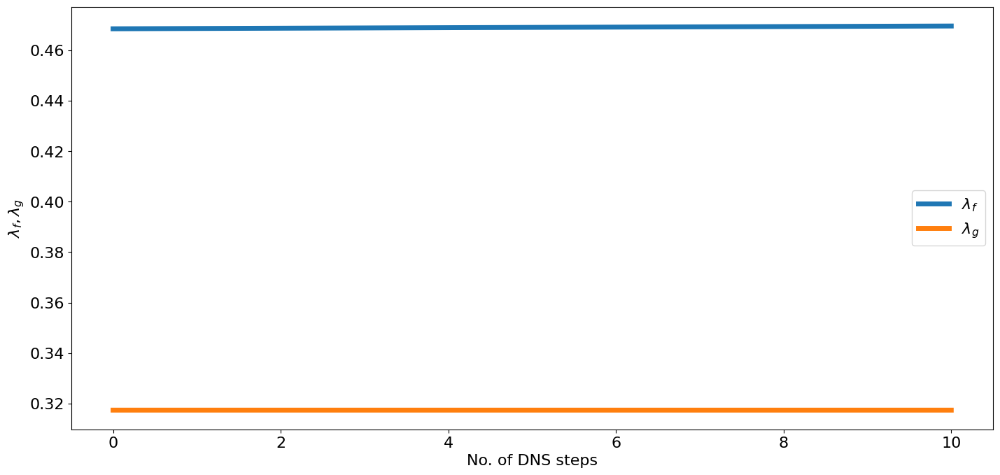

In [43]:
import importlib
## Taylor lengthscales
importlib.reload(vel)
time = [0, 10]
lambda_f, lambda_g = vel.get_taylor_microscales(r_long, f_long, r_tran, g_tran)
fig, ax = graph.plot(time, lambda_f, label='$\lambda_f$')
fig, ax = graph.plot(time, lambda_g, label='$\lambda_g$')
graph.labelaxes(ax, 'No. of DNS steps', '$\lambda_f, \lambda_g$')
ax.legend()
print('$\lambda_f / \lambda_g$: ', lambda_f / lambda_g)
print('... expected to be $\sqrt{2}$')

### 3. $\lambda_{g, iso} = \sqrt{\frac{15\nu u_{i,rms}^2}{\epsilon}}$ , $\lambda_{f, iso} = \sqrt{\frac{30\nu u_{i,rms}^2}{\epsilon}}$ 

In [44]:
import importlib
importlib.reload(vel)
epsilon = 0.0928
lambda_f_iso, lambda_g_iso = vel.get_taylor_microscales_iso(udata, epsilon, nu=nu)
print(lambda_f_iso, lambda_g_iso)

[0.16934169 0.16935285] [0.11974266 0.11975055]


# Structure functions

Using tqdm_notebook. If this is a mistake, set notebook=False



(409, 2) (409, 2) (409, 2) 0.000185


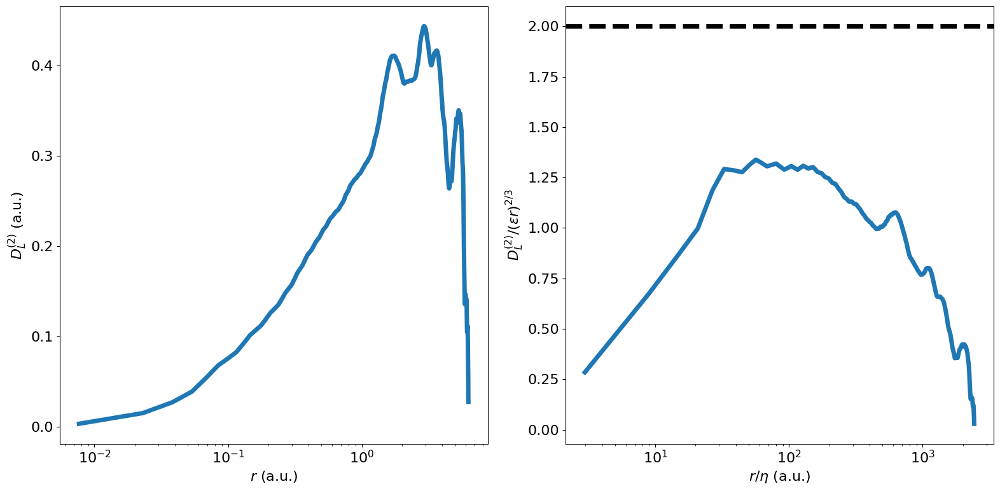

In [52]:
import importlib
importlib.reload(vel)
p = 2 # order of long. structure function
rr, DLL, DLL_err, rr_s, DLL_s, DLL_err_s = vel.get_structure_function_long(udata[:2, :, :, 0, :], 
                                                                           xx, yy, 
                                                                           p=2, nu=nu,
                                                                           coarse=0.4, coarse2=0.1)


print(rr.shape, DLL.shape, DLL_err.shape, nu)
fig, ax = graph.plot(rr[:, 0], DLL[:, 0], fignum=1, subplot=121)
fig, ax2 = graph.plot(rr_s[:, 0], DLL_s[:, 0], fignum=1, subplot=122, figsize=(16, 8))
graph.tosemilogx(ax)
graph.tosemilogx(ax2)
graph.labelaxes(ax, '$r$ (a.u.)', '$D_{L}^{(%d)}$ (a.u.)' % p)
graph.labelaxes(ax2, '$r/\eta$ (a.u.)', '$D_{L}^{(%d)} / (\epsilon r)^{%d/3}$' % (p, p))
graph.axhline(ax2, y=2.0)
fig.tight_layout()

# graph.save(savedir + 'struc_func_2')

# Isotropy (DEVELOPING)

# Spectral analysis (developing)
... Aim1. Compute spectral energy transfer. i.e. Compute Production, Transport, Dissipation on one plot!

In [57]:
import importlib
importlib.reload(vel)
# reynolds decomp
# u_mean, u_turb = vel.reynolds_decomposition(udata)
ux, uy, uz = udata[0, ...], udata[1, ...], udata[2, ...]
udata_t = np.stack((ux, uy, uz))
ukdata_t, ks = vel.fft_nd(udata_t, dx=dx, dy=dy, dz=dz)
print(ukdata_t.shape)

(3, 1024, 1024, 2, 2)


In [58]:
# Compute E(\vec{k})

E_k3d = np.zeros(ukdata_t.shape[1:])
print(E_k3d.shape, ukdata_t.shape)
for x in range(E_k3d.shape[0]):
    for y in range(E_k3d.shape[1]):
        for z in range(E_k3d.shape[2]):
            for t in range(E_k3d.shape[-1]):
                E_k3d[x, y, z, t]= np.dot(np.conjugate(ukdata_t[:, x, y, z, t]), ukdata_t[:, x, y, z, t])
print(E_k3d.shape, ks.shape)

(1024, 1024, 2, 2) (3, 1024, 1024, 2, 2)
(1024, 1024, 2, 2) (3, 1024, 1024, 2)



0.0928


(<Figure size 1700x800 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7fa1e8914590>)

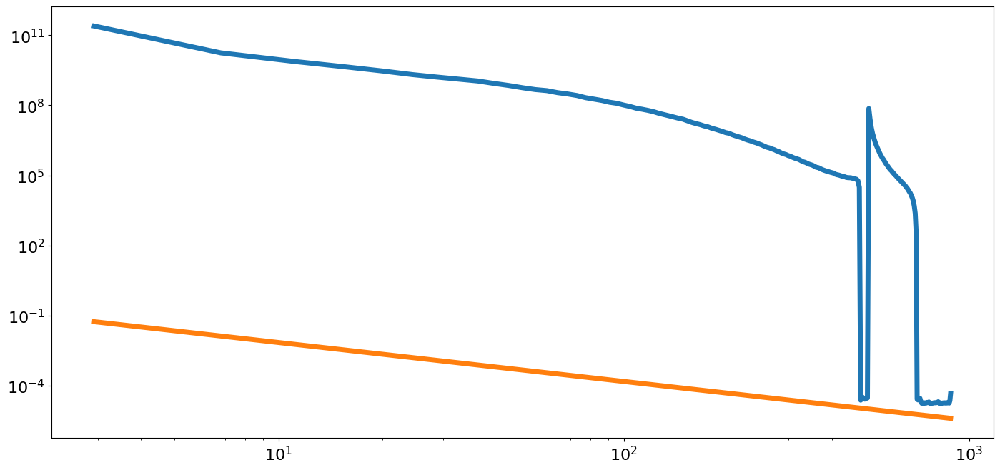

In [60]:
# Compute energy spectra using Fourier-Transformed velocity field
from scipy.stats import binned_statistic
from tqdm import tqdm_notebook as tqdm
nkout = 200
duration = E_k3d.shape[-1]
shape = (nkout, duration)
e_k1ds = np.empty(shape)
e_k1d_errs = np.empty(shape)
k1ds = np.empty(shape)

kk = np.sqrt(ks[0, ...] ** 2 + ks[1, ...] ** 2 + ks[2, ...] ** 2)

for t in tqdm(list(range(duration)), desc='time'):
    # flatten arrays to feed to binned_statistic
    kk_flatten, e_knd_flatten = kk.flatten(), E_k3d[..., t].flatten()
    # get a histogram
    k1d, _, _ = binned_statistic(kk_flatten, kk_flatten, statistic='mean', bins=nkout)
    e_k1d, _, _ = binned_statistic(kk_flatten, e_knd_flatten, statistic='mean', bins=nkout)
    e_k1d_err, _, _ = binned_statistic(kk_flatten, e_knd_flatten, statistic='std', bins=nkout)

    # Insert to a big array
    k1ds[..., t] = k1d
    e_k1ds[..., t] = e_k1d * k1d
    e_k1d_errs[..., t] = e_k1d_err
fig, ax = graph.plot(k1ds[:, 0], e_k1ds[:, 0])
graph.tologlog(ax)
print(epsilon)
graph.plot(k1ds[:, 0], vel.kolmogorov_53_uni(k1ds[:, 0], epsilon))

In [63]:
reload(vel)

from scipy.interpolate import interp2d
time = [0, 0.002]
time_list = []
for t in time:
    time_list  += [t] * len(r_long[:, 0])
f = interp2d(r_long.flatten(), time_list, f_long.flatten())
g = interp2d(r_tran.flatten(), time_list, g_tran.flatten()) 

def two_pt_velocity_autocorrelation_tensor(i, j, r, t, udata):
    dim = udata.shape[0]
    u2_avg = np.nanmean(udata ** 2, axis=tuple(range(1, dim + 1))) # spatial average u2_avg = <ux^2>= <uy^2> = <uz^2>
    if dim == 2:
        x, y = r[0], r[1]
    elif dim == 3:
        x, y, z = r[0], r[1], r[2]
    r2_norm = np.zeros_like(x)
    for k in range(dim):
        r2_norm += r[k] ** 2
    r_norm = np.sqrt(r2_norm)
    Rij = u2_avg[t] * (g(r_norm, t) * vel.kronecker_delta(i, j) + (f(r_norm , t)-g(r_norm , t)) * r[i] * r[j] / (r_norm ** 2))
    return Rij

Rij = two_pt_velocity_autocorrelation_tensor
Rij(0, 0, (1, 0, 0), 0, udata)

array([nan, nan])

## Check incompressibility condition.
$\vec{k} \cdot \vec{u}_k(\vec{k}) = 0$

In [64]:
t = 0
a, b, c = 20, 190, 0
ukx = ukdata_t[0, ..., t]
ukx, uky, ukz = ukdata_t[:, a, b, c, t]
kx, ky, kz = ks[:, a, b, c,]

print(np.dot(ks[:, a, b, c], ukdata_t[:, a, b, c, t]))

(-0.05661288719437928+0.052651064772067616j)


# Appendix: Sample velocity fields

## Example using a Rankine vortex

### Load velocity data with a rankine_vortex_line along the z-axis

In [243]:
x = range(-10, 11)
y = range(-10, 11)
z = range(-10, 11)
#meshgrid: In the 3-D case with inputs of length M, N and P, outputs are of shape (N, M, P) 
xx, yy, zz = np.meshgrid(y, x, z)
udata = vel.rankine_vortex_line_3d_gen(xx, yy, zz, a=5, axis=2)

... curl(): If the result is not sensible, consult altering xyz_orientations.
A common mistake is that udata is not origanized properly such that +x direction is not equal to +direction along the row of an arrayor +y direction is not equal to +direction along the column of an array
... curl(): If the result is not sensible, consult altering xyz_orientations.
A common mistake is that udata is not origanized properly such that +x direction is not equal to +direction along the row of an arrayor +y direction is not equal to +direction along the column of an array
... curl(): If the result is not sensible, consult altering xyz_orientations.
A common mistake is that udata is not origanized properly such that +x direction is not equal to +direction along the row of an arrayor +y direction is not equal to +direction along the column of an array


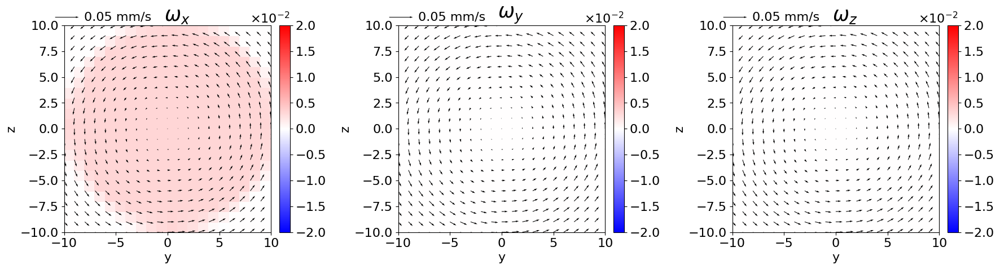

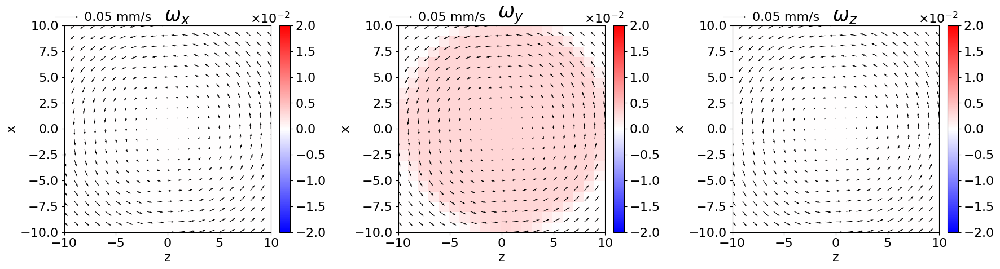

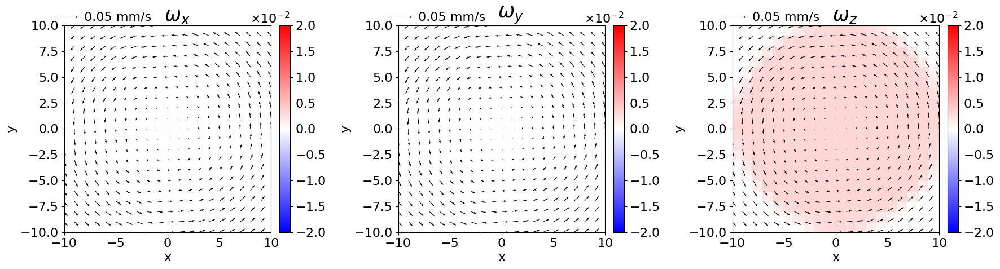

In [241]:
reload(vel)
udata_0 = vel.rankine_vortex_line_3d_gen(xx, yy, zz, a=10, axis=1) # vortex tube // x
udata_1 = vel.rankine_vortex_line_3d_gen(xx, yy, zz, a=10, axis=0) # vortex tube // y
udata_2 = vel.rankine_vortex_line_3d_gen(xx, yy, zz, a=10, axis=2) # vortex tube // z
omega_0 = vel.curl(udata_0, xx=xx, yy=yy, zz=zz)# vortex tube // x
omega_1 = vel.curl(udata_1, xx=xx, yy=yy, zz=zz)# vortex tube // y
omega_2 = vel.curl(udata_2, xx=xx, yy=yy, zz=zz)# vortex tube // z


t0 = 0
x0 = y0 = z0 = 5

interpreter = {0: 'x', 1:'y', 2: 'z'}
for d in range(3):
    fig, ax, cc = graph.color_plot(yy[:, x0, :], zz[:, x0, :], omega_0[d, :, x0, :, t0],
                                   fignum=1, subplot=131+d, cmap='bwr', vmin=-0.02, vmax=0.02,
                                   figsize=(18, 6))
    graph.quiver(yy[:, x0, :], zz[:, x0, :], udata_0[1, :, x0, :], udata_0[2, :, x0, :],
                 ax=ax, 
                 key_loc=[0.07, 1.04], key_length=0.05, key_fmt='.2f' )
    graph.title(ax, '   $\omega_%s$' % interpreter[d], fontsize=25)
    graph.labelaxes(ax, 'y' , 'z')


for d in range(3):
    fig, ax, cc = graph.color_plot(zz[y0, :, :], xx[y0, :, :], omega_1[d, y0, :, :, t0],
                                   fignum=2, subplot=131+d, cmap='bwr', vmin=-0.02, vmax=0.02,
                                   figsize=(18, 6))
#     fig, ax, cc = graph.color_plot(xx[y0, :, :], xx[y0, :, :], aa[y0, :, :],
#                                    fignum=2, subplot=131+d, cmap='bwr',
#                                    figsize=(18, 6))
    graph.quiver(zz[y0, :, :], xx[y0, :, :], udata_1[2, y0, :, :], udata_1[0, y0, :, :],
                 ax=ax, 
                 key_loc=[0.07, 1.04], key_length=0.05, key_fmt='.2f' )
    graph.title(ax, '   $\omega_%s$' % interpreter[d], fontsize=25)
    graph.labelaxes(ax, 'z' , 'x')


for d in range(3):
    fig, ax, cc = graph.color_plot(xx[..., z0], yy[..., z0], omega_2[d, ..., z0, t0],
                                   fignum=3, subplot=131+d, cmap='bwr', vmin=-0.02, vmax=0.02,
                                   figsize=(18, 6))
    graph.quiver(xx[..., z0], yy[..., z0], udata_2[0, ..., z0], udata_2[1, ..., z0],
                 ax=ax, 
                 key_loc=[0.07, 1.04], key_length=0.05, key_fmt='.2f' )
    graph.title(ax, '   $\omega_%s$' % interpreter[d], fontsize=25)
    graph.labelaxes(ax, 'x' , 'y')



... curl(): If the result is not sensible, consult altering xyz_orientations.
A common mistake is that udata is not origanized properly such that +x direction is not equal to +direction along the row of an arrayor +y direction is not equal to +direction along the column of an array


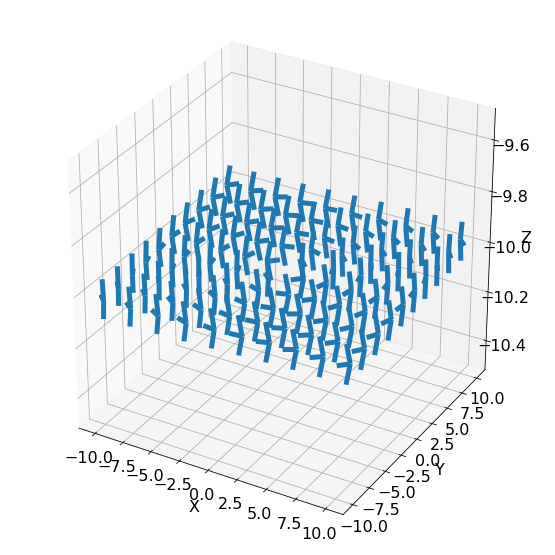

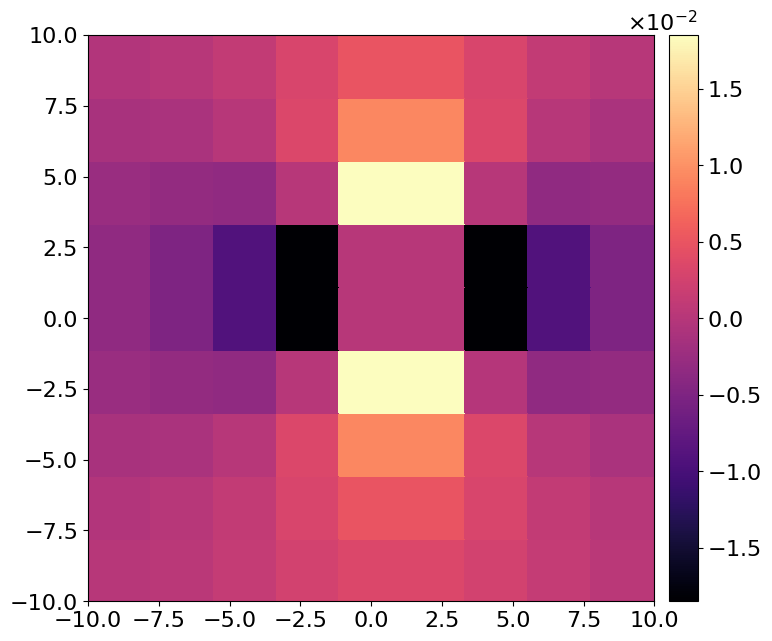

In [245]:
# Testing the sign convention in the vorticity code in 3D- VERIFIED
# %matplotlib auto
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

x, y, z = np.linspace(-10, 10, 10), np.linspace(-10, 10, 10), np.linspace(-10, 10, 10)
dx, dy, dz = x[1]-x[0],y[1]-y[0],z[1]-z[0]
xx1, yy1, zz1 = np.meshgrid(x, y, z)

# GENERATE RANKINE VORTEX FILAMENT ALONG THE Z-AXIS AT THE ORIGIN
vdata = vel.rankine_vortex_line_3d_gen(xx1, yy1, zz1, gamma=1, axis=2)
# vdata[0, ...] =-vdata[0, ...]
# vdata[1, ...] =-vdata[1, ...]
# vdata[2, ...] =-vdata[2, ...]
ev = vel.get_energy(vdata).flatten()
omega = vel.curl(vdata, dx, dy, dz)

colors, cmap, norm = graph.get_colors_and_cmap_using_values(ev, cmap='magma')


fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

m=10
## z=-10
ax.quiver(xx1[..., ::m], yy1[..., ::m], zz1[..., ::m], vdata[0,..., ::m], vdata[1,..., ::m], vdata[2,..., ::m], 
         length=1, normalize=True)
graph.color_plot(xx1[..., 0], yy1[..., 0], omega[2, ..., 0, 0], fignum=2)
## x=-10
# ax.quiver(xx1[::m, ...], yy1[::m, ...], zz1[::m, ...], vdata[0, ::m, ...], vdata[1, ::m, ...], vdata[2, ::m, ...], 
#          length=1, normalize=True)
# graph.color_plot(zz1[0, ...], xx1[0, ...], omega[1, 0, ..., 0], fignum=2)
## y=-10
# ax.quiver(xx1[:, ::m, :], yy1[:, ::m, :], zz1[:, ::m, :], vdata[0, :, ::m, :], vdata[1, :, ::m, :], vdata[2, :, ::m, :], 
#          length=1, normalize=True)
# graph.color_plot(yy1[:, 0, :], zz1[:, 0, :], omega[0, :, 0, :, 0], fignum=2)



ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

fig.tight_layout()

### Ephraim's experiment: spinning magnets

In [1162]:
import h5py

datapath = '/Volumes/labshared4/ephraim/DATA/20190405-diffusion/f10Hz_theta00_velocity.h5'
fyle = h5py.File(datapath, 'r')
ux, uy = fyle['velocity'][0], fyle['velocity'][1]

ux_ = np.swapaxes(ux, 0, 1) * 2.23
ux_ = np.swapaxes(ux_, 1, 2)
uy_ = np.swapaxes(uy, 0, 1) * 2.23
uy_ = np.swapaxes(uy_, 1, 2)

udata_ephraim = np.stack((ux_, uy_))
udata_ephraim.shape

(2, 100, 100, 296)

(<matplotlib.figure.Figure at 0x13ea111d0>,
 <matplotlib.collections.QuadMesh at 0x165de0250>)

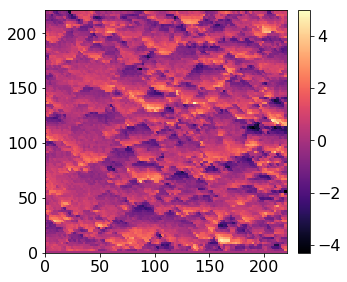

In [1163]:
xx, yy = vel.get_equally_spaced_grid(udata_ephraim, spacing=2.23)
graph.color_plot(xx, yy, udata_ephraim[0, :, :, 0])

Using tqdm_notebook. If this is a mistake, set notebook=False


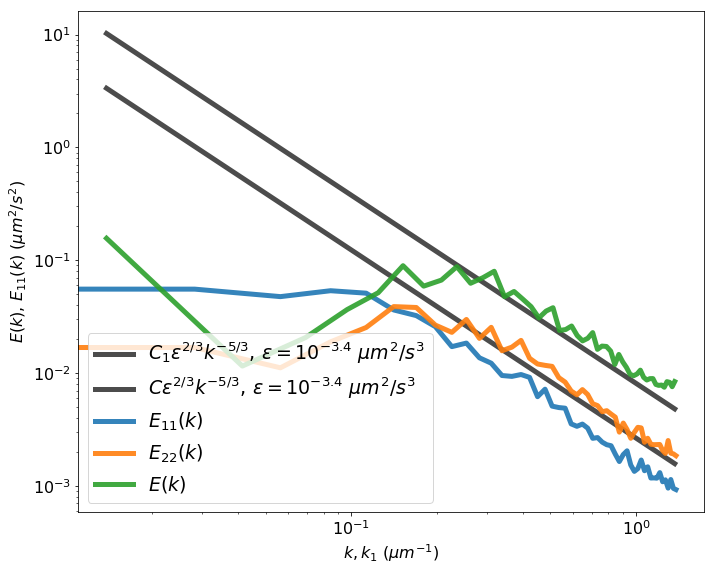

In [1164]:
reload(vel)
t0 = 0
ek, ek_err, k_rad = vel.get_energy_spectrum(udata_ephraim, dx=2.23, dy=2.23, nkout=50)
eij, eij_err, k1d = vel.get_1d_energy_spectrum(udata_ephraim, dx=2.23, dy=2.23)
e11, e22 = eij[0, ...], eij[1, ...]
graph.plot(k_rad[:, t0], vel.kolmogorov_53_uni(k_rad[:, t0], epsilon=10**-3.4, c=1.5 * 18. / 55.), linewidth=5,
           color='k', alpha=0.7, label='$C_1 \epsilon^{2/3} k^{-5/3}$, $\epsilon=10^{-3.4}$ $\mu m^2/s^3$')
graph.plot(k_rad[:, t0], vel.kolmogorov_53_uni(k_rad[:, t0], epsilon=10**-3.4, c=1.5), linewidth=5,
           color='k', alpha=0.7, label='$C \epsilon^{2/3} k^{-5/3}$, $\epsilon=10^{-3.4}$ $\mu m^2/s^3$')
graph.plot(k1d, e11[:, t0], linewidth=5, alpha=0.9, label='$E_{11}(k)$')
graph.plot(k1d, e22[:, t0], linewidth=5, alpha=0.9, label='$E_{22}(k)$')
fig, ax = graph.plot(k_rad[:, t0], ek[:, t0], linewidth=5, alpha=0.9, label='$E(k)$', figsize=(10, 8))
graph.tologlog(ax)

ax.legend(loc=3, fontsize=19)
graph.labelaxes(ax, '$k, k_1$ ($\mu m^{-1}$)', '$E(k)$, $E_{11}(k)$ ($\mu m^2/s^2$)')

fig.tight_layout()
savedir = '/Users/stephane/Desktop'
# graph.save(savedir + '/e_specs')

Using tqdm_notebook. If this is a mistake, set notebook=False
Parseval theorem:  524811.6514194042 524811.6514194639
Spatially averagd energy:  0.5004993929094924 [0.50049939 0.50060054]


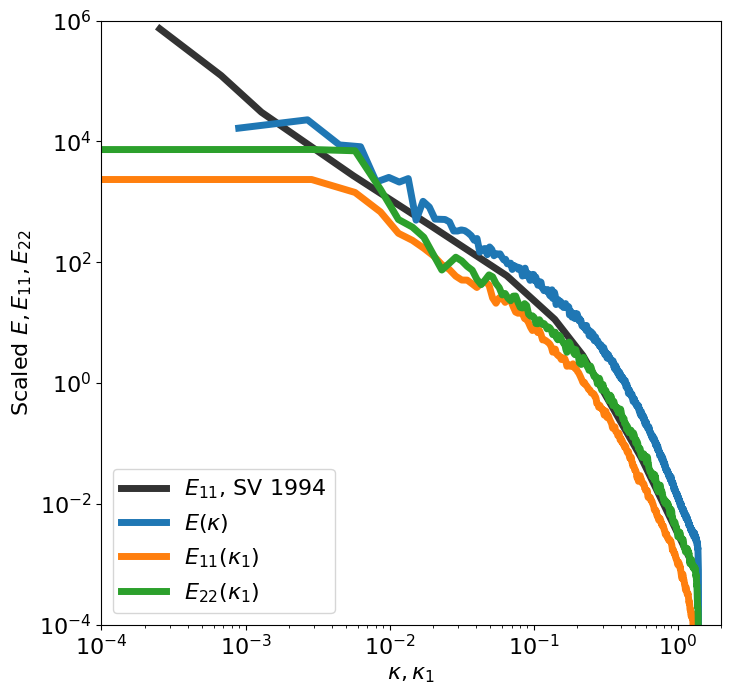

In [251]:
import importlib
importlib.reload(vel)
__fontsize__ = 16
__figsize__ = (8, 8)
cmap = 'magma'

# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize': 16, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)

# load data
udata_test, xx, yy, zz = vel.get_sample_turb_field_3d(return_coord=True)

dx = 2*np.pi/1024.
height, width, duration = udata2d.shape[1:]
n_samples = width * height
n = n_samples

ek_s, ek_s_err, kr_s = vel.get_rescaled_energy_spectrum(udata2d, dx=dx, dy=dx,epsilon=epsilon, nu=nu)
eij_s, eij_s_err, k_s = vel.get_1d_rescaled_energy_spectrum(udata2d, dx=dx, dy=dx,epsilon=epsilon, nu=nu)
e11, e22 = eij_s[0, ...], eij_s[1, ...]

fig3, ax3 = graph.plot_saddoughi(fignum=3, color='k', label='$E_{11}$, SV 1994', alpha=0.8)
fig3, ax3 = graph.plot(kr_s[:, 0], ek_s[:, 0], fignum=3, label='$E(\kappa)$')
fig3, ax3 = graph.plot(k_s[:, 0], e11[:, 0], fignum=3, label='$E_{11}(\kappa_1)$')
fig3, ax3 = graph.plot(k_s[:, 0], e22[:, 0], fignum=3, label='$E_{22}(\kappa_1)$')

graph.tologlog(ax3)
graph.setaxes(ax3, 10**-4, 2, 10**-4, 10**6)
graph.labelaxes(ax3, '$\kappa, \kappa_1$', 'Scaled $E, E_{11}, E_{22}$')
ax3.legend(loc=3)

energy = vel.get_energy(udata2d)
e_space_avg, _ = vel.get_spatial_avg_energy(udata2d)
print('Parseval theorem: ',  np.sum(energy[..., 0]), np.sum(ek2d[..., 0]))

print('Spatially averagd energy: ', np.sum(ek2d[..., 0]) / n, e_space_avg)
savedir = '/Users/stephane/Desktop/'
# graph.save(savedir + 'jhtd_espec')

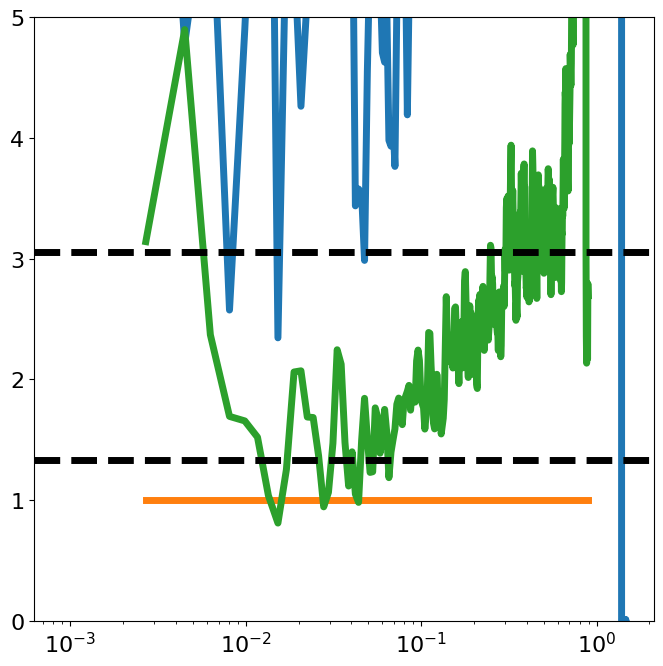

In [249]:
from scipy.interpolate import interp1d
m, n = 1,  500
f_e11 = interp1d(k_s[:, 0], e11[:, 0])
graph.plot(kr_s[:, 0], ek_s[:, 0] / f_e11(kr_s[:, 0]))
graph.plot(kr_s[m:n, 0], e11[m:n, 0] / f_e11(k_s[m:n, 0]))
fig, ax = graph.plot(kr_s[m:n, 0], e22[m:n, 0] / f_e11(k_s[m:n, 0]))
ax.set_ylim(0, 5)
graph.axhline(ax, y=1.333)
graph.axhline(ax, y=55/18.)
graph.tosemilogx()

Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tq

Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tq

Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tq

Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tq

Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tq

Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tq

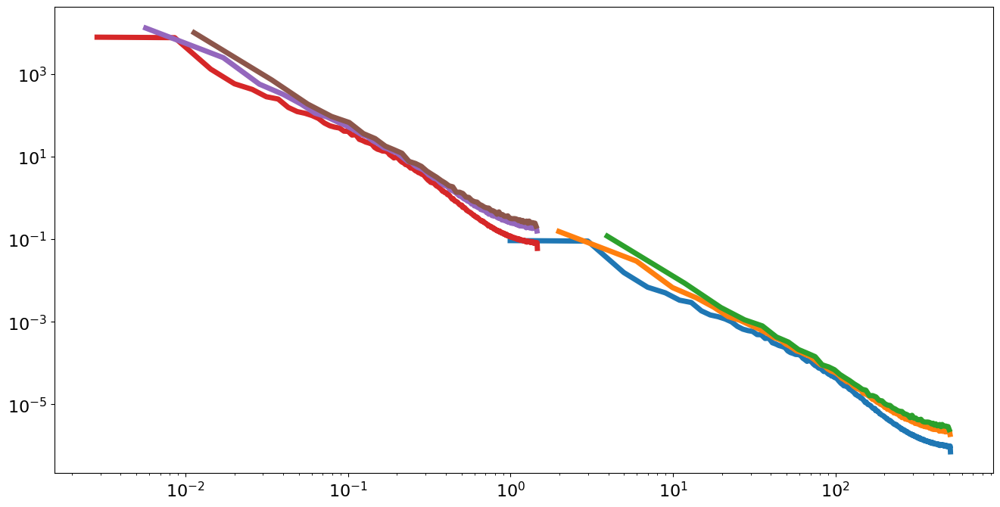

In [200]:
importlib.reload(vel)
global x0, y0
from tqdm import tqdm_notebook as tqdm
import importlib

__fontsize__ = 16
__figsize__ = (16, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize': 16, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)

udata2d = udata_test = udata[:2, :, :, 0, :]

n = 100
ek_512_arr, ek_256_arr, ek_128_arr = np.empty((256, n)), np.empty((128, n)), np.empty((64, n))
ek_s_512_arr, ek_s_256_arr, ek_s_128_arr = np.empty((256, n)), np.empty((128, n)), np.empty((64, n))

def run(t):
    ek, ek_err, kr = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx)
#     ek_900, ek_900_err, kr_900 = vel.get_energy_spectrum(f, dx=dx, dy=dx, x0=x0, x1=x0+900, y0=y0, y1=y0+900, nkout=400)
    ek_512, ek_512_err, kr_512 = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+512, y0=y0, y1=y0+512, nkout=256)
    ek_256, ek_256_err, kr_256 = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+256, y0=y0, y1=y0+256, nkout=128)
    ek_128, ek_128_err, kr_128 = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+128, y0=y0, y1=y0+128, nkout=64)
    
    
    ek_s, ek_s_err, kr_s = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu)
#     ek_s_900, ek_s_900_err, kr_s_900 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
#                                                                         x0=x0, x1=x0+900, y0=y0, y1=y0+900, nkout=400)
    ek_s_512, ek_s_512_err, kr_s_512 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
                                                                        x0=x0, x1=x0+512, y0=y0, y1=y0+512, nkout=256)
    ek_s_256, ek_s_256_err, kr_s_256 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
                                                                        x0=x0, x1=x0+256, y0=y0, y1=y0+256, nkout=128)
    ek_s_128, ek_s_128_err, kr_s_128 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
                                                                        x0=x0, x1=x0+128, y0=y0, y1=y0+128, nkout=64)

#     fig3, ax31 = graph.plot(kr[:, 0], vel.kolmogorov_53_uni(kr[:, 0], epsilon=epsilon), fignum=3, subplot=121, label='$C\epsilon^{2/3 k^{-5/3}}$', color='k')
#     fig3, ax31 = graph.plot(kr[:, 0], ek[:, 0], fignum=3, subplot=121, label='$E(\kappa)$, $1024 \\times 1024 $px$^2$')
# #     fig3, ax31 = graph.plot(kr_900[:, 0], ek_900[:, 0], fignum=3, subplot=121, label='$E(\kappa)$, $900 \\times 900 $px$^2$')
#     fig3, ax31 = graph.plot(kr_512[:, 0], ek_512[:, 0], fignum=3, subplot=121, label='$E(\kappa)$, $512 \\times 512 $px$^2$')
#     fig3, ax31 = graph.plot(kr_256[:, 0], ek_256[:, 0], fignum=3, subplot=121, label='$E(\kappa)$, $256 \\times 256 $px$^2$')
#     fig3, ax31 = graph.plot(kr_128[:, 0], ek_128[:, 0], fignum=3, subplot=121, label='$E(\kappa)$, $128 \\times 128 $px$^2$')
    
    
    
#     fig3, ax32 = graph.plot_saddoughi(fignum=3, subplot=122, color='k', label='Scaled $E_{11}$, SV 1994', alpha=0.8)
#     fig3, ax32 = graph.plot(kr_s[:, 0], ek_s[:, 0], fignum=3, subplot=122, label='Scaled $E(\kappa)$, $1024 \\times 1024 $px$^2$')
# #     fig3, ax32 = graph.plot(kr_s_900[:, 0], ek_s_900[:, 0], fignum=3, subplot=122, label='Scaled $E(\kappa)$, $900 \\times 900 $px$^2$')
#     fig3, ax32 = graph.plot(kr_s_512[:, 0], ek_s_512[:, 0], fignum=3, subplot=122, label='Scaled $E(\kappa)$, $512 \\times 512 $px$^2$')
#     fig3, ax32 = graph.plot(kr_s_256[:, 0], ek_s_256[:, 0], fignum=3, subplot=122, label='Scaled $E(\kappa)$, $256 \\times 256 $px$^2$')
#     fig3, ax32 = graph.plot(kr_s_128[:, 0], ek_s_128[:, 0], fignum=3, subplot=122, label='Scaled $E(\kappa)$, $128 \\times 128 $px$^2$')

    
    
#     graph.tologlog(ax31)
#     graph.setaxes(ax31, 10**-0.8, 10**3, 10**-8, 10**1)
#     graph.labelaxes(ax31, '$\kappa, \kappa_1$', '$E, E_{11}, E_{22}$')
#     ax31.legend(loc=3)
    
    
    
#     graph.tologlog(ax32)
#     graph.setaxes(ax32, 10**-4, 2, 10**-4, 10**6)
#     graph.labelaxes(ax32, '$\kappa \eta, \kappa_1 \eta$', 'Scaled $E, E_{11}, E_{22}$')
#     ax32.legend(loc=3)
    
    deltak = kr[1, 0] - kr[0, 0]
    deltak_512 = kr_512[1, 0] - kr_512[0, 0]
#     print kr[:5, 0], kr_512[:5, 0]
#     print deltak, deltak_512
#     print np.trapz(ek[:, 0], x=kr[:, 0])
#     print np.trapz(ek_512[:, 0], x=kr_512[:, 0]), np.nanmean(energy[y0:y0+512, x0:x0+512, 0])
#     print np.trapz(ek_256[:, 0], x=kr_256[:, 0]), np.nanmean(energy[y0:y0+256, x0:x0+256, 0])
#     print np.trapz(ek_128[:, 0], x=kr_128[:, 0]), np.nanmean(energy[y0:y0+128, x0:x0+128, 0])
#     print len(kr[:, 0]), kr[0,0], ek[0, 0]
#     print np.diff(kr[:, 0])
    ek_512_arr[:, t] = ek_512[:, 0]
    ek_256_arr[:, t] = ek_256[:, 0]
    ek_128_arr[:, t] = ek_128[:, 0]
    ek_s_512_arr[:, t] = ek_s_512[:, 0]
    ek_s_256_arr[:, t] = ek_s_256[:, 0]
    ek_s_128_arr[:, t] = ek_s_128[:, 0]
    
x0 = int(np.random.rand()*512)
y0 = int(np.random.rand()*512)

# x0 = int(np.random.rand()*512)
# y0 = int(np.random.rand()*512)
# run()
energy = vel.get_energy(udata_test)
energy_avg= vel.get_spatial_avg_energy(udata_test)
for i in tqdm(list(range(100))):
    x0 = int(np.random.rand()*512)
    y0 = int(np.random.rand()*512)
    run(i)

    
    
# dummy data
ek_512, ek_512_err, kr_512 = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+512, y0=y0, y1=y0+512, nkout=256)
ek_256, ek_256_err, kr_256 = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+256, y0=y0, y1=y0+256, nkout=128)
ek_128, ek_128_err, kr_128 = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+128, y0=y0, y1=y0+128, nkout=64)


ek_s, ek_s_err, kr_s = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu)
ek_s_512, ek_s_512_err, kr_s_512 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
                                                                    x0=x0, x1=x0+512, y0=y0, y1=y0+512, nkout=256)
ek_s_256, ek_s_256_err, kr_s_256 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
                                                                    x0=x0, x1=x0+256, y0=y0, y1=y0+256, nkout=128)
ek_s_128, ek_s_128_err, kr_s_128 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
                                                                    x0=x0, x1=x0+128, y0=y0, y1=y0+128, nkout=64)

graph.plot(kr_512[:, 0], np.nanmean(ek_512_arr, axis=1))
graph.plot(kr_256[:, 0], np.nanmean(ek_256_arr, axis=1))
graph.plot(kr_128[:, 0], np.nanmean(ek_128_arr, axis=1))
graph.plot(kr_s_512[:, 0], np.nanmean(ek_s_512_arr, axis=1))
graph.plot(kr_s_256[:, 0], np.nanmean(ek_s_256_arr, axis=1))
fig, ax = graph.plot(kr_s_128[:, 0], np.nanmean(ek_s_128_arr, axis=1))
graph.tologlog(ax)
print(energy[0])

Using tqdm_notebook. If this is a mistake, set notebook=False
0.4411862822788113 0.6239316239316242 1.4142135623730148
0.4411862822788113 0.6239316239316242 1.4142135623730148
Using tqdm_notebook. If this is a mistake, set notebook=False
0.7043446453225174 1.9921874999999996 2.8284271247462707
0.7043446453225174 1.9921874999999996 2.8284271247462707
Using tqdm_notebook. If this is a mistake, set notebook=False
0.7015825094585276 3.96875 5.656854249492381
0.7015825094585276 3.96875 5.656854249492381
Using tqdm_notebook. If this is a mistake, set notebook=False
0.6960582377305077 7.875 11.313708498984761
0.6960582377305077 7.875 11.313708498984761
Using tqdm_notebook. If this is a mistake, set notebook=False
0.4411862822788113 0.6239316239316242 1.4142135623730148
0.4411862822788113 0.6239316239316242 1.4142135623730148
Using tqdm_notebook. If this is a mistake, set notebook=False
0.7043446453225174 1.9921874999999996 2.8284271247462707
0.7043446453225174 1.9921874999999996 2.82842712474

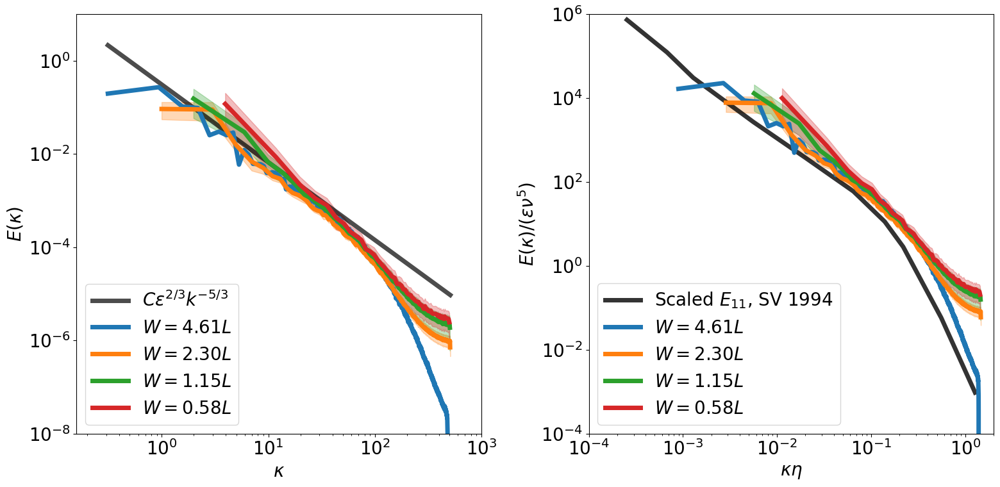

In [204]:
reload(vel)
__fontsize__ = 20
__figsize__ = (16, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':20, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)

L = 1.364 #int scale


ek, ek_err, kr = vel.get_energy_spectrum(udata_test, dx=dx, dy=dx)
#     ek_900, ek_900_err, kr_900 = vel.get_energy_spectrum(udata_test, dx=dx, dy=dx, x0=x0, x1=x0+900, y0=y0, y1=y0+900, nkout=400)
ek_512, ek_512_err, kr_512 = vel.get_energy_spectrum(udata_test, dx=dx, dy=dx, x0=x0, x1=x0+512, y0=y0, y1=y0+512, nkout=256)
ek_256, ek_256_err, kr_256 = vel.get_energy_spectrum(udata_test, dx=dx, dy=dx, x0=x0, x1=x0+256, y0=y0, y1=y0+256, nkout=128)
ek_128, ek_128_err, kr_128 = vel.get_energy_spectrum(udata_test, dx=dx, dy=dx, x0=x0, x1=x0+128, y0=y0, y1=y0+128, nkout=64)


ek_s, ek_s_err, kr_s = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu)
#     ek_s_900, ek_s_900_err, kr_s_900 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
#                                                                         x0=x0, x1=x0+900, y0=y0, y1=y0+900, nkout=400)
ek_s_512, ek_s_512_err, kr_s_512 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
                                                                    x0=x0, x1=x0+512, y0=y0, y1=y0+512, nkout=256)
ek_s_256, ek_s_256_err, kr_s_256 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
                                                                    x0=x0, x1=x0+256, y0=y0, y1=y0+256, nkout=128)
ek_s_128, ek_s_128_err, kr_s_128 = vel.get_rescaled_energy_spectrum(udata_test, dx=dx, dy=dx,epsilon=epsilon, nu=nu,
                                                                    x0=x0, x1=x0+128, y0=y0, y1=y0+128, nkout=64)

graph.plot(kr[:, 0], vel.kolmogorov_53_uni(kr[:, 0], epsilon=epsilon, c=1.5), linewidth=5,
           color='k', alpha=0.7, label='$C \epsilon^{2/3} k^{-5/3}$', subplot=121)
graph.plot(kr[:, 0], ek[:, 0], subplot=121, label='$W = %.2f L$' % (2*np.pi / L * 1024. / 1024.))
graph.errorfill(kr_512[:, 0], np.nanmean(ek_512_arr, axis=1), np.nanstd(ek_512_arr, axis=1), subplot=121, color='C1', label='$W = %.2f L$' % (2*np.pi / L * 512. / 1024.))
graph.errorfill(kr_256[:, 0], np.nanmean(ek_256_arr, axis=1), np.nanstd(ek_256_arr, axis=1), subplot=121, color='C2', label='$W = %.2f L$' % (2*np.pi / L * 256. / 1024.))
fig, ax, cc = graph.errorfill(kr_128[:, 0], np.nanmean(ek_128_arr, axis=1), np.nanstd(ek_128_arr, axis=1), subplot=121, color='C3', label='$W = %.2f L$' % (2*np.pi / L * 128. / 1024.))

graph.plot_saddoughi(fignum=1, subplot=122, color='k', label='Scaled $E_{11}$, SV 1994', alpha=0.8)
graph.plot(kr_s[:, 0], ek_s[:, 0], fignum=1, subplot=122, label='$W = %.2f L$' % (2*np.pi / L * 1024. / 1024.))
graph.errorfill(kr_s_512[:, 0], np.nanmean(ek_s_512_arr, axis=1), np.nanstd(ek_s_512_arr, axis=1), subplot=122, color='C1', label='$W = %.2f L$' % (2*np.pi / L * 512. / 1024.))
graph.errorfill(kr_s_256[:, 0], np.nanmean(ek_s_256_arr, axis=1), np.nanstd(ek_s_256_arr, axis=1), subplot=122, color='C2', label='$W = %.2f L$' % (2*np.pi / L * 256. / 1024.))
fig, ax2, cc = graph.errorfill(kr_s_128[:, 0], np.nanmean(ek_s_128_arr, axis=1), np.nanstd(ek_s_128_arr, axis=1), subplot=122, color='C3',
                               label='$W = %.2f L$' % (2*np.pi / L * 128. / 1024.))
graph.tologlog(ax)
graph.tologlog(ax2)


graph.setaxes(ax, 10**-0.8, 10**3, 10**-8, 10**1)
graph.setaxes(ax2, 10**-4, 2, 10**-4, 10**6)
graph.labelaxes(ax, '$\kappa$', '$E(\kappa)$')
graph.labelaxes(ax2, '$\kappa \eta$', '$E(\kappa)/(\epsilon \\nu^5)$')
ax.legend(loc=3)
ax2.legend(loc=3)


fig.tight_layout()
# graph.save('./espec_jhtd_cropping')


## Energy spectrum and Spectrum leakage
## Possible fix 1: Windowing
... FFT of finite data causes "spectral leaking." One could surpress this unpleasant effects by applying a window to data

1.1107207345395915
(256, 256)
Using tqdm_notebook. If this is a mistake, set notebook=False
0.7015825094585276 3.96875 5.656854249492381
0.7015825094585276 3.96875 5.656854249492381
Using tqdm_notebook. If this is a mistake, set notebook=False
0.7015825094585276 3.96875 5.656854249492381
0.7015825094585276 3.96875 5.656854249492381


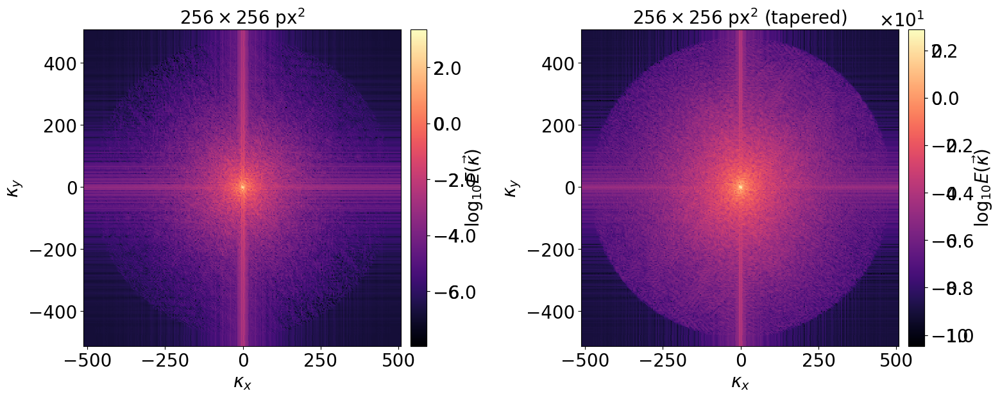

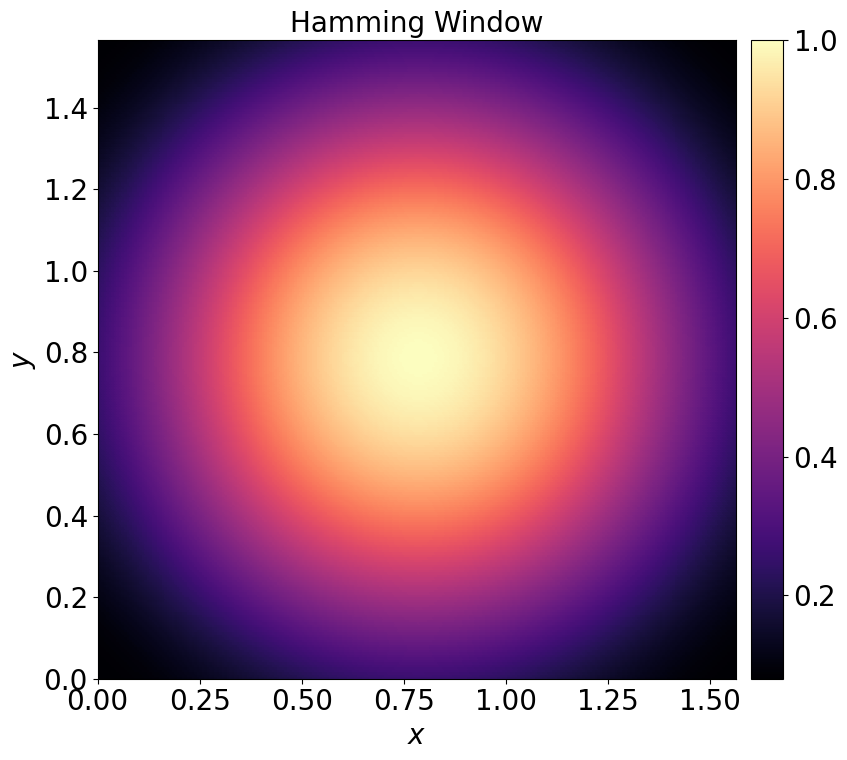

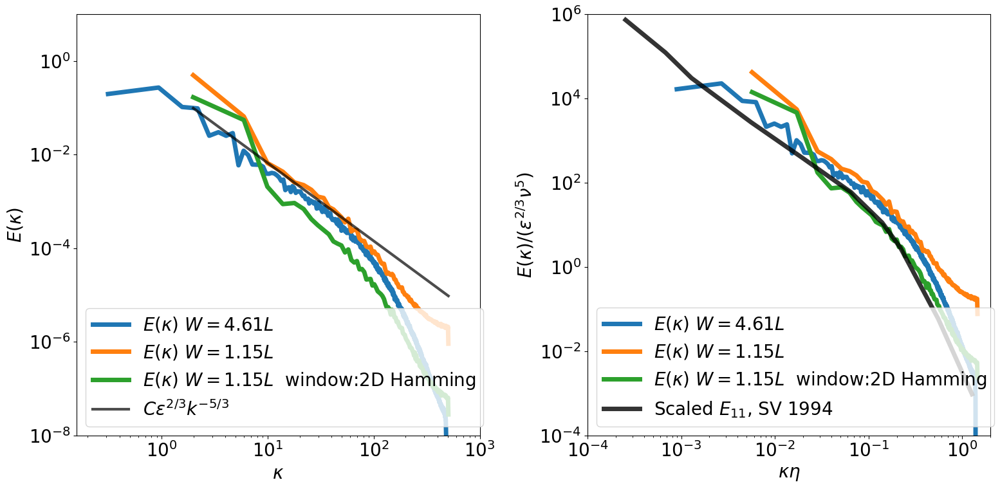

In [211]:
def hamming_func(x):
    w = np.nanmax(x) - np.nanmin(x)
    return 0.54 - 0.46 * np.cos(2*np.pi * (w-x)/w)
def hamming_func_radial(r, rmax=None, duration=None):
    if rmax is None:
        rmax = np.nanmax(r)
        print(rmax)
    x = r + rmax
    window = 0.54 - 0.46 * np.cos(2*np.pi * (2*rmax-x)/rmax/2.)
    print(window.shape)
    window[r > rmax] = 0
    if duration is not None:
        windows = np.repeat(window[..., np.newaxis], duration, axis=2)
        return windows
    else:
        return window


ek_2d_256, ks = vel.get_energy_spectrum_nd(udata_test, dx=dx, dy=dx, x0=x0, x1=x0+256, y0=y0, y1=y0+256)
fig1, ax11, cc11 = graph.color_plot(ks[0, ...], ks[1,...], ek_2d_256[..., 0], log10=True, fignum=1, subplot=121)


x0, x1, y0, y1 = 0, 256, 0, 256
xx, yy = vel.get_equally_spaced_grid(udata2d, spacing=dx)
origin = ( (xx[0, x1] - xx[0, x0]) / 2.,  (yy[y1, 0] - yy[y0, 0])/2. ) 
xx_256, yy_256 = xx[y0:y1, x0:x1], yy[y0:y1, x0:x1]
ux_256 = ux[y0:y1, x0:x1, 0, :]
uy_256 = uy[y0:y1, x0:x1, 0, :]

rr = np.sqrt( (xx_256 - origin[0]) ** 2 + (yy_256 - origin[1]) ** 2)
windows = hamming_func_radial(rr, duration=ux_256.shape[2])
fig2, ax2, cc2 = graph.color_plot(xx_256, yy_256, windows[..., 0], fignum=2)

ux_256_tapered = ux_256 * windows
uy_256_tapered = uy_256 * windows
udata_256_tapered = np.stack((ux_256_tapered, uy_256_tapered))

ek_2d_256_t, ks_t = vel.get_energy_spectrum_nd(udata_256_tapered, dx=dx, dy=dx)
fig1, ax12, cc12 = graph.color_plot(ks_t[0, ...], ks_t[1,...], ek_2d_256_t[..., 0], log10=True, fignum=1, subplot=122, figsize=(16, 8))


ek_256, ek_err_256, k_256 = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+256, y0=y0, y1=y0+256, nkout=128)
ek_256_t, ek_err_256_t, k_256_t = vel.get_energy_spectrum(udata_256_tapered, dx=dx, dy=dx, nkout=128)
ek_256_s, k_256_s = vel.scale_energy_spectrum(ek_256, k_256, epsilon=epsilon, nu=nu)
ek_256_t_s, k_256_t_s = vel.scale_energy_spectrum(ek_256_t, k_256_t, epsilon=epsilon, nu=nu)
fig3, ax3 = graph.plot(kr[:, 0], ek[:, 0], fignum=3, label='$E(\kappa)$ $W = %.2f L$' % (2*np.pi / L * 1024. / 1024.), subplot=121)
fig3, ax3 = graph.plot(k_256[:, 0], ek_256[:, 0], fignum=3, label='$E(\kappa)$ $W = %.2f L$' % (2*np.pi / L * 256. / 1024.), subplot=121)
fig3, ax3 = graph.plot(k_256_t[:, 0], ek_256_t[:, 0], fignum=3, subplot=121,
                       label='$E(\kappa)$ $W = %.2f L$  window:2D Hamming'  % (2*np.pi / L * 256. / 1024.))
fig3, ax3 = graph.plot(k_256_t[:, 0], vel.kolmogorov_53_uni(k_256_t[:, 0], epsilon=epsilon, c=1.5), linewidth=3,
           color='k', alpha=0.7, label='$C \epsilon^{2/3} k^{-5/3}$', fignum=3, subplot=121)
fig3, ax32 = graph.plot(kr_s[:, 0], ek_s[:, 0], fignum=3, subplot=122, label='$E(\kappa)$ $W = %.2f L$' % (2*np.pi / L * 1024. / 1024.))
fig3, ax32 = graph.plot( k_256_s[:, 0], ek_256_s[:, 0], fignum=3, subplot=122,
                       label='$E(\kappa)$ $W = %.2f L$'  % (2*np.pi / L * 256. / 1024.))
fig3, ax32 = graph.plot( k_256_t_s[:, 0], ek_256_t_s[:, 0], fignum=3, subplot=122,
                       label='$E(\kappa)$ $W = %.2f L$  window:2D Hamming'  % (2*np.pi / L * 256. / 1024.))
fig3, ax32 = graph.plot_saddoughi(fignum=3, subplot=122, color='k', label='Scaled $E_{11}$, SV 1994', alpha=0.8)

graph.tologlog(ax3)
graph.tologlog(ax32)
graph.setaxes(ax3, 10**-0.8, 10**3, 10**-8, 10**1)
graph.setaxes(ax32, 10**-4, 2, 10**-4, 10**6)
ax3.legend(loc=3)
ax32.legend(loc=3)

graph.add_colorbar(cc11, ax=ax11, label='$\log_{10}{E(\\vec{\kappa})}$')
graph.add_colorbar(cc12, ax=ax12, label='$\log_{10}{E(\\vec{\kappa})}$')

graph.labelaxes(ax11, '$\kappa_x$', '$\kappa_y$')
graph.labelaxes(ax12, '$\kappa_x$', '$\kappa_y$')
graph.labelaxes(ax2, '$x$', '$y$')
graph.labelaxes(ax3, '$\kappa$', '$E(\kappa)$')
graph.labelaxes(ax32, '$\kappa \eta$', '$E(\kappa) / (\epsilon^{2/3} \\nu^5)$')
graph.title(ax11, '$256 \\times 256$ px$^2$')
graph.title(ax12, '$256 \\times 256$ px$^2$ (tapered)')
graph.title(ax2, 'Hamming Window')

fig1.tight_layout()
fig2.tight_layout()
fig3.tight_layout()

# graph.save('./energy_spec_2d_hamming_window', fignum=1, ext='png')
# graph.save('./hamming_window', fignum=2, ext='png')
# graph.save('./energy_spec_1d_hamming_window', fignum=3, ext='png')

Using tqdm_notebook. If this is a mistake, set notebook=False
0.7057257132545828 0.9980468750000002 1.4142135623730148
0.7057257132545828 0.9980468750000002 1.4142135623730148
Using tqdm_notebook. If this is a mistake, set notebook=False
0.7043446453225174 1.9921874999999996 2.8284271247462707
0.7043446453225174 1.9921874999999996 2.8284271247462707
Using tqdm_notebook. If this is a mistake, set notebook=False
0.7015825094585276 3.96875 5.656854249492381
0.7015825094585276 3.96875 5.656854249492381
Using tqdm_notebook. If this is a mistake, set notebook=False
0.6960582377305077 7.875 11.313708498984761
0.6960582377305077 7.875 11.313708498984761
Using tqdm_notebook. If this is a mistake, set notebook=False
0.6850096942744679 15.5 22.627416997969522
0.6850096942744679 15.5 22.627416997969522


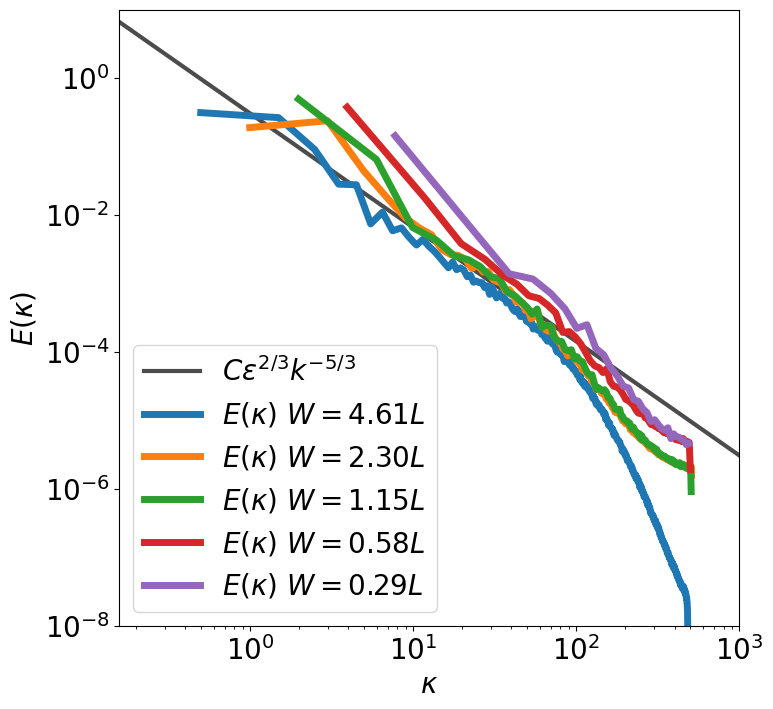

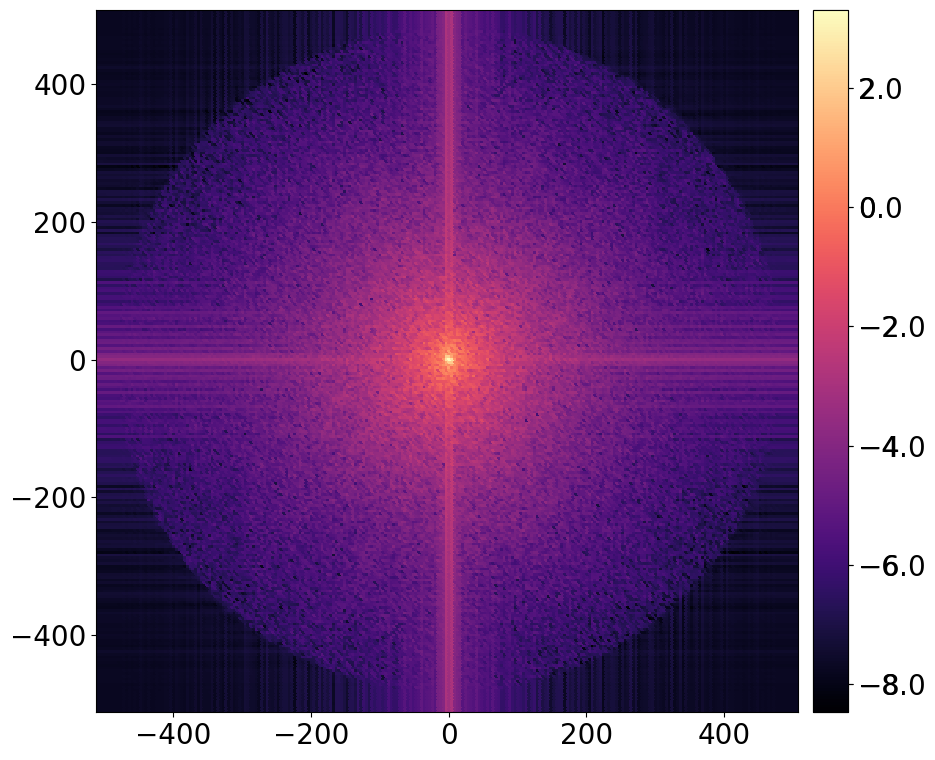

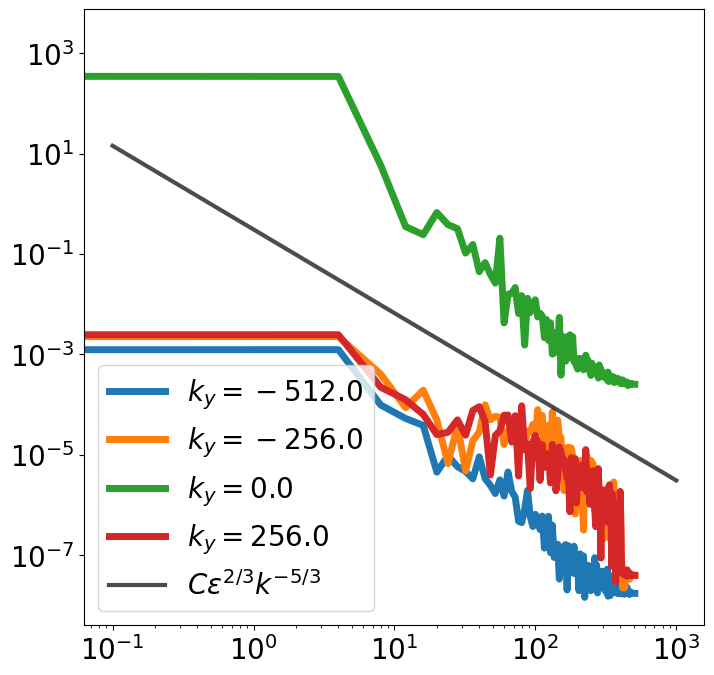

In [213]:
reload(vel)
resolutions = [1024, 512, 256, 128, 64]
x0, y0 = 0, 0
fig2, ax2= graph.plot(np.linspace(10**-1, 10**3, 100), vel.kolmogorov_53_uni(np.linspace(10**-1, 10**3, 100), epsilon=epsilon, c=1.5), linewidth=3,
                      color='k', alpha=0.7, label='$C \epsilon^{2/3} k^{-5/3}$', fignum=2, figsize=(8, 8))
for i, res in enumerate(resolutions):
    if res == 1024:
        window=None
    else:
        window=None
    ek, ek_err, kr = vel.get_energy_spectrum(udata_test, dx=dx, dy=dx, x0=x0, x1=x0+res, y0=y0, y1=y0+res,
                                                         nkout=int(res/2), window=window)
    fig2, ax2 = graph.plot(kr[:, 0], ek[:, 0], fignum=2, label='$E(\kappa)$ $W = %.2f L$' % (2*np.pi / L * res / 1024.))
graph.tologlog(ax2)
# graph.setaxes(ax3, 10**-0.8, 10**3, 10**-8, 10**1)
ax2.legend(loc=3)

res=256
ek2d, ks = vel.get_energy_spectrum_nd(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+res, y0=y0, y1=y0+res, window='hamming')
fig, ax, cc= graph.color_plot(ks[0, ...], ks[1, ...], ek2d[..., 0], log10=True)
graph.add_colorbar(cc, ax=ax)
graph.setaxes(ax2, 10**-0.8, 10**3, 10**-8, 10**1)
graph.labelaxes(ax2, '$\kappa$', '$E(\kappa)$')
# graph.save('./hamming_windows', fignum=3, ext='png')

for i in range(0, ks.shape[2], 64):
    fig3, ax3 = graph.plot(ks[0, i, :], ek2d[i, :, 0], fignum=3, label='$k_y=%.1f$' % ks[1, i, 0])
fig3, ax3 = graph.plot(np.linspace(10**-1, 10**3, 100), vel.kolmogorov_53_uni(np.linspace(10**-1, 10**3, 100), epsilon=epsilon, c=1.5), linewidth=3,
                      color='k', alpha=0.7, label='$C \epsilon^{2/3} k^{-5/3}$', fignum=3, figsize=(8, 8))
ax3.legend()
graph.tologlog(ax3)
# graph.setaxes(ax3, 10**-0.8, 10**3, 10**-8, 10**1)

In [214]:
epsilon, nu

(0.0928, 0.000185)

### Window function comparison

Using tqdm_notebook. If this is a mistake, set notebook=False
0.7057257132545828 0.9980468750000002 1.4142135623730148
0.7057257132545828 0.9980468750000002 1.4142135623730148
Using tqdm_notebook. If this is a mistake, set notebook=False
0.6850096942744679 15.5 22.627416997969522
0.6850096942744679 15.5 22.627416997969522
Using tqdm_notebook. If this is a mistake, set notebook=False
0.6850096942744679 15.5 22.627416997969522
0.6850096942744679 15.5 22.627416997969522
Using tqdm_notebook. If this is a mistake, set notebook=False
0.6850096942744679 15.5 22.627416997969522
0.6850096942744679 15.5 22.627416997969522
Using tqdm_notebook. If this is a mistake, set notebook=False
0.6850096942744679 15.5 22.627416997969522
0.6850096942744679 15.5 22.627416997969522
Using tqdm_notebook. If this is a mistake, set notebook=False
0.6850096942744679 15.5 22.627416997969522
0.6850096942744679 15.5 22.627416997969522


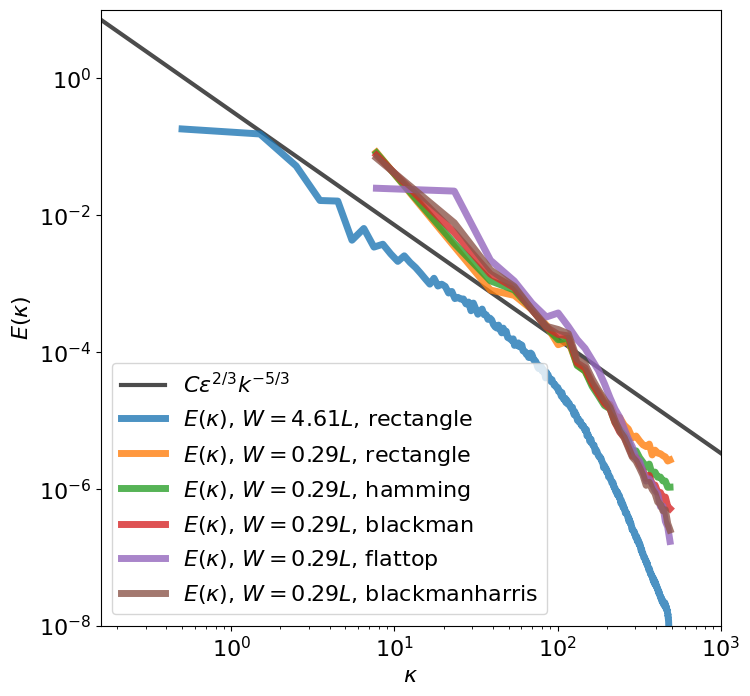

In [227]:
reload(vel)
epsilon=0.103
L = 1.364 #int scale
resolutions = [1024, 64]
x0, y0 = 0, 0
fig2, ax2= graph.plot(np.linspace(10**-1, 10**3, 100), vel.kolmogorov_53_uni(np.linspace(10**-1, 10**3, 100), epsilon=epsilon, c=1.5), linewidth=3,
                      color='k', alpha=0.7, label='$C \epsilon^{2/3} k^{-5/3}$', fignum=2, figsize=(8, 8))
for i, res in enumerate(resolutions):
    if res == 1024:
        windows=[None]
    else:
        windows=[None, 'hamming', 'blackman', 'flattop', 'blackmanharris']
    for window in windows:
        if window is None:
            windowlabel = 'rectangle'
        else:
            windowlabel = window
        ek, ek_err, kr = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, 
                                                 x0=x0, x1=x0+res, 
                                                 y0=y0, y1=y0+res,
                                                 nkout=int(res/2), window=window)
        fig2, ax2 = graph.plot(kr[:, 0], ek[:, 0], fignum=2, label='$E(\kappa)$, $W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), alpha=0.8)
#         break
#     break
graph.tologlog(ax2)
graph.setaxes(ax2, 10**-0.8, 10**3, 10**-8, 10**1)
ax2.legend(loc=3)
graph.labelaxes(ax2, '$\kappa$', '$E(\kappa)$')
# graph.save('e_spec_varying_windows_%03dpx' % resolutions[1])

In [182]:
import library.tools.rw_data as rw
rw.write_pickle('./jhtd_kr.pkl', kr)
rw.write_pickle('./jhtd_ek.pkl', ek)

Saved data under ./jhtd_kr.pkl
Saved data under ./jhtd_ek.pkl


## Cropping effect on E(k)

0.9999999999999432 0.9999999999999432 0.006135923151542565
Using tqdm_notebook. If this is a mistake, set notebook=False
0.4411862822788113 0.6239316239316242 1.4142135623730148
0.4411862822788113 0.6239316239316242 1.4142135623730148
1.0
0.9999999999999432 0.9999999999999432 0.006135923151542565
Using tqdm_notebook. If this is a mistake, set notebook=False
0.4411862822788113 0.6239316239316242 1.4142135623730148
0.4411862822788113 0.6239316239316242 1.4142135623730148
0.6909851534390948
2.000000000000057 2.000000000000057 0.006135923151542565
Using tqdm_notebook. If this is a mistake, set notebook=False
0.44086119609428964 1.2469437652811735 2.8284271247462707
0.44086119609428964 1.2469437652811735 2.8284271247462707
0.6904947360746356
4.0 4.0 0.006135923151542565
Using tqdm_notebook. If this is a mistake, set notebook=False
0.4402086333857428 2.4901960784313726 5.656854249492381
0.4402086333857428 2.4901960784313726 5.656854249492381
0.6895119874523394
8.0 8.0 0.006135923151542565
Us

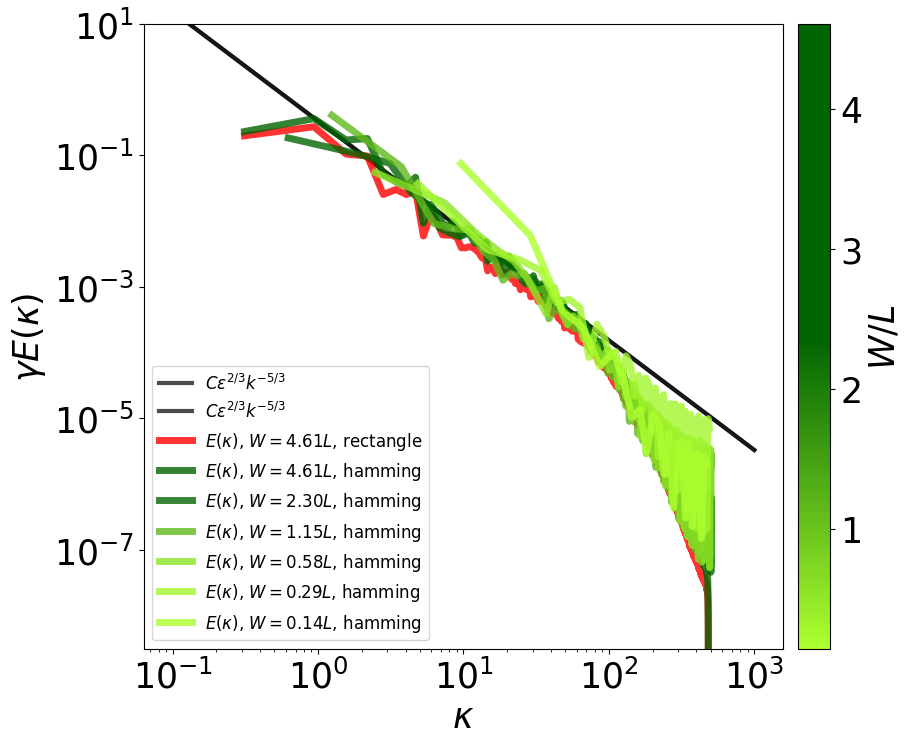

In [228]:
importlib.reload(vel)
from matplotlib import cm
import importlib
__fontsize__ = 25
__figsize__ = (8, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':12, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)

energy_spatial_avg = vel.get_spatial_avg_energy(udata2d)[0]
xx, yy = vel.get_equally_spaced_grid(udata2d, spacing=dx)


epsilon=0.103
L = 1.364 #int scale
resolutions = np.asarray([1024, 512, 256, 128, 64, 32])
colors, cmap, norm = graph.get_colors_and_cmap_using_values(2*np.pi / L * resolutions / 1024.)
x0, y0 = 0, 0


fig2, ax2= graph.plot(np.linspace(10**-1, 10**3, 100), vel.kolmogorov_53_uni(np.linspace(10**-1, 10**3, 100), epsilon=epsilon, c=1.5), linewidth=3,
                      color='k', alpha=0.7, label='$C \epsilon^{2/3} k^{-5/3}$', fignum=2, figsize=(8, 8))
fig2, ax2= graph.plot(np.linspace(10**-1, 10**3, 100), vel.kolmogorov_53_uni(np.linspace(10**-1, 10**3, 100), epsilon=epsilon, c=1.5), linewidth=3,
                      color='k', alpha=0.7, label='$C \epsilon^{2/3} k^{-5/3}$', fignum=2, figsize=(8, 8))

for i, res in enumerate(resolutions):
    x0, y0 = int(np.random.rand(1)*(1024-res)), int(np.random.rand(1)*(1024-res))
    if res == 1024:
        windows=[None, 'hamming']
        pass
    else:
        windows=['hamming']
    for window in windows:
        if window is None:
            windowlabel = 'rectangle'
            color = cmap(norm(2*np.pi / L * res / 1024.))
            if res == 1024:
                color= 'r'
        else:
            windowlabel = window
            color = cmap(norm(2*np.pi / L * res / 1024.))
        energy = vel.get_energy(udata2d[:, y0:y0+res, x0:x0+res, :])
        ek2d, ks = vel.get_energy_spectrum_nd(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+res, y0=y0, y1=y0+res, window=window)
        deltakx, deltaky = ks[0, 0, 1] - ks[0, 0, 0], ks[1, 1, 0] - ks[1, 0, 0]
        print(deltakx, deltaky, dx)
#         print 'Parseval theorem (Total energy in the window): ',  np.sum(energy[..., 0]), np.sum(ek2d[..., 0])
        ek, ek_err, kr = vel.get_energy_spectrum(udata_test, dx=dx, dy=dx, x0=x0, x1=x0+res, y0=y0, y1=y0+res,
                                                             nkout=None, window=window)
        
        if windowlabel != 'rectangle':
            xx, yy = vel.get_equally_spaced_grid(udata2d[:, y0:y0+res, x0:x0+res, :], spacing=dx)
            window = vel.get_window_radial(xx, yy, wtype=window)
            singal_intensity_loss = np.nanmean(window)
        else:
            singal_intensity_loss = 1.
        
#         print 'Total Energy in the window: ', np.sum(energy[..., 0]) * dx * dx, ' mm^2/s^2'
#         print 'Total Energy in 2d spectra: ', np.sum(ek2d[..., 0]) * dx * dx, ' mm^2/s^2'
#         print 'Avg Energy in 1d spectra: ', np.trapz(ek[:, 0], kr[:, 0]), ' mm^2/s^2'
#         print 'Avg energy', vel.get_spatial_avg_energy(udata2d[:, y0:y0+res, x0:x0+res, :])[0]
#         print 'Total Energy in the window according to 1d spectrum', np.trapz(ek[:, 0], kr[:, 0]) * (2*np.pi * res / 1024.)**2
        deltak = kr[1, 0] - kr[0, 0]
        w_in_l = 2*np.pi / L * res / 1024.
        fig2, ax2 = graph.plot(kr[:, 0], ek[:, 0] / singal_intensity_loss, fignum=2, label='$E(\kappa)$, $W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), alpha=0.8,
                              color=color, figsize=(10, 8))
#         fig2, ax2 = graph.plot(kr[:, 0]  / deltak * (1024. / res)** 0.5, ek[:, 0] / sing3al_intensity_loss, fignum=2, label='$E(\kappa)$, $W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), alpha=0.8,
#                               color=color, figsize=(10, 8))

#         print np.trapz(ek[:, 0], kr[:, 0]), energy_spatial_avg[0], deltak

graph.add_colorbar_alone(ax2, [2*np.pi / L * res / 1024. for res in resolutions], cmap=cmap, label='$W/L$')
graph.tologlog(ax2)
ax2.set_ylim(10**-8.5, 10**1)
# graph.setaxes(ax2, 10**-0.8, 10**3, 10**-7.5, 10**1)
ax2.legend(loc=3)
graph.labelaxes(ax2, '$\kappa $', '$\gamma E(\kappa)} / (\Delta \kappa)$')
fig2.tight_layout()
# graph.save('e_spec_%s_bumped' % windowlabel)

0.9999999999999432 0.9999999999999432 0.006135923151542565
Using tqdm_notebook. If this is a mistake, set notebook=False
0.4411862822788113 0.6239316239316242 1.4142135623730148
0.4411862822788113 0.6239316239316242 1.4142135623730148


TypeError: slice indices must be integers or None or have an __index__ method

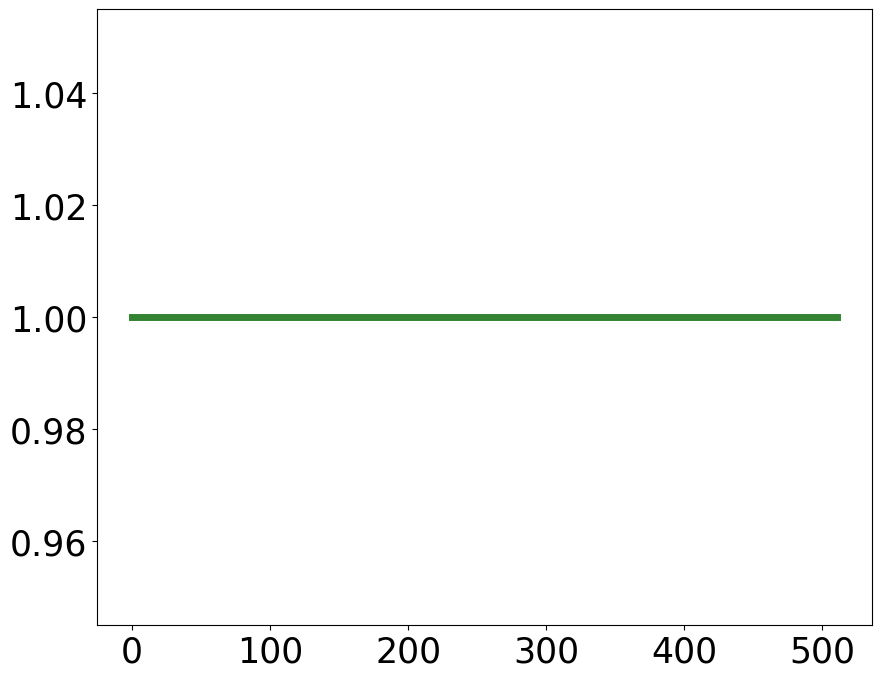

In [232]:
importlib.reload(vel)
from matplotlib import cm
import importlib
alphas = []
betas = []

__fontsize__ = 25
__figsize__ = (8, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':12, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)

energy_spatial_avg = vel.get_spatial_avg_energy(udata2d)[0]
xx, yy = vel.get_equally_spaced_grid(udata2d, spacing=dx)


epsilon=0.103
L = 1.364 #int scale
resolutions = np.asarray([1024, 512, 256, 128, 64])
colors, cmap, norm = graph.get_colors_and_cmap_using_values(2*np.pi / L * resolutions / 1024.)
x0, y0 = 0, 0
# fig2, ax2= graph.plot(np.linspace(10**-1, 10**3, 100), vel.kolmogorov_53_uni(np.linspace(10**-1, 10**3, 100), epsilon=epsilon, c=1.5), linewidth=3,
#                       color='k', alpha=0.7, label='$C \epsilon^{2/3} k^{-5/3}$', fignum=2, figsize=(8, 8))

gammas = []

for i, res in enumerate(resolutions):
    if res == 1024:
        windows=[None]
        pass
    else:
        windows=[None]
    for window in windows:
        if window is None:
            windowlabel = 'rectangle'
            color = cmap(norm(2*np.pi / L * res / 1024.))
#             if res == 1024:
#                 color= 'r'
        else:
            windowlabel = window
            color = cmap(norm(2*np.pi / L * res / 1024.))
        energy = vel.get_energy(udata2d[:, y0:y0+res, x0:x0+res, :])
        ek2d, ks = vel.get_energy_spectrum_nd(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+res, y0=y0, y1=y0+res, window=window)
        deltakx, deltaky = ks[0, 0, 1] - ks[0, 0, 0], ks[1, 1, 0] - ks[1, 0, 0]
        print(deltakx, deltaky, dx)
#         print 'Parseval theorem (Total energy in the window): ',  np.sum(energy[..., 0]), np.sum(ek2d[..., 0])
        ek, ek_err, kr = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, x0=x0, x1=x0+res, y0=y0, y1=y0+res,
                                                             nkout=int(res * 0.8), window=window)
        
        if windowlabel == 'flattop':
            xx, yy = vel.get_equally_spaced_grid(udata2d[:, y0:y0+res, x0:x0+res, :], spacing=dx)
            window = vel.get_window_radial(xx, yy, wtype='flattop')
            singal_intensity_loss = np.nanmean(window)
        else:
            singal_intensity_loss = 1.
        
#         print 'Total Energy in the window: ', np.sum(energy[..., 0]) * dx * dx, ' mm^2/s^2'
#         print 'Total Energy in 2d spectra: ', np.sum(ek2d[..., 0]) * dx * dx, ' mm^2/s^2'
#         print 'Avg Energy in 1d spectra: ', np.trapz(ek[:, 0], kr[:, 0]), ' mm^2/s^2'
#         print 'Avg energy', vel.get_spatial_avg_energy(udata2d[:, y0:y0+res, x0:x0+res, :])[0]
#         print 'Total Energy in the window according to 1d spectrum', np.trapz(ek[:, 0], kr[:, 0]) * (2*np.pi * res / 1024.)**2
        deltak = kr[1, 0] - kr[0, 0]
        w_in_l = 2*np.pi / L * res / 1024.
        fig2, ax2 = graph.plot( (kr[:, 0] ) , ek[:, 0] / singal_intensity_loss / (epsilon**(2./3.)*kr[:, 0]**(-5./3.)) / ek_clean_func(kr[:, 0]), fignum=2, label='$E(\kappa)$, $W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), alpha=0.8,
                              color=color, figsize=(10, 8))
#         fig2, ax2 = graph.plot(kr[:, 0]  / deltak * (1024. / res)** 0.5, ek[:, 0] / sing3al_intensity_loss, fignum=2, label='$E(\kappa)$, $W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), alpha=0.8,
#                               color=color, figsize=(10, 8))

#         print np.trapz(ek[:, 0], kr[:, 0]), energy_spatial_avg[0], deltak


        a = ek[:, 0] / singal_intensity_loss / (epsilon**(2./3.)*kr[:, 0]**(-5./3.)) / ek_clean_func(kr[:, 0])
        alphas.append(np.nanmean(a[res/8:res/8*4]))
        betas.append(w_in_l)
        
        value = ek[:, 0] / singal_intensity_loss / (epsilon**(2./3.)*kr[:, 0]**(-5./3.))/ ek_clean_func(kr[:, 0])
        gammas.append(np.nanmean(value[:1]))

        
graph.add_colorbar_alone(ax2, [2*np.pi / L * res / 1024. for res in resolutions], cmap=cmap, label='$W/L$')
graph.tologlog(ax2)
ax2.set_ylim(10** -0.5, 10**6)
# graph.setaxes(ax2, 10**-8.1, 10**-1.2, 10**-2, 10**3.5)
ax2.legend(loc=2)
graph.labelaxes(ax2, '$\kappa $', '$\gamma E(\kappa) / (\epsilon^{2/3} \kappa^{5/3}) $')
# a = np.linspace(1, 10*3, 100)
# graph.plot(a, 1000*a**-1,fignum=2)
fig2.tight_layout()
# graph.save('e_spec_rectangle_1p66')

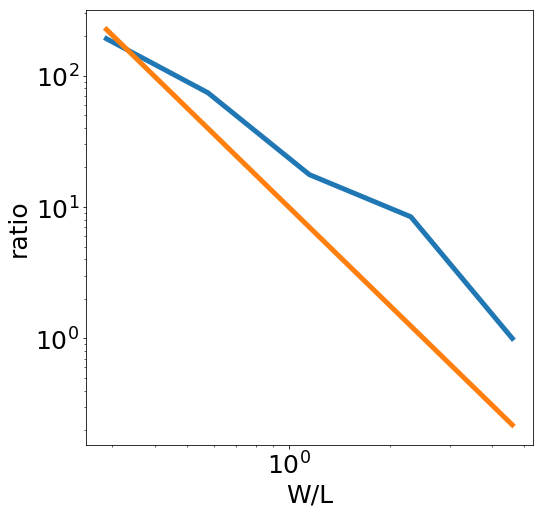

In [178]:
alphas = np.asarray(alphas)
betas = np.asarray(betas)
fig, ax =graph.plot(betas, alphas)
graph.plot(betas, 10 * betas**(-5./2.))
# graph.plot(betas,  200 * betas**-3)
graph.tologlog(ax)
graph.labelaxes(ax, 'W/L', 'ratio')


In [231]:
kk, ekk = kr[:, 0] , ek[:, 0] / singal_intensity_loss / (epsilon**(2./3.)*kr[:, 0]**(-5./3.))
ek_clean_func = interp1d(kk, ekk)

(<matplotlib.figure.Figure at 0x13d7a8150>,
 <matplotlib.axes._subplots.AxesSubplot at 0x11fe4a050>)

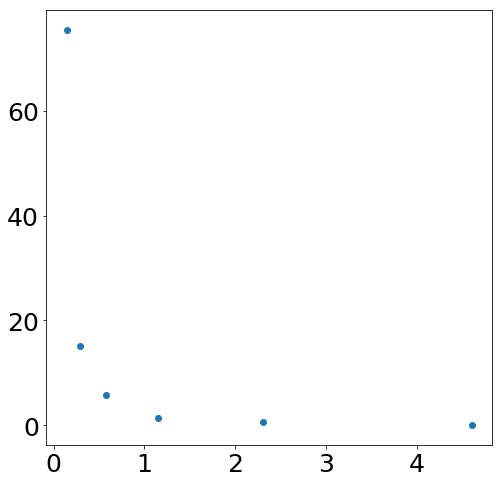

In [1453]:
betas = np.asarray(betas)
alphas = np.asarray(alphas)
graph.scatter(betas, alphas)

 Saving figure to '/Users/stephane/Dropbox/turbulence/turbulence/keynote_slides/aro2019/outputs/flattop.png'... ... Done
5.299398530803322


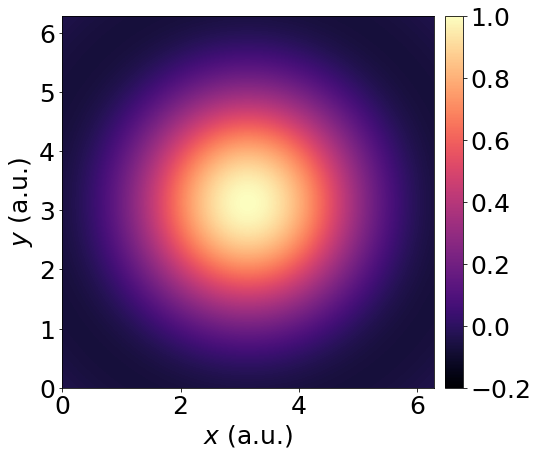

In [21]:
__fontsize__ = 25
__figsize__ = (8, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':14, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)


xx, yy = vel.get_equally_spaced_grid(udata2d, spacing=dx)
window = vel.get_window_radial(xx, yy, wtype='flattop')
# window = np.ones_like(xx)
singal_intensity_loss = np.nanmean(window)
fig, ax, cc = graph.color_plot(xx, yy, window, vmin=-0.2, vmax=1, cbar=True)
graph.labelaxes(ax, '$x$ (a.u.)', '$y$ (a.u.)')
singal_intensity_loss = np.nanmean(window)
fig.tight_layout()
graph.save(savedir + 'flattop', ext='png')

print 1./singal_intensity_loss

In [70]:
singal_intensity_loss, nu, epsilon

(1.0, 0.000185, 0.103)

## Cropping effent on E11

Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False


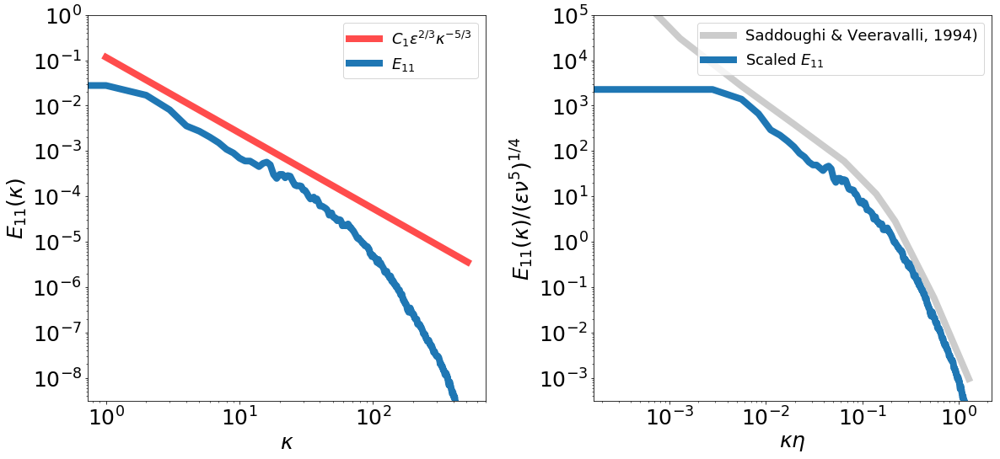

In [38]:
reload(vel)
__fontsize__ = 25
__figsize__ = (17, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':18, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 8}
graph.update_figure_params(params)

epsilon=0.103

# SV 1994 curve
e11_sv, k11_sv = vel.get_rescaled_energy_spectrum_saddoughi()

# get E11 and E22
(e11, e22), (e11_err, e22_err), k11 = vel.get_1d_energy_spectrum(udata_test, dx=dx, dy=dy, window='flattop', correct_signal_loss=True)
eii_arr_s, eii_err_s, k11_s = vel.get_1d_rescaled_energy_spectrum(udata_test, dx=dx, dy=dy, epsilon=epsilon, nu=nu, window='flattop', correct_signal_loss=True)
e11_s, e22_s = eii_arr_s

# get E(k)
ek, ek_err, kr = vel.get_energy_spectrum(udata2d, dx=dx, dy=dy)
ek_s, ek_err_s, kr_s = vel.get_rescaled_energy_spectrum(udata2d, dx=dx, dy=dy, epsilon=epsilon, nu=nu)
# plot
fig1, ax11 = graph.plot(k11, vel.kolmogorov_53_uni(k11, epsilon, c=0.53), subplot=121,
                        label='$C_1\epsilon^{2/3}\kappa^{-5/3}$', color='r', alpha=0.7)
fig1, ax11 = graph.plot(k11, e11[:, 0], subplot=121, label='$E_{11}$')
# fig1, ax11 = graph.plot(k11, e22[:, 0], subplot=121, label='$E_{22}$')
# fig1, ax11 = graph.plot(kr[:, 0], ek[:, 0], subplot=121, label='$E$')

fig1, ax12 = graph.plot(k11_sv, e11_sv, subplot=122, color='k', label='Saddoughi & Veeravalli, 1994)', alpha=0.2)
fig1, ax12 = graph.plot(k11_s[:, 0], e11_s[:, 0], subplot=122, label='Scaled $E_{11}$')
graph.tologlog(ax11)
graph.tologlog(ax12)

graph.labelaxes(ax11, '$\kappa $', '$E_{11}(\kappa)$')
graph.labelaxes(ax12, '$\kappa \eta $', '$E_{11}(\kappa) / ( \epsilon\\nu^5)^{1/4}$')

ax11.legend(loc=1)
ax12.legend(loc=1)

ax11.set_ylim(10**-8.5, 10 **0)
ax12.set_ylim(10**-3.5, 10 **5)

fig1.tight_layout()

import library.tools.rw_data as rw
jhtd_e_specs = {}
jhtd_e_specs['e11'] = e11[:, 0][e11[:, 0] > 10**-8]
jhtd_e_specs['e22'] = e22[:, 0][e22[:, 0] > 10**-8]
jhtd_e_specs['ek'] = ek[:, 0][ek[:, 0] > 10**-8]
jhtd_e_specs['k11'] = k11[e11[:, 0] > 10**-8]
jhtd_e_specs['k22'] = k11[e22[:, 0] > 10**-8]
jhtd_e_specs['kr'] = kr[:, 0][ek[:, 0] > 10**-8]

jhtd_e_specs['e11_s'] = e11_s[:, 0][e11_s[:, 0] > 10**-3.5]
jhtd_e_specs['e22_s'] = e22_s[:, 0][e22_s[:, 0] > 10**-3.5]
jhtd_e_specs['ek_s'] = ek_s[:, 0][ek_s[:, 0] > 10**-3.5]
jhtd_e_specs['k11_s'] = k11_s[e11_s[:, 0] > 10**-3.5]
jhtd_e_specs['k22_s'] = k11_s[e22_s[:, 0] > 10**-3.5]
jhtd_e_specs['kr_s'] = kr_s[:, 0][ek_s[:, 0] > 10**-3.5]

jhtd_e_specs['k11_sv'] = k11_sv
jhtd_e_specs['e11_sv'] = e11_sv



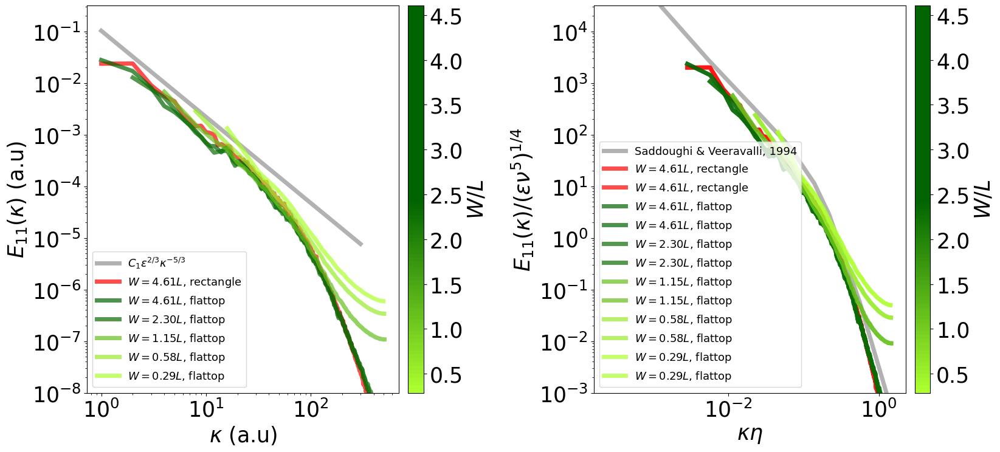

In [233]:
reload(vel)
from scipy.interpolate import interp1d
from tqdm import tqdm_notebook as tqdm
# PLOTTING
__fontsize__ = 25
__figsize__ = (17, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':13, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)


# Basic quantities
epsilon=0.0928
# epsilon=0.039
L = 1.364 #int scale

window = None
resolutions = np.asarray([1024, 512, 256, 128, 64])
colors, cmap, norm = graph.get_colors_and_cmap_using_values(2*np.pi / L * resolutions / 1024.)
x0, y0 = 0, 0

# SV 1994 curve
e11_sv, k11_sv = vel.get_rescaled_energy_spectrum_saddoughi()
fig1, ax12 = graph.plot(k11_sv, e11_sv, subplot=122, color='k', label='Saddoughi & Veeravalli, 1994',alpha=0.3)

# kolmogorov spectrum
kref = np.linspace(1, 300, 100)
fig1, ax11 = graph.plot(kref, vel.kolmogorov_53_uni(kref, epsilon, c=0.5), subplot=121,
                        label='$C_1\epsilon^{2/3}\kappa^{-5/3}$', color='k', alpha=0.3)
xis = []
zetas = []
for i, res in enumerate(resolutions):
    if res == 1024:
            windows=[None, 'flattop']
            pass
    else:
        windows=['flattop']
        

    for window in windows:
        if window is None:
            windowlabel = 'rectangle'
            color = cmap(norm(2*np.pi / L * res / 1024.))
            if res == 1024:
                color= 'r'
        else:
            windowlabel = window
            color = cmap(norm(2*np.pi / L * res / 1024.))
        w_in_l = 2*np.pi / L * res / 1024.

        ms = [1, 4, 16, 64, 64]
        e11_list, e11s_list = [], []
        k11_list, k11s_list = [], []

        for m in tqdm(range(ms[i])):
            x0, y0 = int(np.random.rand(1) * (1024 - res)), int(np.random.rand(1) * (1024 - res))
#             x0, y0 = 0, 0
            x1, y1 = x0 + res, y0 + res

            # get E11 and E22
            (e11, e22), (e11_err, e22_err), k11 = vel.get_1d_energy_spectrum(udata_test, dx=dx, dy=dy, x0=x0, x1=x1, y0=y0, y1=y1, window=window, correct_signal_loss=True)
            eii_arr_s, eii_err_s, k11_s = vel.get_1d_rescaled_energy_spectrum(udata_test, dx=dx, dy=dy, epsilon=epsilon, nu=nu, x0=x0, x1=x1, y0=y0, y1=y1,
                                                                              window=window, correct_signal_loss=True)
            e11_s, e22_s = eii_arr_s
    #         fig1, ax11 = graph.plot(k11[1:], e11[1:, 0] * (res/1024.), subplot=121, label='$W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), color=color, alpha=0.7)

    #         fig1, ax12 = graph.plot(k11_s[1:] , e11_s[1:, 0] * (res/1024.), subplot=122, label='$W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), color=color, alpha=0.7)

            e11_list.append(e11)
            e11s_list.append(e11_s)
            k11_list.append(k11)
            k11s_list.append(k11_s)
        e11, e11_err, k11 = np.nanmean(np.asarray(e11_list), axis=0), np.nanstd(np.asarray(e11_list), axis=0), np.nanmean(np.asarray(k11_list), axis=0)
        e11_s, e11_s_err, k11_s = np.nanmean(np.asarray(e11s_list), axis=0), np.nanstd(np.asarray(e11s_list), axis=0), np.nanmean(np.asarray(k11s_list), axis=0)

        deltak = k11[1]-k11[0]
        
        fig1, ax11 = graph.plot(k11[1:], e11[1:, 0], subplot=121, label='$W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), color=color, alpha=0.7)
        fig1, ax12 = graph.plot(k11_s[1:] , e11_s[1:, 0], subplot=122, label='$W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), color=color, alpha=0.7)
#         fig1, ax11, cc1 = graph.errorfill(k11[1:], e11[1:, 0] * (res/1024.), e11_err[1:, 0] * (res/1024.), subplot=121,
#                                      label='$W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), color=color, alpha=0.7)
#         fig1, ax12, cc2 = graph.errorfill(k11_s[1:, 0] , e11_s[1:, 0] * (res/1024.), e11_s_err[1:, 0] * (res/1024.), subplot=122,
#                                      label='$W = %.2f L$, %s' % (2*np.pi / L * res / 1024., windowlabel), color=color, alpha=0.7)
#     break


graph.tologlog(ax11)
graph.tologlog(ax12)

graph.labelaxes(ax11, '$\kappa$ (a.u)', '$  E_{11}(\kappa)$ (a.u)')
graph.labelaxes(ax12, '$\kappa \eta$', '$  E_{11}(\kappa) / ( \epsilon\\nu^5)^{1/4}$')

ax11.legend(loc=3)
ax12.legend(loc=3)

ax11.set_ylim(10**-8, 10 **-0.5)
ax12.set_ylim(10**-3, 10 **4.5)
ax11.set_xlim((0.7321144099338632, 697.9783392682594))
ax12.set_xlim((0.00016494931734484356, 2.2645769988345785))

graph.add_colorbar_alone(ax11, [2*np.pi / L * res / 1024. for res in resolutions], cmap=cmap, label='$W/L$')
graph.add_colorbar_alone(ax12, [2*np.pi / L * res / 1024. for res in resolutions], cmap=cmap, label='$W/L$')

fig1.tight_layout()

savedir = '/Users/stephane/Dropbox/turbulence/turbulence/keynote_slides/aro2019/outputs'
# graph.save(savedir + '/e11_cropping_effect_avg_64_realizations_1')

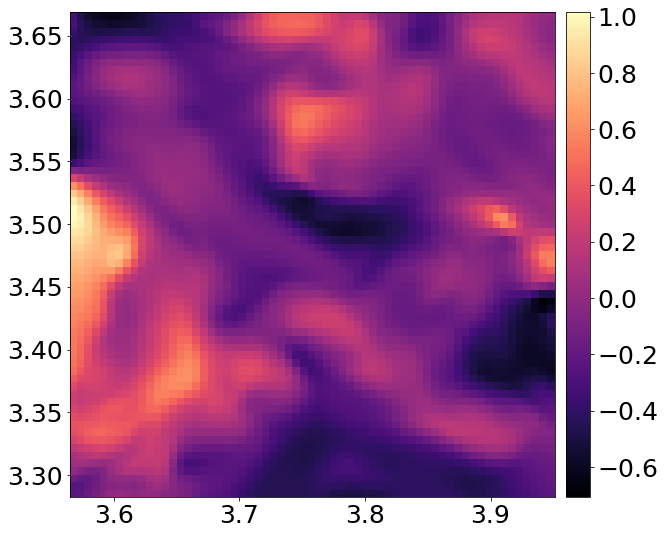

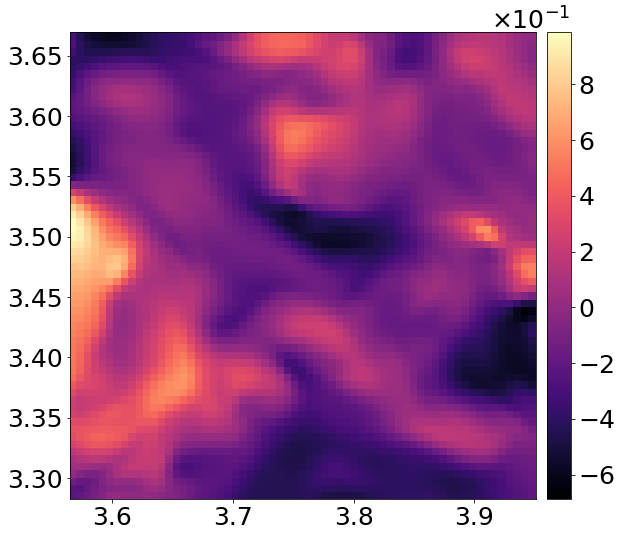

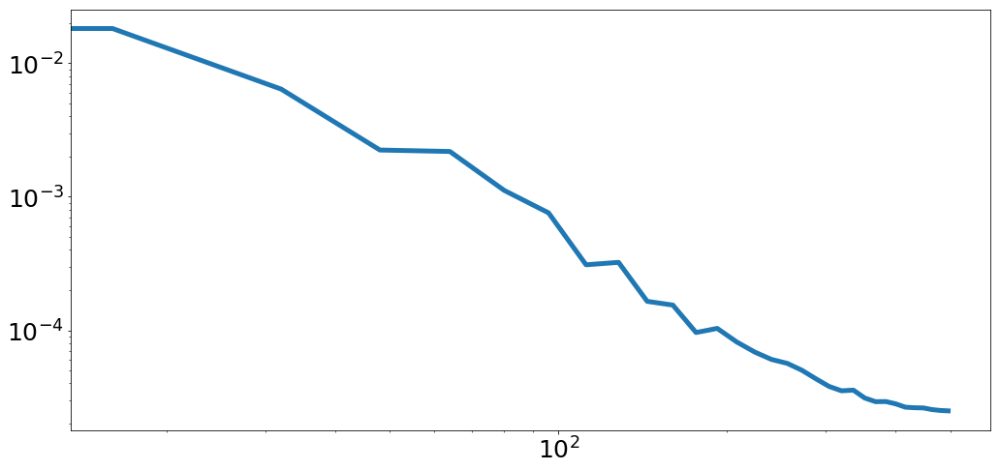

In [139]:
reload(vel)
xx, yy = vel.get_equally_spaced_grid(udata_test, spacing=dx)
graph.color_plot(xx[y0:y1, x0:x1], yy[y0:y1, x0:x1], udata_test[0, y0:y1, x0:x1, 0])

window_arr = vel.get_window_radial(xx, yy, wtype='flattop', x0=x0, x1=x1, y0=y0, y1=y1)
# print window_arr.shape,  window_arr
graph.color_plot(xx[y0:y1, x0:x1], yy[y0:y1, x0:x1], udata2d[0, y0:y1, x0:x1, 0]*window_arr, fignum=2)
(e11, e22), err, kx =vel.get_1d_energy_spectrum(udata2d, dx=dx, dy=dy, x0=x0, x1=x1, y0=y0, y1=y1, window=window, correct_signal_loss=True)
fig, ax = graph.plot(kx, e11[:, 0], fignum=3)
graph.tologlog(ax)

Saving figure to '/Users/stephane/Dropbox/turbulence/turbulence/keynote_slides/aro2019/outputs/jhtd_ux_field_boxes_bwr_1new.png'...
... Done


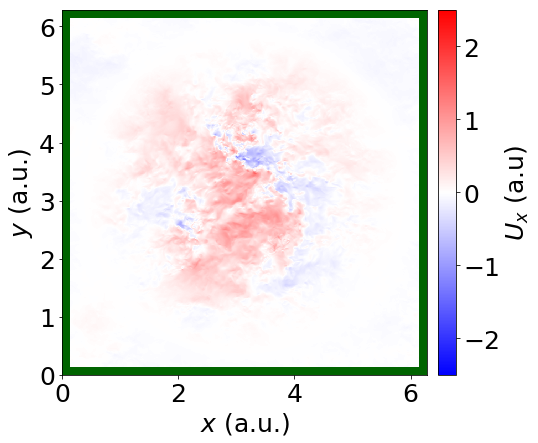

In [7]:
__fontsize__ = 25
__figsize__ = (8, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':14, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)

L = udata[0].shape[0] # system size
resolutions = np.asarray([1024, 512, 256, 128, 64])
colors, cmap, norm = graph.get_colors_and_cmap_using_values(2*np.pi / L * resolutions / 1024.)

window = vel.get_window_radial(xx, yy, wtype='flattop')
xx, yy = vel.get_equally_spaced_grid(udata2d, spacing=dx)
fig, ax, cc = graph.color_plot(xx, yy, udata2d[0, ..., 0]*window, label='$U_x$ (a.u)', cmap='bwr', vmin=-2.5, vmax=2.5)
graph.labelaxes(ax, '$x$ (a.u.)', '$y$ (a.u.)')

for i, res in enumerate(resolutions):
    if res == 1024:
        linewidth = 16
    else:
        linewidth = 8
    graph.draw_rectangle(ax, 0, 0, res*dx, res*dx, linewidth=linewidth, edgecolor=colors[i])
    break
fig.tight_layout()
graph.setaxes(ax, 0, 2*np.pi, 0, 2*np.pi)
savedir = '/Users/stephane/Dropbox/turbulence/turbulence/keynote_slides/aro2019/outputs/'
graph.save(savedir + 'jhtd_ux_field_boxes_bwr_1new', ext='png')

In [221]:
import copy
e11_clean, k11_clean = copy.deepcopy(e11), copy.deepcopy(k11)
e11_clean_func = interp1d(k11_clean, e11_clean[:, 0])

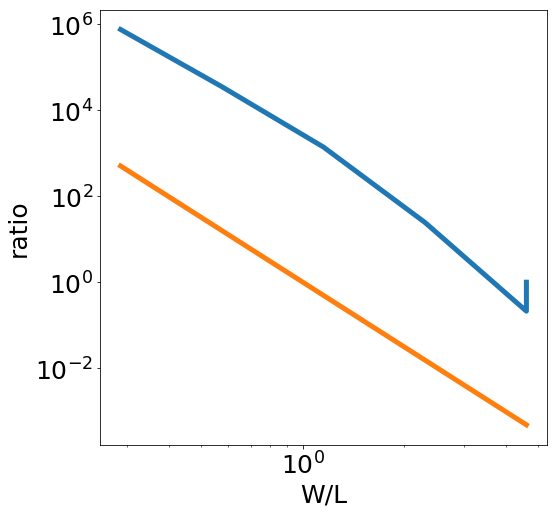

In [217]:
xis, zetas = np.asarray(xis), np.asarray(zetas)

fig, ax = graph.plot(xis, zetas)
fig, ax = graph.plot(xis, xis ** -5, figsize=(8, 8))


graph.tologlog(ax)
graph.labelaxes(ax, 'W/L', 'ratio')

## Wiener-Khinchin theorem and PIV

Fourier-transforming the two-point function was the only method to compute the 1D energy spectrum. The 3D energy spectrum was then calculated with the isotropic formula. <br>
This method was the only option at the time because only point-wise measurement techniques were available. The foundation of this method is so-called Wiener-Khinchin theorem or autocorrelation theorem. Here, I numerically show that the energy spectrum density function (ESD) can be obtained by two ways for a singal f(t).
1. Use f(omega)- Simply compute |f(omega)|^2
2. Fourier transform the autocorrelation function R(tau)= \int f(t)f(t+tau) dt

In [2]:

# Plotting settings
__fontsize__ = 16
__figsize__ = (12, 8)
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize': 16, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
          'lines.linewidth': 5}
# graph.show_plot_styles()
graph.use_plot_style('default')
graph.update_figure_params(params)

Total energy, Ryy(0): 1.5707963267948966 1.5707963267948963
Power, Ryy(0)/T: 0.5 0.49999999999999994


(1.5707963267948966, 1.570788197713669, 1.5707942689952357)

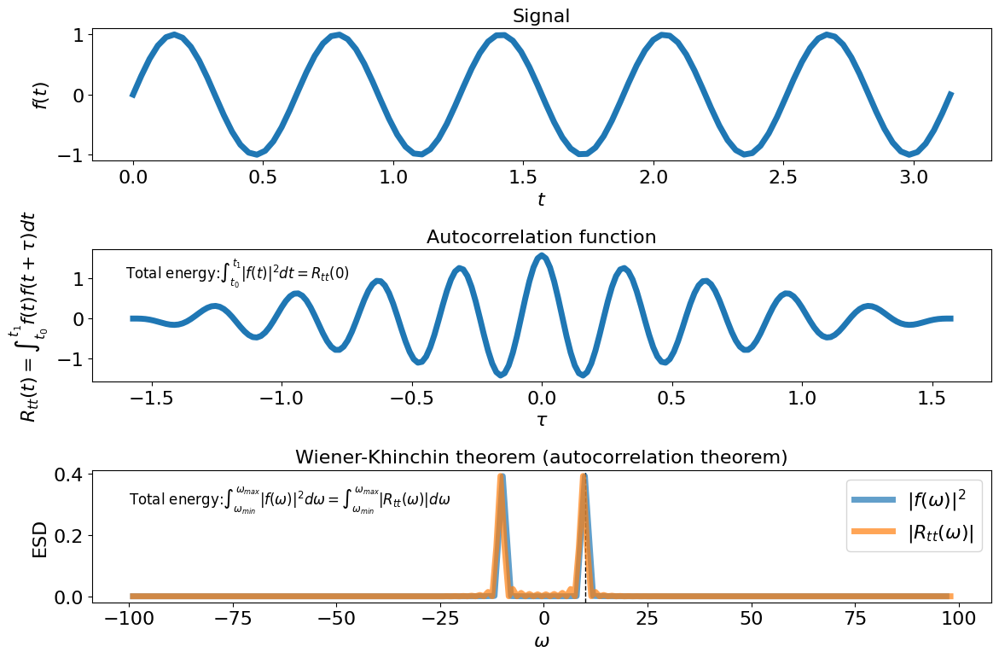

In [3]:
# Wiener-Khinchin theorem on ESD
from scipy import signal
import tflow.velocity as vel
import tflow.graph as graph

t = np.linspace(0, np.pi, 100)
dt = t[1]-t[0]
fs = 1/dt
yt = np.sin(10*t)

yf, f = vel.fourier_transform_1d(yt, fs, t[0], return_freq=True)
esd = np.abs(yf)**2 # Energy spectrum density 

# autoccorelation
# ryy = signal.correlate(yt, yt, mode='full', method='auto') / (len(yt)-1) # <y(t)y(t+tau)>
ryy = signal.correlate(yt, yt, mode='full', method='auto') / (len(yt)-1) * (t[-1]-t[0]) # \int_t0^t1 y(t)y(t+tau) dt
lags = signal.correlation_lags(len(yt), len(yt), mode='full') * dt/2

# basics (Parseval's theorem)
print('Total energy, Ryy(0):', np.trapz(yt**2, t), ryy[len(yt)-1])
print('Power, Ryy(0)/T:', np.trapz(yt**2, t) / (t[-1]-t[0]), ryy[len(yt)-1]/(t[-1]-t[0]))


rffy, fac = vel.fourier_transform_1d(ryy, fs, t[0], return_freq=True,) # FT of autocorrelation function



# plot results
fig, ax1 = graph.plot(t, yt, subplot=311)
fig, ax2 = graph.plot(lags, ryy, subplot=312)
fig, ax3 = graph.plot(f*2*np.pi, esd/(2*np.pi), label='$|f(\omega)|^2$', subplot=313, alpha=0.7)
graph.plot(fac*2*np.pi, np.abs(rffy)/(2*np.pi), label='$|R_{tt}(\omega)|$', subplot=313, alpha=0.7)
# graph.plot(fac*2*np.pi, 2*np.abs(rffy.real)/(2*np.pi))
graph.axvline(ax3, 10)
ax3.legend()

graph.labelaxes(ax1, '$t$', '$f(t)$')
graph.labelaxes(ax2, '$\\tau$', '$R_{tt}(t)=\int_{t_0}^{t_1} f(t)f(t+\\tau) dt$')
graph.labelaxes(ax3, '$\omega$', 'ESD')
graph.title(ax1, 'Signal')
graph.title(ax2, 'Autocorrelation function')
graph.title(ax3, 'Wiener-Khinchin theorem (autocorrelation theorem)')
graph.addtext(ax2, 'Total energy:$\int_{t_0}^{t_1}|f(t)|^2 dt=R_{tt}(0)$', x=-1.6, y=1, fontsize=12)
graph.addtext(ax3, 'Total energy:$\int_{\omega_{min}}^{\omega_{max}}|f(\omega)|^2 d\omega=\int_{\omega_{min}}^{\omega_{max}} |R_{tt}(\omega)| d\omega $', x=-100, y=0.3, fontsize=12)

fig.tight_layout()

etot = np.trapz(yt**2, t)
etot, np.trapz(esd, f), np.trapz(np.abs(rffy), fac)

Comments: <br>
Wiener-Khinchin theorem states that the ESD of a signal is identical to the FT of its autocorrelation function as demonstrated above. <br>

For 1D energy spectrum, the signal is $u_1(x_1)$. The autocorrelation function is $\langle u_1(x_1)u_1(x_1+r\hat{e}_1) \rangle$ NOT $\int_{-L/2}^{L/2} u_1(x_1)u_1(x_1+r\hat{e}_1) dx_1$. This makes the integral of the autocorrelation gives the AVERAGE energy density instead of total energy. 


This equivalence could be difficult to see because the autocorrelation function must converge for this equivalence to hold. <br>


Avg energy density, Ryy(0): 0.5 0.49999999999999994


(0.5, 0.15915411944376343, 0.4999993449820242)

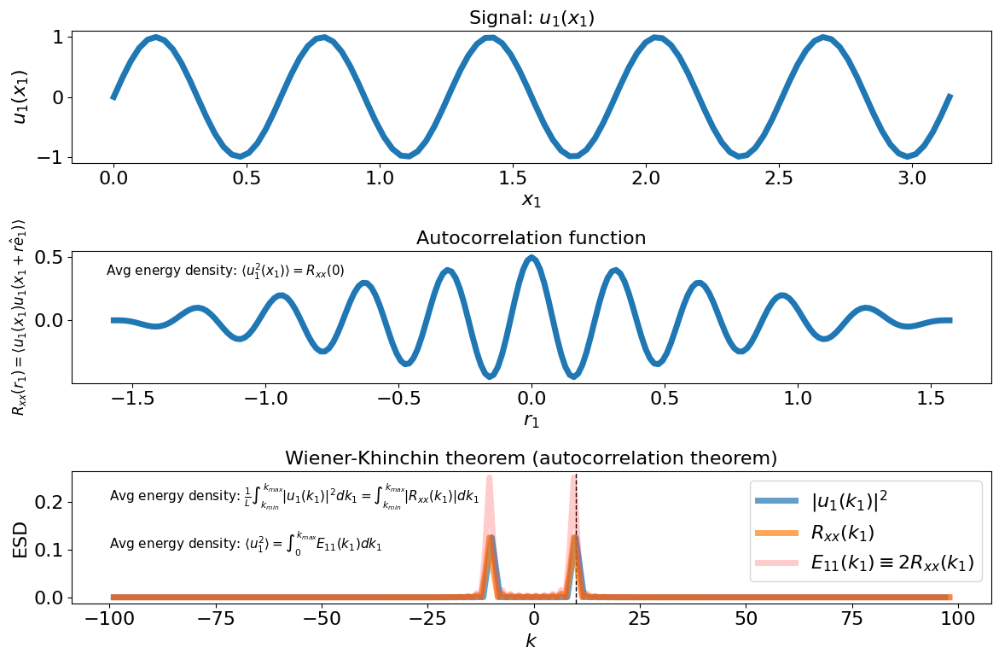

In [4]:
# Wiener-Khinchin theorem on ESD
from scipy import signal

t = np.linspace(0, np.pi, 100)
T = t[-1]-t[0]
dt = t[1]-t[0]
fs = 1/dt
yt = np.sin(10*t)

yf, f = vel.fourier_transform_1d(yt, fs, t[0], return_freq=True)
esd = np.abs(yf)**2 / T # 1D energy soectrum

# autoccorelation
ryy = signal.correlate(yt, yt, mode='full', method='auto') / (len(yt)-1) # <y(t)y(t+tau)>
# ryy = signal.correlate(yt, yt, mode='full', method='auto') / (len(yt)-1) * (t[-1]-t[0]) # \int_t0^t1 y(t)y(t+tau) dt
lags = signal.correlation_lags(len(yt), len(yt), mode='full') * dt/2

# basics (Parseval's theorem)
print('Avg energy density, Ryy(0):', np.trapz(yt**2, t) / T, ryy[len(yt)-1])


rffy, fac = vel.fourier_transform_1d(ryy, fs, t[0], return_freq=True,) # FT of autocorrelation function



# plot results
fig, ax1 = graph.plot(t, yt, subplot=311)
fig, ax2 = graph.plot(lags, ryy, subplot=312)
fig, ax3 = graph.plot(f*2*np.pi, esd/(2*np.pi), label='$|u_1(k_1)|^2$', subplot=313, alpha=0.7)
graph.plot(fac*2*np.pi, np.abs(rffy)/(2*np.pi), label='$R_{xx}(k_1)$', subplot=313, alpha=0.7)
graph.plot(fac*2*np.pi, 2*np.abs(rffy)/(2*np.pi), label='$E_{11}(k_1) \equiv 2 R_{xx}(k_1)$', subplot=313, alpha=0.2, color='r')

graph.axvline(ax3, 10)
ax3.legend()

graph.labelaxes(ax1, '$x_1$', '$u_1(x_1)$')
ax2.set_xlabel('$r_1$')
ax2.set_ylabel('$R_{xx}(r_1)=\langle u_1(x_1)u_1(x_1+r\hat{e}_1) \\rangle$', fontsize=12)
graph.labelaxes(ax3, '$k$', 'ESD')
graph.title(ax1, 'Signal: $u_1(x_1)$')
graph.title(ax2, 'Autocorrelation function')
graph.title(ax3, 'Wiener-Khinchin theorem (autocorrelation theorem)')
graph.addtext(ax2, 'Avg energy density: $\langle u_1^2(x_1) \\rangle =R_{xx}(0)$', x=-1.6, y=0.35, fontsize=11)
graph.addtext(ax3, 'Avg energy density: $\\frac{1}{L} \int_{k_{min}}^{k_{max}}|u_1(k_1)|^2 dk_1=\int_{k_{min}}^{k_{max}} |R_{xx}(k_1)| dk_1 $', 
              x=-100, y=0.2, fontsize=11)
graph.addtext(ax3, 'Avg energy density: $\langle u_1^2 \\rangle = \int_{0}^{k_{max}} E_{11}(k_1) dk_1 $', 
              x=-100, y=0.1, fontsize=11)


fig.tight_layout()

etot = np.trapz(yt**2, t)
etot/T, np.trapz(esd, f)/T, np.trapz(np.abs(rffy), fac)

### Continuous spectrum (JHTD)

Avg energy density, Ryy(0): 0.3906387208109163 0.3910726489008184


(0.3906387208109163, 0.06230198696475149, 0.3910725396281349)

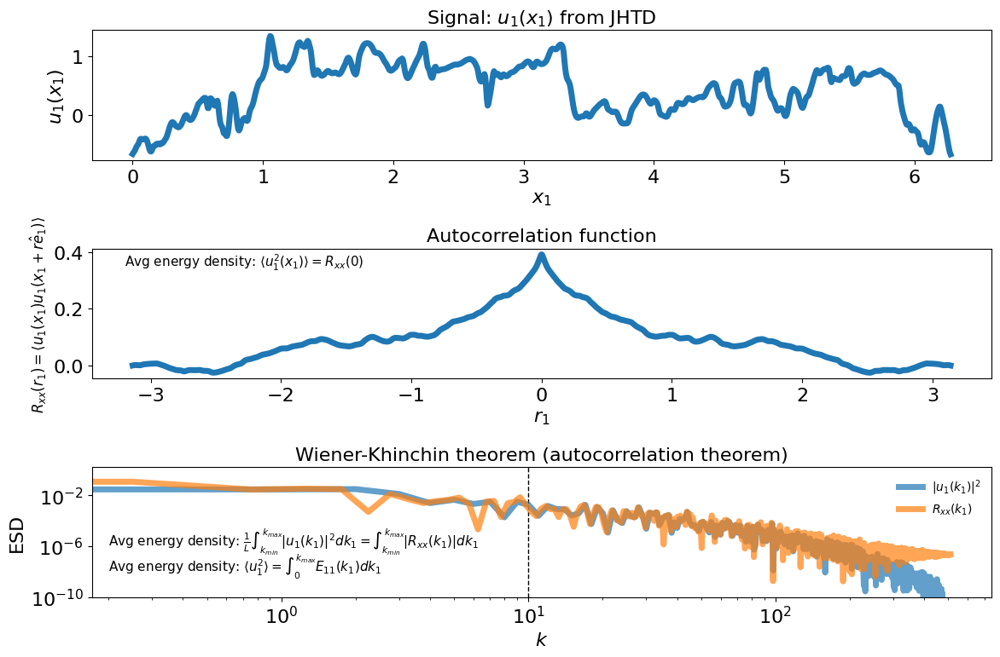

In [8]:
# Turbulence spectrum
udata2, xxx, yyy, zzz = vel.get_sample_turb_field_3d()

y0, z0 = 0, 0
ux, x = udata2[0, y0, : , z0, 0], xxx[0, :, 0]


t = x
T = t[-1]-t[0]
dt = t[1]-t[0]
fs = 1/dt
yt = ux

yf, f = vel.fourier_transform_1d(yt, fs, t[0], return_freq=True)
esd = np.abs(yf)**2 / T # 1D energy soectrum

# autoccorelation
ryy = signal.correlate(yt, yt, mode='full', method='auto') / (len(yt)-1) # <y(t)y(t+tau)>
# ryy = signal.correlate(yt, yt, mode='full', method='auto') / (len(yt)-1) * (t[-1]-t[0]) # \int_t0^t1 y(t)y(t+tau) dt
lags = signal.correlation_lags(len(yt), len(yt), mode='full') * dt/2

# basics (Parseval's theorem)
print('Avg energy density, Ryy(0):', np.trapz(yt**2, t) / T, ryy[len(yt)-1])


rffy, fac = vel.fourier_transform_1d(ryy, fs, t[0], return_freq=True,) # FT of autocorrelation function



# plot results
fig, ax1 = graph.plot(t, yt, subplot=311)
fig, ax2 = graph.plot(lags, ryy, subplot=312)
fig, ax3 = graph.plot(f*2*np.pi, esd/(2*np.pi), label='$|u_1(k_1)|^2$', subplot=313, alpha=0.7)
graph.plot(fac*2*np.pi, np.abs(rffy)/(2*np.pi), label='$R_{xx}(k_1)$', subplot=313, alpha=0.7)
# graph.plot(fac*2*np.pi, 2*np.abs(rffy)/(2*np.pi), label='$E_{11}(k_1) \equiv 2 R_{xx}(k_1)$', subplot=313, alpha=0.2, color='r')

graph.axvline(ax3, 10)
ax3.legend(fontsize=10, loc='upper right', frameon=False)
graph.tologlog(ax3)
ax3.set_ylim(1e-10, None)


graph.labelaxes(ax1, '$x_1$', '$u_1(x_1)$')
ax2.set_xlabel('$r_1$')
ax2.set_ylabel('$R_{xx}(r_1)=\langle u_1(x_1)u_1(x_1+r\hat{e}_1) \\rangle$', fontsize=12)
graph.labelaxes(ax3, '$k$', 'ESD')
graph.title(ax1, 'Signal: $u_1(x_1)$ from JHTD')
graph.title(ax2, 'Autocorrelation function')
graph.title(ax3, 'Wiener-Khinchin theorem (autocorrelation theorem)')
graph.addtext(ax2, 'Avg energy density: $\langle u_1^2(x_1) \\rangle =R_{xx}(0)$',
              x=-3.2, y=0.35, fontsize=11)
graph.addtext(ax3, 'Avg energy density: $\\frac{1}{L} \int_{k_{min}}^{k_{max}}|u_1(k_1)|^2 dk_1=\int_{k_{min}}^{k_{max}} |R_{xx}(k_1)| dk_1 $', 
              x=2e-1, y=1e-6, fontsize=11)
graph.addtext(ax3, 'Avg energy density: $\langle u_1^2 \\rangle = \int_{0}^{k_{max}} E_{11}(k_1) dk_1 $', 
              x=2e-1, y=1e-8, fontsize=11)
fig.tight_layout()

etot = np.trapz(yt**2, t)
etot/T, np.trapz(esd, f)/T, np.trapz(np.abs(rffy), fac)

The WK theorem does not appear to hold here. An important insight here is that the autocorrelation function must converge for this theorem to hold. <br>
... The proof of the WK theroem involves expected values. In experimental scenes, one can only use more data points for better convergence. The cell below uses 1024 rows, and obtains better convergence. Yet, it is still not perfect.  <br>
... On the other hand, the method using $u_1(k_1)$ shows a much better result even without much averaging.

(0.39753478475651566, 0.06339049383991421, 0.3692156834819138)

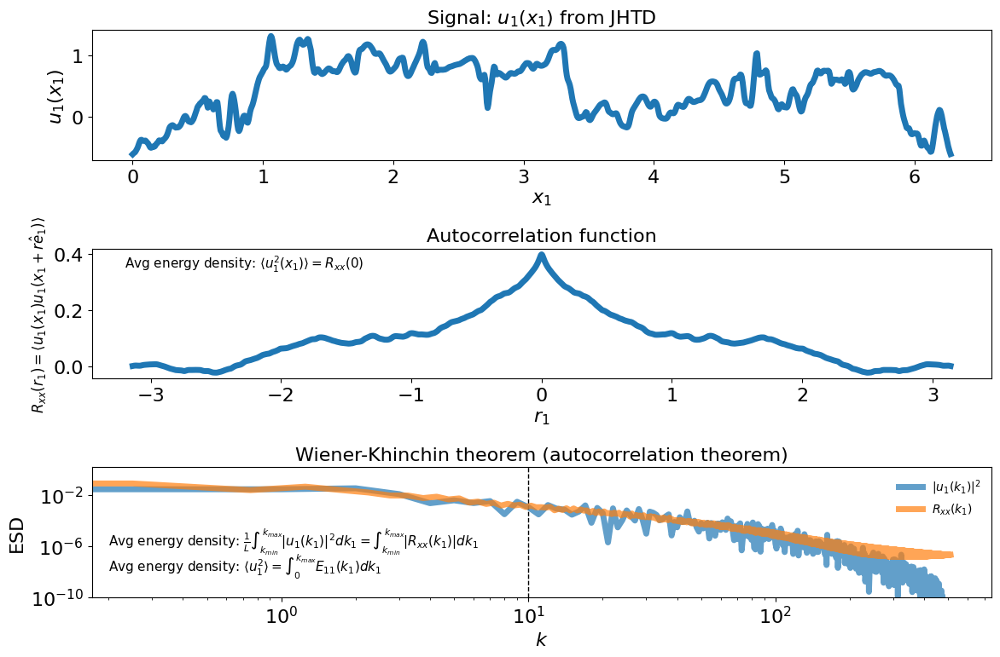

In [6]:
# Get more statistsics for the autocorrelation function
from tqdm import tqdm_notebook as tqdm
udata2, xxx, yyy, zzz = vel.get_sample_turb_field_3d()

rffys = np.empty((2047, udata2.shape[2]))

y0, z0 = 0, 0
for y0 in tqdm(range( udata2.shape[2])):
    ux, x = udata2[0, y0, : , z0, 0], xxx[0, :, 0]
    
    t = x
    T = t[-1]-t[0]
    dt = t[1]-t[0]
    fs = 1/dt
    yt = ux

    yf, f = vel.fourier_transform_1d(yt, fs, t[0], return_freq=True)
    esd = np.abs(yf)**2 / T # 1D energy soectrum

    # autoccorelation
    ryy = signal.correlate(yt, yt, mode='full', method='auto') / (len(yt)-1) # <y(t)y(t+tau)>
    # ryy = signal.correlate(yt, yt, mode='full', method='auto') / (len(yt)-1) * (t[-1]-t[0]) # \int_t0^t1 y(t)y(t+tau) dt
    lags = signal.correlation_lags(len(yt), len(yt), mode='full') * dt/2

    # basics (Parseval's theorem)
#     print('Avg energy density, Ryy(0):', np.trapz(yt**2, t) / T, ryy[len(yt)-1])

    rffy, fac = vel.fourier_transform_1d(ryy, fs, t[0], return_freq=True,) # FT of autocorrelation function\
    
    rffys[:, y0] = np.abs(rffy)
rffy = np.nanmean(rffys, axis=-1)
    
# plot results
fig, ax1 = graph.plot(t, yt, subplot=311)
fig, ax2 = graph.plot(lags, ryy, subplot=312)
fig, ax3 = graph.plot(f*2*np.pi, esd/(2*np.pi), label='$|u_1(k_1)|^2$', subplot=313, alpha=0.7)
graph.plot(fac*2*np.pi, np.abs(rffy)/(2*np.pi), label='$R_{xx}(k_1)$', subplot=313, alpha=0.7)
# graph.plot(fac*2*np.pi, 2*np.abs(rffy)/(2*np.pi), label='$E_{11}(k_1) \equiv 2 R_{xx}(k_1)$', subplot=313, alpha=0.2, color='r')

graph.axvline(ax3, 10)
ax3.legend(fontsize=10, loc='upper right', frameon=False)
graph.tologlog(ax3)
ax3.set_ylim(1e-10, None)


graph.labelaxes(ax1, '$x_1$', '$u_1(x_1)$')
ax2.set_xlabel('$r_1$')
ax2.set_ylabel('$R_{xx}(r_1)=\langle u_1(x_1)u_1(x_1+r\hat{e}_1) \\rangle$', fontsize=12)
graph.labelaxes(ax3, '$k$', 'ESD')
graph.title(ax1, 'Signal: $u_1(x_1)$ from JHTD')
graph.title(ax2, 'Autocorrelation function')
graph.title(ax3, 'Wiener-Khinchin theorem (autocorrelation theorem)')
graph.addtext(ax2, 'Avg energy density: $\langle u_1^2(x_1) \\rangle =R_{xx}(0)$',
              x=-3.2, y=0.35, fontsize=11)
graph.addtext(ax3, 'Avg energy density: $\\frac{1}{L} \int_{k_{min}}^{k_{max}}|u_1(k_1)|^2 dk_1=\int_{k_{min}}^{k_{max}} |R_{xx}(k_1)| dk_1 $', 
              x=2e-1, y=1e-6, fontsize=11)
graph.addtext(ax3, 'Avg energy density: $\langle u_1^2 \\rangle = \int_{0}^{k_{max}} E_{11}(k_1) dk_1 $', 
              x=2e-1, y=1e-8, fontsize=11)
fig.tight_layout()

etot = np.trapz(yt**2, t)
etot/T, np.trapz(esd, f)/T, np.trapz(np.abs(rffy), fac)

## Structure Function and cropping

### One realization

Saving figure to './struc_func_cropping_raw_epsilon0p085.pdf'...
... Done


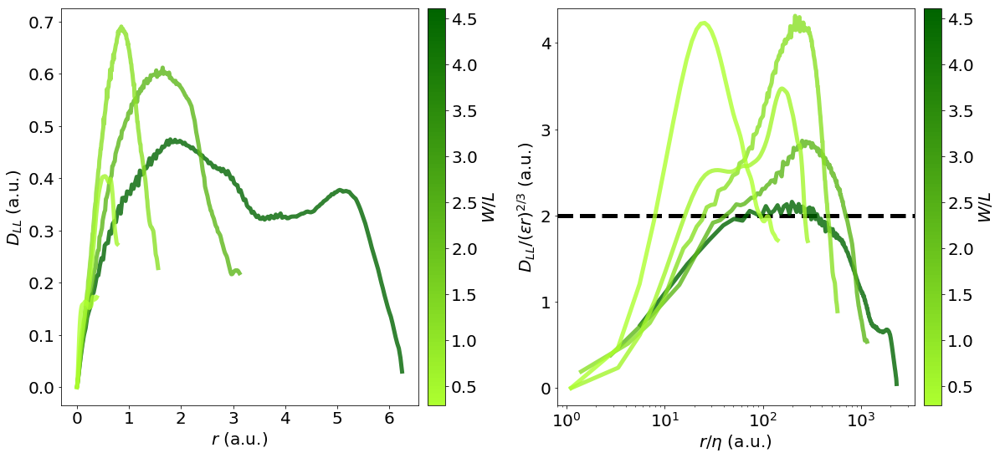

In [36]:
reload(vel)
__fontsize__ = 20
__figsize__ = (17, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':14, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)


L = 1.364 #int scale

x0, y0 = 0, 0
p = 2 # order of structure function
resolutions = np.asarray([1024, 512, 256, 128, 64])
coarses = [0.2, 0.4, 0.8, 1., 1.]
# Plotting settings
colors, cmap, norm = graph.get_colors_and_cmap_using_values(2*np.pi / L * resolutions / 1024.)

# # initialization
# rrs_list, Dxxs_list, Dxx_errs_list, rrs_scaled_list, Dxxs_scaled_list, Dxx_errs_scaled_list = [], [], [], [], [], []
# data_lists = [rrs_list, Dxxs_list, Dxx_errs_list, rrs_scaled_list, Dxxs_scaled_list, Dxx_errs_scaled_list]

# for i, res in enumerate(resolutions):
#     rrs, Dxxs, Dxx_errs, rrs_scaled, Dxxs_scaled, Dxx_errs_scaled = vel.get_structure_function_long(udata2d, xx, yy, nu=nu, coarse=coarses[i], coarse2=1, p=p, x0=x0, x1=x0+res, y0=y0, y1=y0+res)
# #     rrs_scaled, Dxxs_scaled, Dxx_errs_scaled = vel.scale_raw_structure_funciton_long(rrs, Dxxs, Dxx_errs, epsilon=0.09, nu=nu, p=p)
#     datum_lists = [rrs, Dxxs, Dxx_errs, rrs_scaled, Dxxs_scaled, Dxx_errs_scaled]
#     for i, datum in enumerate(datum_lists):
#         data_lists[i].append(datum_lists[i])

# Plotting
for i, res in enumerate(resolutions):
    rrs, Dxxs, Dxx_errs, rrs_scaled, Dxxs_scaled, Dxx_errs_scaled = data_lists[0][i], data_lists[1][i], data_lists[2][i], data_lists[3][i], data_lists[4][i], data_lists[5][i]
    w_in_l = 2*np.pi / L * res / 1024.
    color = cmap(norm(2*np.pi / L * res / 1024.))
    fig, ax11 = graph.plot(rrs[:, t0], Dxxs[:, t0], subplot=121, alpha=0.8, color=cmap(norm(2*np.pi / L * res / 1024.)),
                                                                                      label='$E(\kappa)$, $W = %.2f L$' % (2*np.pi / L * res / 1024.))
    fig, ax12 = graph.plot(rrs_scaled[:, t0], Dxxs_scaled[:, t0] *1.25, subplot=122, alpha=0.8, color=cmap(norm(2*np.pi / L * res / 1024.)),
                          label='$E(\kappa)$, $W = %.2f L$' % (2*np.pi / L * res / 1024.))

# fig, ax11 = graph.plot(rrs[:, t0], Dxxs[:, t0], subplot=121)
# fig, ax12 = graph.plot(rrs_scaled[:, t0], Dxxs_scaled[:, t0], subplot=122, figsize=(16, 8))
# reta_sv, dll_sv = vel.get_rescaled_structure_function_saddoughi()
# graph.plot(reta_sv, dll_sv,  subplot=122, label='Saddoughi \& Veeravalli, 1994', color='k', alpha=0.3, zorder=0)
graph.axhline(ax12, 2.0, zorder=0)
graph.tosemilogx(ax12)
graph.labelaxes(ax11, '$r$ (a.u.)', '$D_{LL}$ (a.u.)')
graph.labelaxes(ax12, '$r / \eta$ (a.u.)', '$D_{LL} / (\epsilon r)^{%d/3}$ (a.u.)' % p)
graph.add_colorbar_alone(ax11, [2*np.pi / L * res / 1024. for res in resolutions], cmap=cmap, label='$W/L$')
graph.add_colorbar_alone(ax12, [2*np.pi / L * res / 1024. for res in resolutions], cmap=cmap, label='$W/L$')
graph.setaxes(ax12, 0.8, 3500, -0.2, 4.4)


fig.tight_layout()
graph.save('./struc_func_cropping_raw_epsilon0p085')


### Take ensemble average

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook=False

Using tqdm_notebook. If this is a mistake, set notebook

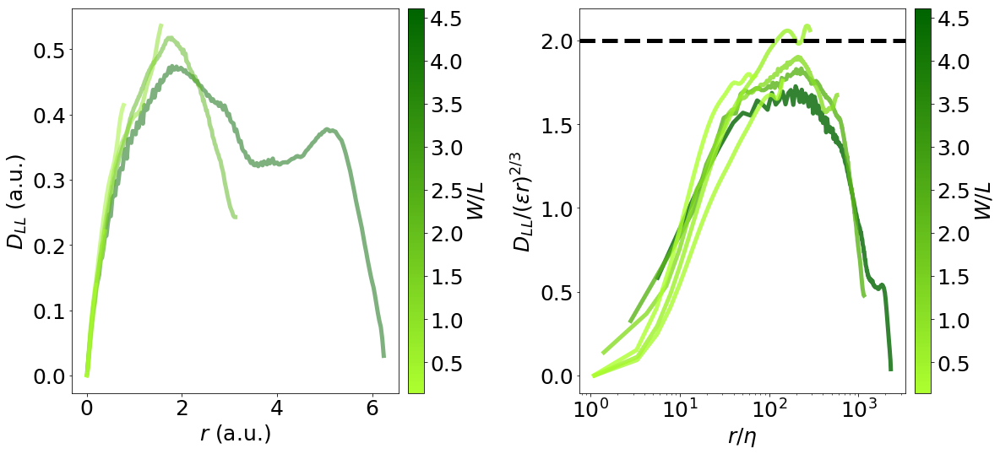

In [13]:
reload(vel)
__fontsize__ = 25
__figsize__ = (17, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':14, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)


L = 1.364 #int scale

x0, y0 = 0, 0

p = 2 # order of structure function
resolutions = np.asarray([1024, 512, 256, 128, 64, 32])
coarses = [0.2, 0.4, 0.8, 1., 1., 1.]
# coarses = [0.2, 0.4, 0.8, 1]
# Plotting settings
colors, cmap, norm = graph.get_colors_and_cmap_using_values(2*np.pi / L * resolutions / 1024.)

# initialization
rrs_avgs, Dxxs_avgs, Dxx_errs_avgs, rrs_scaled_avgs, Dxxs_scaled_avgs, Dxx_errs_scaled_avgs = [], [], [], [], [], []
data_avgs = [rrs_avgs, Dxxs_avgs, Dxx_errs_avgs, rrs_scaled_avgs, Dxxs_scaled_avgs, Dxx_errs_scaled_avgs]

for j, res in enumerate(resolutions):
    if res == 1024:
        n_samples = 1
    elif res == 512:
        n_samples = 5
    else:
        n_samples = 20
    # initialization
    rrs_list, Dxxs_list, Dxx_errs_list, rrs_scaled_list, Dxxs_scaled_list, Dxx_errs_scaled_list = [], [], [], [], [], []
    data_lists = [rrs_list, Dxxs_list, Dxx_errs_list, rrs_scaled_list, Dxxs_scaled_list, Dxx_errs_scaled_list]

    # computation
    for nn in range(n_samples):
        x0, y0 = int(np.random.rand() * (1024 - res)), int(np.random.rand() * (1024 - res))
        rrs, Dxxs, Dxx_errs, rrs_scaled, Dxxs_scaled, Dxx_errs_scaled = vel.get_structure_function_long(udata2d, xx, yy,
                                                                                                        nu=nu, coarse=coarses[j], coarse2=1,
                                                                                                        p=p, x0=x0, x1=x0+res, y0=y0, y1=y0+res)
    #     rrs_scaled, Dxxs_scaled, Dxx_errs_scaled = vel.scale_raw_structure_funciton_long(rrs, Dxxs, Dxx_errs, epsilon=0.09, nu=nu, p=p)
        datum_lists = [rrs, Dxxs, Dxx_errs, rrs_scaled, Dxxs_scaled, Dxx_errs_scaled]
        for i, datum in enumerate(datum_lists):
            data_lists[i].append(datum_lists[i])

    # Plotting
    data = np.asarray(data_lists)
    # rrs, Dxxs, Dxx_errs, rrs_scaled, Dxxs_scaled, Dxx_errs_scaled = data_lists[0][i], data_lists[1][i], data_lists[2][i], data_lists[3][i], data_lists[4][i], data_lists[5][i]
    # rrs, Dxxs, Dxx_errs, rrs_scaled, Dxxs_scaled, Dxx_errs_scaled = np.nanmean(data_lists[0,...], axis=0), np.nanmean(data_lists[1,...], axis=0), np.nanmean(data_lists[2,...],axis=0), np.nanmean(data_lists[3,...], axis=0), np.nanmean(data_lists[4,...], axis=0), np.nanmean(data_lists[5,...], axis=0)
    rrs_avg, Dxxs_avg, Dxx_errs_avg = np.nanmean(data[0,...], axis=0), np.nanmean(data[1,...], axis=0), np.nanmean(data[2,...], axis=0)
    rrs_scaled, Dxxs_scaled, Dxx_errs_scaled = np.nanmean(data[3,...], axis=0), np.nanmean(data[4,...], axis=0), np.nanmean(data[5,...], axis=0)

    w_in_l = 2*np.pi / L * res / 1024.
    color = cmap(norm(2*np.pi / L * res / 1024.))
    fig, ax11 = graph.plot(rrs_avg[:, t0], Dxxs_avg[:, t0], subplot=121, alpha=0.5, color=cmap(norm(2*np.pi / L * res / 1024.)),
                                                                                      label='$E(\kappa)$, $W = %.2f L$' % (2*np.pi / L * res / 1024.))
    fig, ax12 = graph.plot(rrs_scaled[:, t0], Dxxs_scaled[:, t0], subplot=122, alpha=0.8, color=cmap(norm(2*np.pi / L * res / 1024.)),
                          label='$E(\kappa)$, $W = %.2f L$' % (2*np.pi / L * res / 1024.))
    
    datum_avgs = [rrs_avg, Dxxs_avg, Dxx_errs_avg, rrs_scaled, Dxxs_scaled, Dxx_errs_scaled]
    for i, datum in enumerate(datum_avgs):
            data_avgs[i].append(datum_avgs[i])

# fig, ax11 = graph.plot(rrs[:, t0], Dxxs[:, t0], subplot=121)
# fig, ax12 = graph.plot(rrs_scaled[:, t0], Dxxs_scaled[:, t0], subplot=122, figsize=(16, 8))
graph.axhline(ax12, 2.0)
graph.tosemilogx(ax12)
graph.labelaxes(ax11, '$r$ (a.u.)', '$D_{LL}$ (a.u.)')
graph.labelaxes(ax12, '$r / \eta$', '$D_{LL} / (\epsilon r)^{%d/3}$' % p)
graph.add_colorbar_alone(ax11, [2*np.pi / L * res / 1024. for res in resolutions], cmap=cmap, label='$W/L$')
graph.add_colorbar_alone(ax12, [2*np.pi / L * res / 1024. for res in resolutions], cmap=cmap, label='$W/L$')
# ax11.legend(loc=1, fontsize=14)
# ax12.legend(loc=1, fontsize=14)

# fig.tight_layout()
# graph.save('./struc_func_cropping_raw2')


Saving figure to './struc_func_ensemble_avg_20_realizations_epsilon.pdf'...
... Done


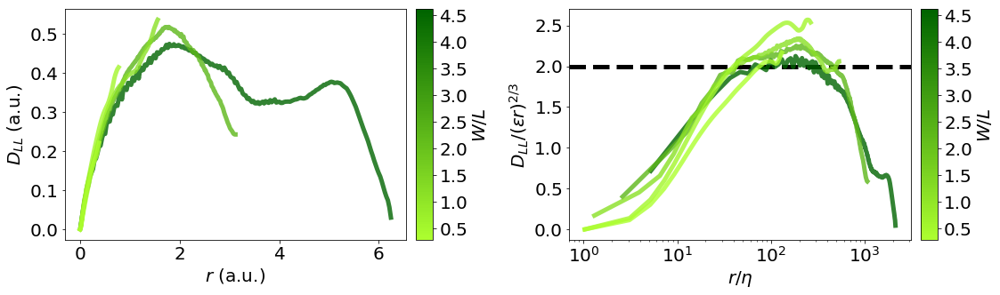

In [40]:
# PLOTTING
__fontsize__ = 20
__figsize__ = (17, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':14, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)


# PLOTTING
rrs, Dxxs, Dxx_errs, rrs_scaled, Dxxs_scaled, Dxx_errs_scaled = data_avgs
for i, res in enumerate(resolutions):
#     graph.plot(rrs[i], Dxxs[i])
    w_in_l = 2*np.pi / L * res / 1024.
    color = cmap(norm(2*np.pi / L * res / 1024.))
    fig, ax11 = graph.plot(rrs[i][:, t0], Dxxs[i][:, t0], subplot=121, alpha=0.8, color=cmap(norm(2*np.pi / L * res / 1024.)),
                                                                                      label='$E(\kappa)$, $W = %.2f L$' % (2*np.pi / L * res / 1024.))
    
    rrs_scaled_, Dxxs_scaled_, Dxx_errs_ = vel.scale_raw_structure_funciton_long(np.asarray(rrs), np.asarray(Dxxs), np.asarray(Dxx_errs), 0.085, nu=nu)
    fig, ax12 = graph.plot(rrs_scaled_[i][:, t0], Dxxs_scaled_[i][:, t0], subplot=122, figsize=(16, 5), alpha=0.8, color=cmap(norm(2*np.pi / L * res / 1024.)),
                          label='$E(\kappa)$, $W = %.2f L$' % (2*np.pi / L * res / 1024.))

# fig, ax11 = graph.plot(rrs[:, t0], Dxxs[:, t0], subplot=121)
# fig, ax12 = graph.plot(rrs_scaled[:, t0], Dxxs_scaled[:, t0], subplot=122, figsize=(16, 8))
graph.axhline(ax12, 2.0, zorder=0)
graph.tosemilogx(ax12)
graph.labelaxes(ax11, '$r$ (a.u.)', '$D_{LL}$ (a.u.)')
graph.labelaxes(ax12, '$r / \eta$', '$D_{LL} / (\epsilon r)^{%d/3}$' % p)
graph.add_colorbar_alone(ax11, [2*np.pi / L * res / 1024. for res in resolutions], cmap=cmap, label='$W/L$')
graph.add_colorbar_alone(ax12, [2*np.pi / L * res / 1024. for res in resolutions], cmap=cmap, label='$W/L$')
# graph.setaxes(ax12, 0.8, 3500, -0.2, 4.4)
# ax11.legend(loc=1, fontsize=12)
# ax12.legend(loc=1, fontsize=12)
# graph.setaxes(ax11, -0.1, 6.28, -0.1, 0.8)
fig.tight_layout()
graph.save('./struc_func_ensemble_avg_20_realizations_epsilon')

## Coarse-graining

Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Saving figure to './espec_jhtd_coarse_graining_effect.pdf'... ... Done


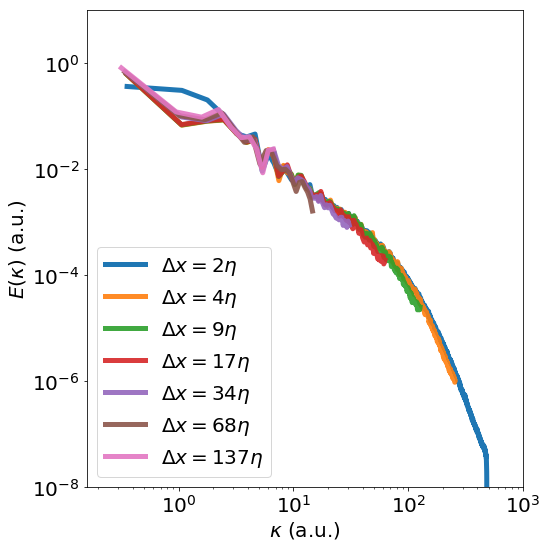

In [436]:
import library.basics.formatarray as fa
__fontsize__ = 20
__figsize__ = (8, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':20, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)

# nrowsub, ncolsub = 32, 32
# xx, yy = vel.get_equally_spaced_grid(udata2d, spacing=dx)

# ux_c = fa.coarse_grain_2darr(ux_test[..., 0], nrowsub, ncolsub)
# uy_c = fa.coarse_grain_2darr(ux_test[..., 0], nrowsub, ncolsub)
# udata_c = np.stack((ux_c, uy_c))
# xx_c = fa.coarse_grain_2darr(xx, nrowsub, ncolsub)
# yy_c = fa.coarse_grain_2darr(yy, nrowsub, ncolsub)
# graph.color_plot(xx, yy, ux_test[..., 0], fignum=1, subplot=121)
# graph.color_plot(xx_c, yy_c, ux_c, fignum=2, subplot=121)
# ek, ek_err, kr = vel.get_energy_spectrum(udata2d, dx=dx, dy=dy)
# ek_c, ek_err_c, kr_c = vel.get_energy_spectrum(udata_c, dx = xx[0,1]-xx[0,0], dy = yy[1,0]-yy[0,0])
# fig, ax = graph.plot(kr[:,0], ek[:,0], fignum=1, subplot=122)
# fig, ax2 = graph.plot(kr_c[:,0], ek_c[:,0], fignum=2, subplot=122)
# graph.tologlog(ax)
# graph.tologlog(ax2)

# fig.tight_layout()

resolutions = [2, 4, 8, 16, 32, 64]
eta = (nu**3 / epsilon)**0.25
ek, ek_err, kr = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx)
fig3, ax3 = graph.plot(kr[:,0], ek[:,0], fignum=3, subplot=111,label='$\Delta x=%.f \eta$' % ((xx[0,1]-xx[0,0])/eta))
for i, resolution in enumerate(resolutions):
    ux_c = fa.coarse_grain_2darr(ux_test[..., 0], resolution, resolution)
    uy_c = fa.coarse_grain_2darr(ux_test[..., 0], resolution, resolution)
    udata_c = np.stack((ux_c, uy_c))
    xx_c = fa.coarse_grain_2darr(xx, resolution, resolution)
    yy_c = fa.coarse_grain_2darr(yy, resolution, resolution)
    ek_c, ek_err_c, kr_c = vel.get_energy_spectrum(udata_c, dx = xx_c[0,1]-xx_c[0,0], dy = yy_c[1,0]-yy_c[0,0])
    fig3, ax3 = graph.plot(kr_c[:,0], ek_c[:,0], fignum=3, subplot=111, label='$\Delta x=%.f \eta$' % ((xx_c[0,1]-xx_c[0,0])/eta), alpha=0.9)

graph.tologlog(ax3)

graph.setaxes(ax3, 10**-0.8, 10**3, 10**-8, 10**1)
ax3.legend()

graph.labelaxes(ax3, '$\kappa$ (a.u.)', '$E(\kappa)$ (a.u.)' )
fig3.tight_layout()
graph.save('./espec_jhtd_coarse_graining_effect')

In [125]:
ws = [16,32, 64, 128, 256, 512, 1024]
for w in tqdm(ws):
    ll = 2*np.pi / L * w / 1024.  
    deltax_in_eta = dx / eta
    ek2d, ks = vel.get_energy_spectrum_nd(udata2d, dx=dx, dy=dx, x1=w, y1=w)
    fig, ax, cc = graph.color_plot(ks[0, ...], ks[1, ...], ek2d[..., 0], log10=True, vmax=5, vmin=-6)
    graph.labelaxes(ax, '$k_x$ (a.u.)', '$k_y$ (a.u.)')
    graph.add_colorbar(cc, ax=ax, label='$\log_{10}{E (\\vec{\kappa})}$')
    graph.setaxes(ax, -512, 512, -512, 512)
    graph.title(ax, '$W=%.2f L$, $\Delta x = %.1f \eta$' %(ll, deltax_in_eta))
    graph.save('./ek2d_jhtd_%04d' % w, ext='png', close=True)

# print 2*np.pi / L * 32. / 1024.

Saving figure to './ek2d_jhtd_0016.png'... ... Done
Saving figure to './ek2d_jhtd_0032.png'... ... Done
Saving figure to './ek2d_jhtd_0064.png'... ... Done
Saving figure to './ek2d_jhtd_0128.png'... ... Done
Saving figure to './ek2d_jhtd_0256.png'... ... Done
Saving figure to './ek2d_jhtd_0512.png'... ... Done
Saving figure to './ek2d_jhtd_1024.png'... ... Done



(-0.5, 240)

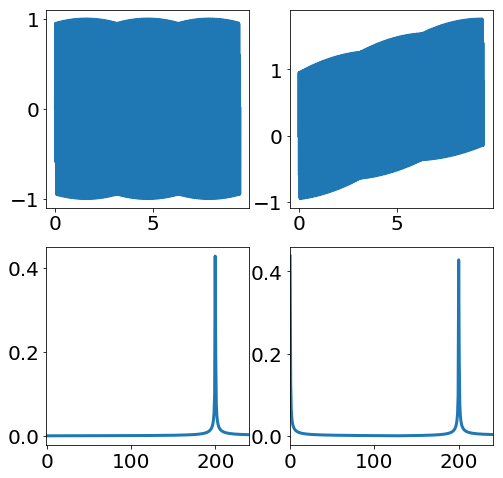

In [446]:
n=1000
x = np.linspace(0, 3*np.pi, n)
deltax = x[1]-x[0]
y_short = np.sin(200. * x)
y_long = np.sin(0.1 * x)

y = y_long + y_short
graph.plot(x, y_short, linewidth=3, fignum=1, subplot=221)
graph.plot(x, y, linewidth=3, fignum=1, subplot=222)

y_short_k = np.fft.fft(y_short) / n
yk = np.fft.fft(y) / n
k = np.fft.fftfreq(n,d=deltax) * 2* np.pi

fig, ax3 = graph.plot(k[:n/2], np.abs(y_short_k[:n/2]), linewidth=3, fignum=1, subplot=223)
fig, ax4 = graph.plot(k[:n/2], np.abs(yk[:n/2]), linewidth=3, fignum=1, subplot=224)
ax3.set_xlim(-0.5, 240)
ax4.set_xlim(-0.5, 240)

In [540]:
reload(vel)
a = vel.get_epsilon_using_sij(udata2d, dx=dx, dy=dy)

print a, a*dx

0.00613592315154
[629.00731789 628.97691891] [3.85954056 3.85935404]


## TEST ON 1D SPECTRUM USING LES DATA

(65536, 4)


(<matplotlib.figure.Figure at 0x199f46a10>,
 <matplotlib.collections.QuadMesh at 0x16085ebd0>)

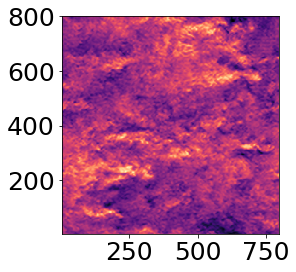

In [714]:
import library.tools.rw_data as rw
les_simdata_path = '/Volumes/labshared4/takumi/iPython_Notebooks/tutorials/les_simdata.pkl'

data = rw.read_pickle(les_simdata_path)
print data.shape
x, y, ux = data[:, 0], data[:, 1], data[:, 2]
nx = int(np.max(x) / 3.125) + 1
ny = int(np.max(y) / 3.125) + 1


x = np.arange(1, int(nx)+1) * 3.125
y = np.arange(1, int(ny)+1) * 3.125
xx, yy = np.meshgrid(x, y)
# print ek.shape, nx * ny
ux = ux.reshape((nx, ny))
graph.color_plot(xx, yy, ux)

Using tqdm_notebook. If this is a mistake, set notebook=False


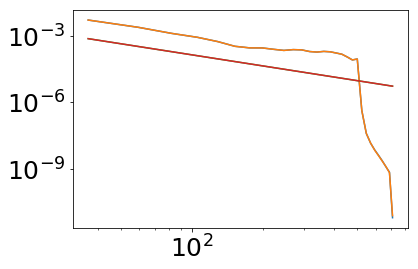

In [97]:
dx = 2*np.pi/ 1024.
ek, ek_err, kr = vel.get_energy_spectrum(udata2d, dx=dx, dy=dx, nkout=30)
fig,ax = graph.plot(kr, ek)
graph.plot(kr, vel.kolmogorov_53_uni(kr, epsilon=epsilon))
graph.tologlog(ax)

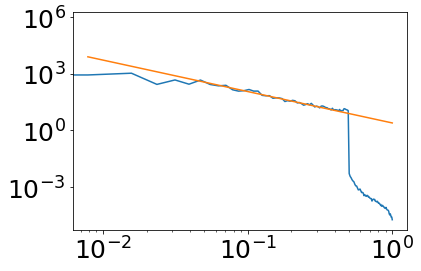

In [741]:
ux_k = np.fft.fft(ux, axis=0)
# ux_k = np.fft.fftshift(ux_k, axes=0)
e11k_2d = np.abs(ux_k * np.conj(ux_k))
e11k = np.nansum(e11k_2d, axis=1) / ny

kx = np.fft.fftfreq(nx, d=3.125) * 2*np.pi
# plt.imshow(e11k)
# plt.colorbar()

fig, ax = graph.plot(kx[:128], e11k[:128])
graph.plot(kx[:128], vel.kolmogorov_53(kx[:128], 2.5))
graph.tologlog(ax)

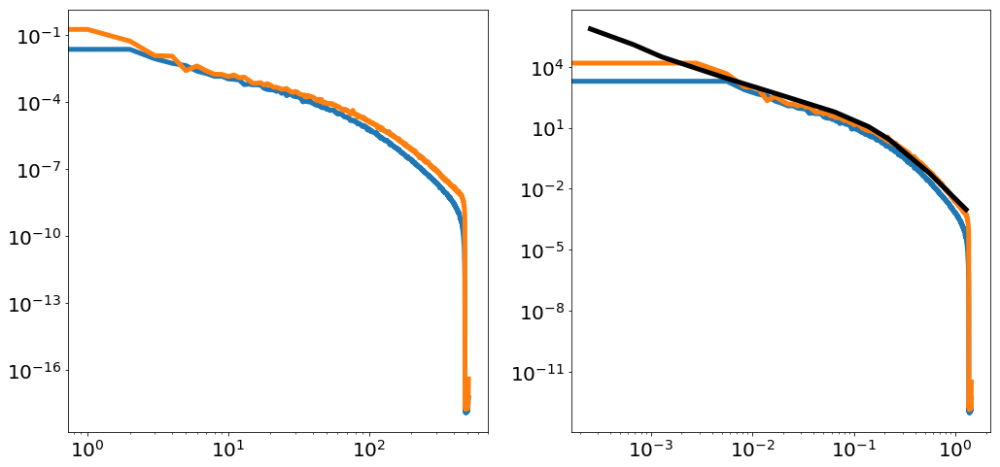

In [196]:
reload(vel)
__fontsize__ = 20
__figsize__ = (17, 8)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':20, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 5}
graph.update_figure_params(params)


eii_arr, eii_err_arr, k1d = vel.get_1d_energy_spectrum(udata_test, dx=dx)
eii_arr_s, eii_err_arr_s, k1d_s = vel.get_1d_rescaled_energy_spectrum(udata_test, epsilon=epsilon, nu=nu, dx=dx)
e11, e22 = eii_arr
e11_s, e22_s = eii_arr_s
fig, ax = graph.plot(k1d, e11[:, 0], subplot=121)
fig, ax = graph.plot(k1d, e22[:, 0], subplot=121)
fig, ax2 = graph.plot(k1d_s[:, 0], e11_s[:, 0], subplot=122)
fig, ax2 = graph.plot(k1d_s[:, 0], e22_s[:, 0], subplot=122)

fig1, ax2 = graph.plot_saddoughi(fignum=1, subplot=122, color='k', linewidth=5, label='Saddoughi and Veeravalli')

graph.tologlog(ax)
graph.tologlog(ax2)

# Streamfunction

## 2D velocity field

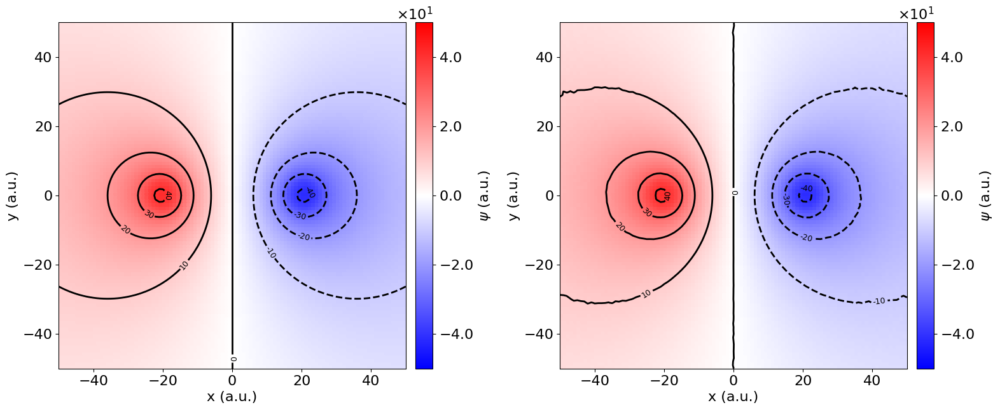

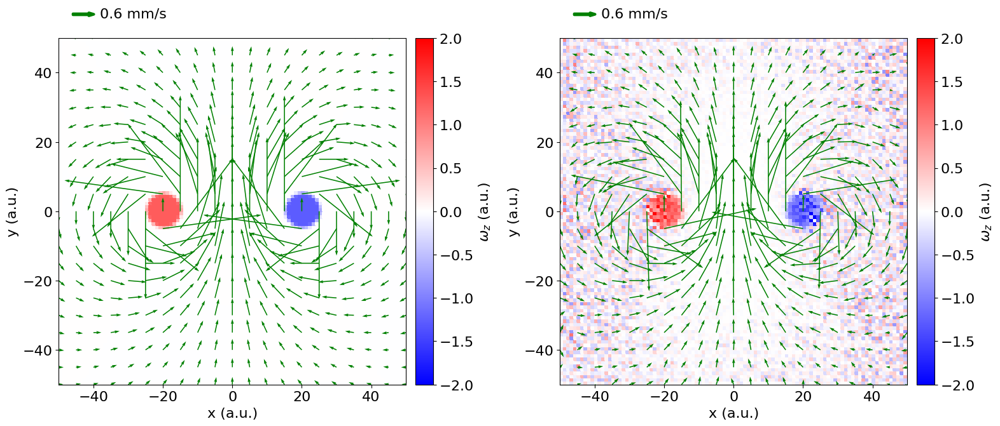

In [263]:
reload(vel)

x = np.linspace(-50, 50, 101)
y = np.linspace(-50, 50, 101)
xx, yy = np.meshgrid(x, y)

dx, dy = vel.get_grid_spacing(xx, yy)
gamma, a = 100, 5
psi1 = vel.get_streamfunction_about_a_rankine_vortex(xx, yy, x0=20, y0=0, gamma=-gamma, a=a)
psi2 = vel.get_streamfunction_about_a_rankine_vortex(xx, yy, x0=-20, y0=0, gamma=gamma, a=a)
psi = psi1 + psi2
omega = -vel.laplacian(psi, dx, dy)
pdata = vel.psi2udata(psi, xx=xx, yy=yy)

pdata1_analytical = vel.rankine_vortex_2d(xx, yy, x0=20, y0=0, gamma=-gamma, a=a)
pdata2_analytical = vel.rankine_vortex_2d(xx, yy, x0=-20, y0=0, gamma=gamma, a=a)
pdata_analytical = pdata1_analytical + pdata2_analytical

fig1, ax11, cc11 = graph.color_plot(xx, yy, psi, vmin=-50, vmax=50, cmap='bwr', label='$\\psi$ (a.u.)',
                 fignum=1, subplot=121, figsize=(16, 8))
fig1, ax11, ctrs = graph.contour(xx, yy, psi, np.linspace(-40, 40, 9),linewidths=2, colors='k', fmt='%.f', 
              fignum=1, subplot=121, figsize=(16, 8))

fig2, ax21, cc21 = graph.color_plot(xx, yy, omega, label='$\omega_z$ (a.u.)',
                                    cmap='bwr', 
                                    vmin=-2, vmax=2,
                                    fignum=2, subplot=121, figsize=(16, 8))
fig2, ax21, q21 = graph.quiver(xx, yy, pdata[0, ...], pdata[1, ...], 
                               key_loc=[0.1, 1.07], linewidths=3,
                               color='g', inc=5, scale=1e1,
                               fignum=2, subplot=121, figsize=(16, 8))
# graph.quiver(xx, yy, pdata_analytical[0, ...], pdata_analytical[1, ...], color='r', inc=1, 
#             fignum=2, subplot=121, scale=1e1)


xref, yref = 0, 0
nctrs = 1
psi_s, psi_err, xx_s, yy_s = vel.compute_streamfunction_direct(pdata, xx, yy, xref, yref, 
                                             nkinks=3, noise=None, nctrs=nctrs, inc=1,
                                             return_sampled_grid=True)
omega_s = -vel.laplacian(psi_s, dx, dy)[..., 0]
pdata_s = vel.psi2udata(psi_s, xx=xx_s, yy=yy_s)[..., 0]

fig1, ax12, cc12 = graph.color_plot(xx_s, yy_s, psi_s[..., 0], vmin=-50, vmax=50, cmap='bwr',  label='$\\psi$ (a.u.)',
                 fignum=1, subplot=122, figsize=(16, 8))
fig1, ax12, ctrs = graph.contour(xx_s, yy_s, psi_s[..., 0], np.linspace(-40, 40, 9),linewidths=2, colors='k', fmt='%.f', 
              fignum=1, subplot=122, figsize=(16, 8))

fig2, ax22, cc22 = graph.color_plot(xx_s, yy_s, omega_s, label='$\omega_z$ (a.u.)',
                 cmap='bwr', 
                 vmin=-2, vmax=2,
                 fignum=2, subplot=122, figsize=(16, 8))
fig2, ax22, q22 = graph.quiver(xx_s, yy_s, pdata_s[0, ...], pdata_s[1, ...], 
                               key_loc=[0.1, 1.07], linewidths=3,
                               color='g', inc=5, scale=1e1,
                               fignum=2, subplot=122, figsize=(16, 8))
        
figs = [fig1, fig2]
axes = [ax11, ax12, ax21, ax22]
for ax in axes:
    graph.labelaxes(ax, 'x (a.u.)', 'y (a.u.)')

for fig in figs:
    fig.tight_layout()

## 3D, axisymmetric flows

compute_streamfunction_direct():
... coordinate_system is cylindrical
... udata=(uz, urho), (xx, yy) will be interpreted as (zz, rrho)
... (xp, yp, xref, yref) will be interpreted as (zp, rhop, zref, rhoref)
... yy = rrho  must be in an ascending order. (1) you must be passing rho = sqrt(xx **2 + yy**2)
therefore, rho must be greater or equal to 0 !!!



(2, 26, 51) (26, 51, 1) 0
gaussian_blur_scalar_field():
... this assumes the input array has a shape (..., duration)
... A Gaussian kernel is applied between axis=0 and axis=-2


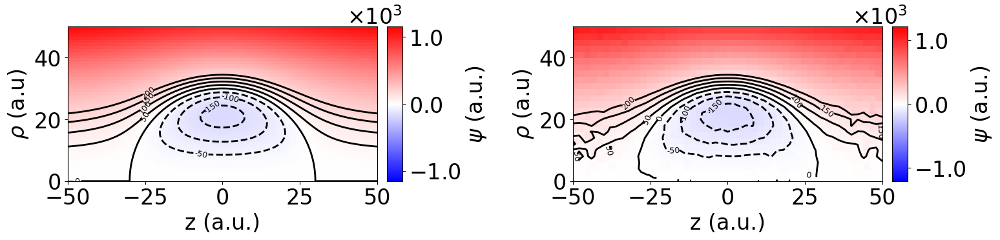

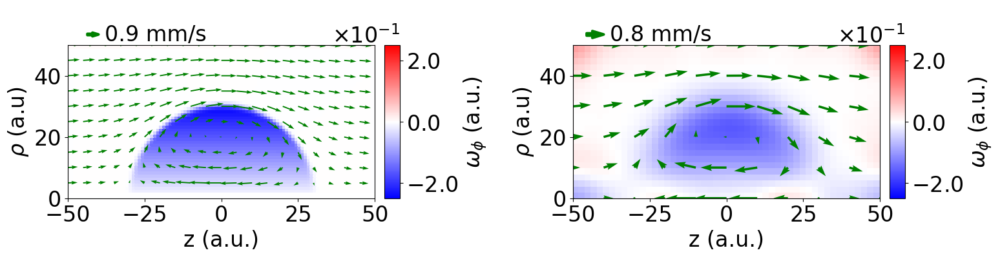

In [6]:
reload(vel)


x = np.linspace(-50, 50, 101)# technically this is z
y = np.linspace(0, 50, 51)# technivally ths is rho 
xx, yy = np.meshgrid(x, y)

dx, dy = vel.get_grid_spacing(xx, yy)
gamma, a = 100, 5
psi, zz, rrho = vel.get_streamfunction_hill_spherical_vortex(xx, yy, u=1, a=30, 
                                                   reference_frame='lab', 
                                                   return_cylindrical_coords=True)
# omega = -vel.laplacian(psi, dx, dy)
pdata = vel.psi2udata_cylindrical(psi, zz=zz, rrho=rrho, return_cartesian=False)
omega = vel.curl(pdata, xx=xx, yy=yy)[..., 0]

fig1, ax11, cc11 = graph.color_plot(xx, yy, psi, 
#                                     vmin=-50, vmax=50, 
                                    symmetric=True,
                                    cmap='bwr', label='$\\psi$ (a.u.)',
                                    fignum=1, subplot=121, figsize=(16, 8))
fig1, ax11, ctrs = graph.contour(xx, yy, psi,
                                 np.linspace(-150, 200, 8),
                                 linewidths=2, colors='k', fmt='%.f', 
              fignum=1, subplot=121, figsize=(16, 8))

fig2, ax21, cc21 = graph.color_plot(xx, yy, omega, label='$\omega_\phi$ (a.u.)',
                                    cmap='bwr', 
                                    vmin=-.25, vmax=.25,
#                                     symmetric=True,
                                    fignum=2, subplot=121, figsize=(16, 8))
fig2, ax21, q21 = graph.quiver(xx, yy, pdata[0, ...], pdata[1, ...], 
                               key_loc=[0.1, 1.07], linewidths=3,
                               color='g', inc=5, 
#                                scale=1e3,
#                                vmin=-2, vmax=2,
                               fignum=2, subplot=121, figsize=(16, 8))

xref, yref = 0, 0
nctrs = 1

pdata_cyl= vel.psi2udata_cylindrical(psi, zz=zz, rrho=rrho, return_cartesian=False)
zz, rrho = xx, np.abs(yy)
psi_s, psi_err, xx_s, yy_s = vel.compute_streamfunction_direct(pdata_cyl, zz, rrho, xref, yref, 
                                             nkinks=3, noise=None, nctrs=nctrs, inc=2,
                                             coordinate_system='cylindrical',
                                             return_sampled_grid=True)
pdata_s = vel.psi2udata_cylindrical(psi_s[..., 0], zz=xx_s, rrho=yy_s)
pdata_s = vel.clean_udata(pdata_s)[..., 0]
omega_s = -vel.laplacian(psi_s, dx, dy)[..., 0]
omega_s = vel.curl(pdata_s, xx=xx_s, yy=yy_s)
print(pdata_s.shape, omega_s.shape, vel.count_nans(pdata_s))
omega_s = vel.gaussian_blur_scalar_field(omega_s, sigma=2.5, mode='reflect')[..., 0]

fig1, ax12, cc12 = graph.color_plot(xx_s, yy_s, psi_s[..., 0], 
#                                     vmin=-50, vmax=50, 
                                    cmap='bwr', 
                                    symmetric=True,
                                    label='$\\psi$ (a.u.)',
                                     fignum=1, subplot=122, figsize=(16, 8))
fig1, ax12, ctrs = graph.contour(xx_s, yy_s, psi_s[..., 0], 
                                 np.linspace(-150, 200, 8),
                                 linewidths=2, colors='k', fmt='%.f', 
                                 fignum=1, subplot=122, figsize=(16, 8))

fig2, ax22, cc22 = graph.color_plot(xx_s, yy_s, omega_s, label='$\omega_\phi$ (a.u.)',
                                    cmap='bwr',
                                    vmin=-.25, vmax=.25,
#                                     symmetric=True,
                                    fignum=2, subplot=122, figsize=(16, 8))
fig2, ax22, q22 = graph.quiver(xx_s, yy_s, pdata_s[0, ...], pdata_s[1, ...], 
                               key_loc=[0.1, 1.07], linewidths=3,
                               color='g', inc=5, 
#                                scale=1e1,
                               fignum=2, subplot=122, figsize=(16, 8))
        
figs = [fig1, fig2]
axes = [ax11, ax12, ax21, ax22]
for ax in axes:
    graph.labelaxes(ax, 'z (a.u.)', '$\\rho$ (a.u)')

for fig in figs:
    fig.tight_layout()

# Treatment of 3D velocity field
... If you do not possess a sample 3D turbulent velocity field, ask Takumi how to get one. \n
... Below lists the results using a DNS field.

In [3]:
reload(vel)
import h5py
dpath = '/Users/takumi/Dropbox/Data_transfer/jhtd/isotropic1024coarse_x0_0_x1_1024_y0_0_y1_1024_z0_0_z1_1024_stridex_4_stridey_4_stridez_4.h5'
inc = 1
nu = 0.000185
deltaT = 0.002 #au/ step
with h5py.File(dpath, 'r') as f:
    x, y, z = f['xcoor'][::inc], f['ycoor'][::inc], f['zcoor'][::inc]
    xx, yy, zz = np.meshgrid(y, x, z)
    udata = f['Velocity_0001'][::inc, ::inc, ::inc, :]
    udata = np.swapaxes(udata, 0, -1)
    udata = np.swapaxes(udata, 1, 2)

z= 10
dx, dy, dz = vel.get_grid_spacing(xx, yy, zz)
udata = vel.fix_udata_shape(udata)
udata2d = udata[:2, ..., z, :]

4 4
[0.64175503] [0.62104163]


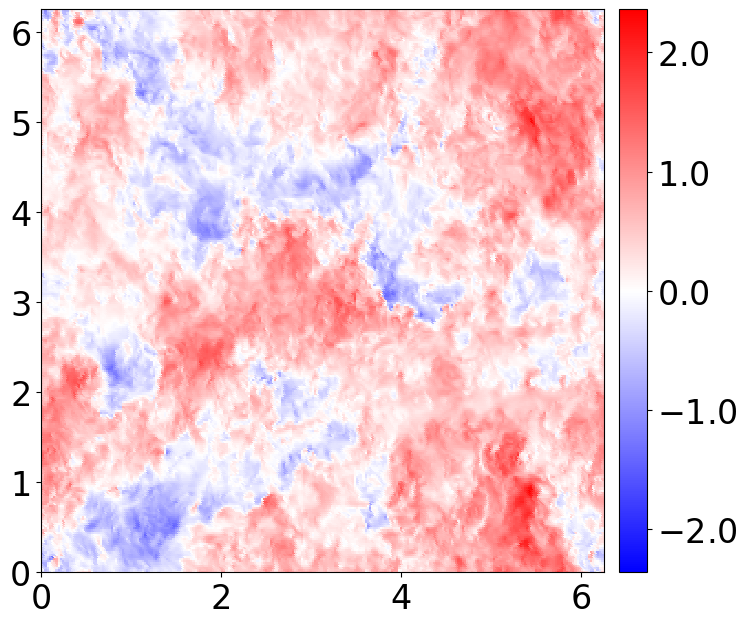

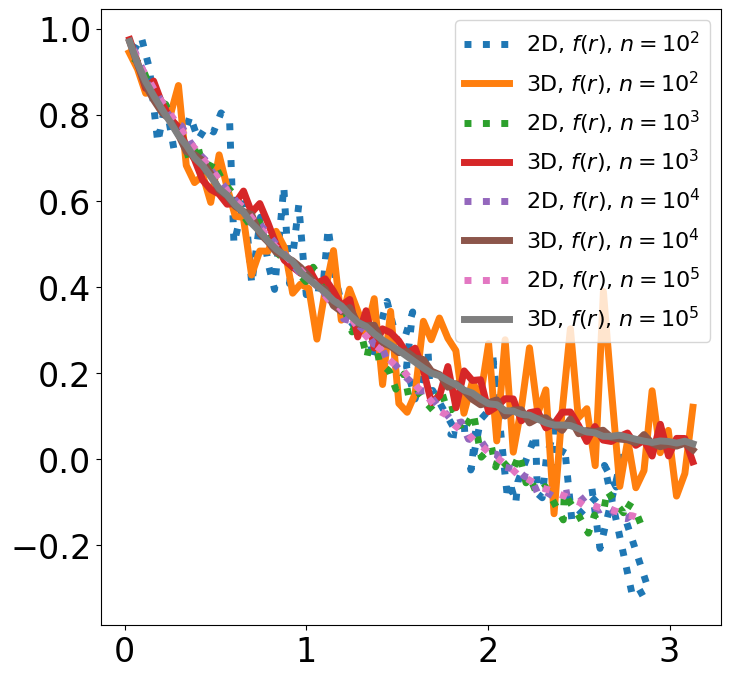

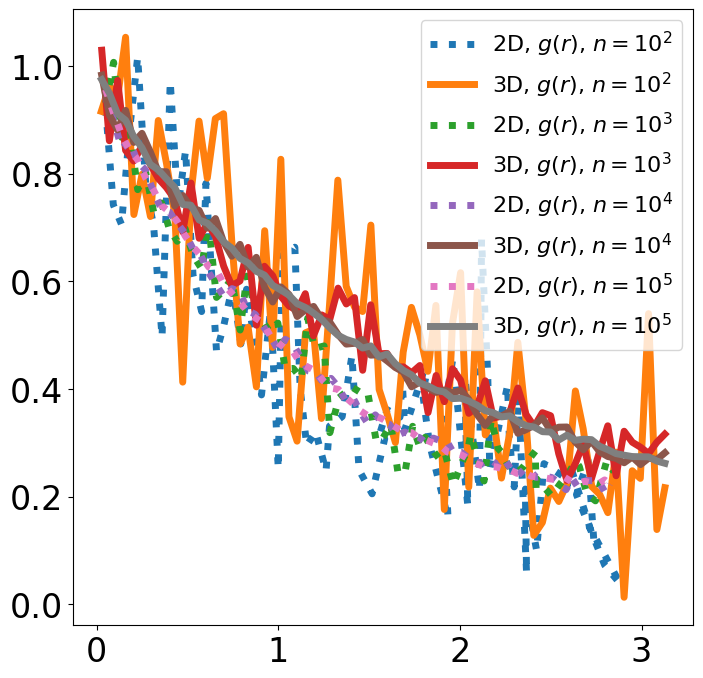

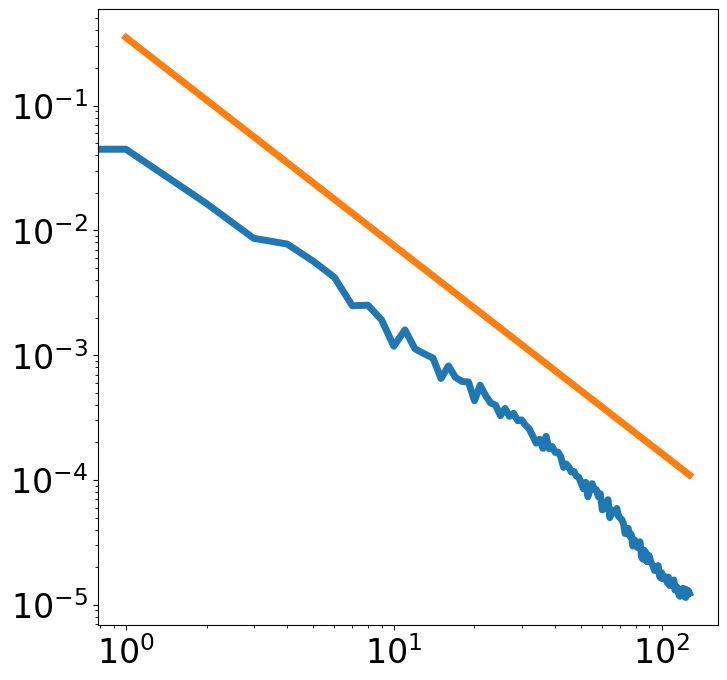

In [8]:
#Autocorrelation functions
    
# Show a sample field
graph.color_plot(xx[..., z], yy[..., z], udata2d[0, ..., 0], cmap='bwr')
(e11s, e22s), err, k1 = vel.get_1d_energy_spectrum(udata[:2, ..., z, :], dx=dx, dy=dy, dz=dz) 

# autocorrs2d = vel.get_two_point_vel_corr(udata2d, x=xx[..., z], y=yy[..., z], roll_axis=1,
#                                              coarse=1, coarse2=1, periodic=True,
#                                          nd=10**3)
# autocorrs3d = vel.get_two_point_vel_corr(udata, x=xx, y=yy, z=zz, roll_axis=1,
#                                              coarse=1, coarse2=1, periodic=True,
#                                             nd=10**4)
# autocorrs3d_e5 = vel.get_two_point_vel_corr(udata, x=xx, y=yy, z=zz, roll_axis=1,
#                                              coarse=1, coarse2=1, periodic=True,
#                                             nd=10**5)

nsamples = [10**2, 10**3, 10**4, 10**5]
# autocorrs2d_list, autocorrs3d_list = [], []
# for i, nsample in enumerate(nsamples):
#     autocorrs2d_ = vel.get_two_point_vel_corr(udata2d, x=xx[..., z], y=yy[..., z], roll_axis=1,
#                                               coarse=1, coarse2=1, periodic=True,
#                                               nd=nsample)
#     autocorrs3d_ = vel.get_two_point_vel_corr(udata, x=xx, y=yy, z=zz, roll_axis=1,
#                                               coarse=1, coarse2=1, periodic=True,
#                                               nd=nsample)
#     autocorrs2d_list.append(autocorrs2d_)
#     autocorrs3d_list.append(autocorrs3d_)

print(len(autocorrs2d_list), len(autocorrs3d_list))
for i, nsample in enumerate(nsamples):
    rrs_2d, fs_2d, f_errs_2d, rrs_2d, gs_2d, g_errs_2d = autocorrs2d_list[i]
    rrs, fs, f_errs, rrs, gs, g_errs = autocorrs3d_list[i]

    fig3, ax3 = graph.plot(rrs_2d[:, 0], fs_2d[:, 0], linestyle=':',
                           fignum=3, label='2D, $f(r)$, $n=10^%.f$' % np.log10(nsample))
    graph.plot(rrs[:, 0], fs[:, 0], fignum=3, label='3D, $f(r)$, $n=10^%.f$' % np.log10(nsample))


    fig4, ax4 = graph.plot(rrs_2d[:, 0], gs_2d[:, 0], linestyle=':',
                           fignum=4, label='2D, $g(r)$, $n=10^%.f$' % np.log10(nsample))
    fig4, ax4 = graph.plot(rrs[:, 0], gs[:, 0], fignum=4, label='3D, $g(r)$, $n=10^%.f$' % np.log10(nsample))
    ax3.legend()
    ax4.legend()


lambdaf, lambdag = vel.get_taylor_microscales(rrs_2d-rrs_2d[0, 0], fs_2d, rrs_2d-rrs_2d[0, 0], gs_2d)
print(lambdaf, lambdag)
# epsilon = vel.get_epsilon_iso(udata2d[...], nu=nu, lambda_g=lambdag)
# epsilon = vel.get_epsilon_using_sij(udata, dx=dx, dy=dy, dz=dz, nu=nu)
epsilon = [0.103]
# print(epsilon, 0.103, lambdaf, lambdag, lambdaf/np.sqrt(2))
fig2, ax2 = graph.plot(k1, e11s[:, 0], fignum=2)
fig2, ax2 = graph.plot(k1, vel.kolmogorov_53_uni(k1, epsilon[0]), fignum=2)
graph.tologlog(ax2)


In [5]:
savedir = '/Users/takumi/Documents/iPython_notebooks/tmp/'

# SAVE DATA
# data = {}
# data['autocorr2ds'] = autocorrs2d_list
# data['autocorr3ds'] = autocorrs3d_list
# vel.write_hdf5_dict(savedir+'autocorr_data', data, overwrite=True)

# LOAD DATA
import glob
dpath = glob.glob(savedir + '*.h5')[0]
print(dpath)
datadict = vel.read_simple_hdf5(dpath)
autocorrs2d_list = list(datadict['autocorr2ds'])
autocorrs3d_list = list(datadict['autocorr3ds'])
len(autocorrs2d_list)

/Users/takumi/Documents/iPython_notebooks/tmp/autocorr_data.h5
Keys of the returning dictionary:  ['autocorr2ds', 'autocorr3ds']


4

(<Figure size 800x800 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7fe4d0fac490>)

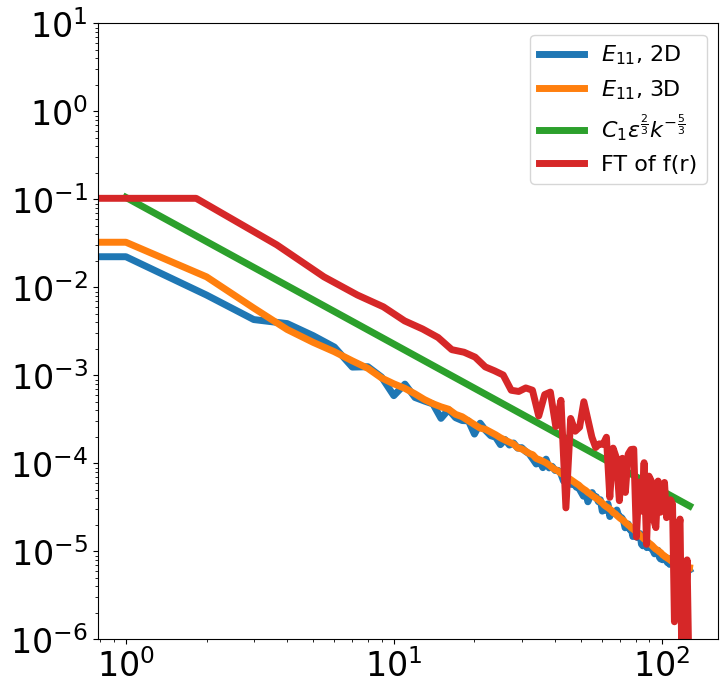

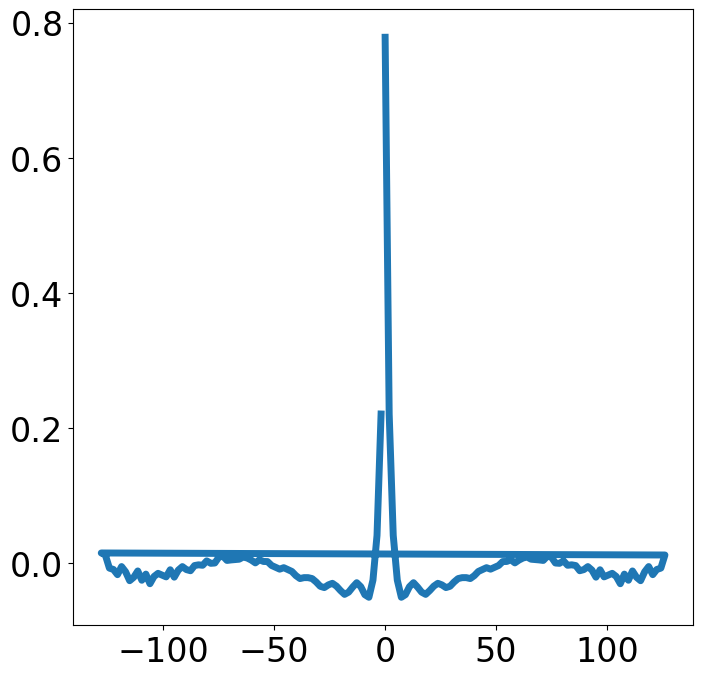

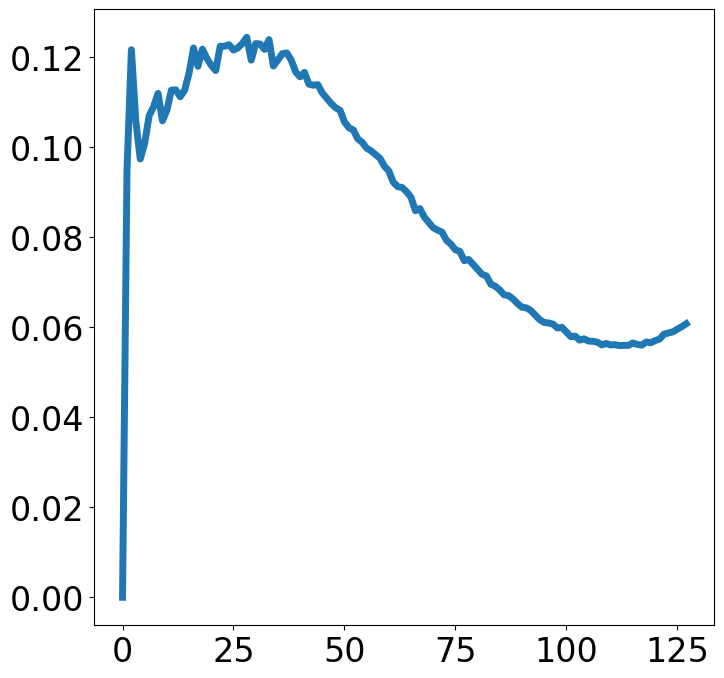

In [21]:
reload(vel)
epsilon=[0.10]

(e11s_2d, e22s_2d), err_2d, k1_2d = vel.get_1d_energy_spectrum(udata[:2, ..., z, :], dx=dx, dy=dy, dz=dz)
(e11s, e22s, e33s), err, k1 = vel.get_1d_energy_spectrum(udata, dx=dx, dy=dy, dz=dz)
fig2, ax2 = graph.plot(k1, e11s_2d[:, 0], fignum=2, label='$E_{11}$, 2D')
# fig2, ax2 = graph.plot(k1, e22s_2d[:, 0], fignum=2, label='$E_{22}$, 2D')
fig2, ax2 = graph.plot(k1, e11s[:, 0], fignum=2, label='$E_{11}$, 3D')
# fig2, ax2 = graph.plot(k1, e22s[:, 0], fignum=2, label='$E_{22}$, 3D')
# fig2, ax2 = graph.plot(k1, e33s[:, 0], fignum=2, label='$E_{33}$, 3D')

fig2, ax2 = graph.plot(k1, vel.kolmogorov_53_uni(k1, epsilon[0], c=0.49), fignum=2, 
                       label='$ C_1 \\epsilon^{\\frac{2}{3} } k^{-\\frac{5}{3}}$')
graph.tologlog(ax2)



# FT of longitudinal autocorrelation
n = fs_2d.shape[0]

#2D (symmetric function)
Fs_2d = np.empty((2*n, 1))
Fs_2d[n:, 0] = fs_2d[:, 0]
Fs_2d[:n, 0] = np.flip(fs_2d[:, 0])
fk = np.fft.fft(Fs_2d, axis=0)[:, 0].real
ks = np.fft.fftfreq(2*n, d=dx) * 2 * np.pi
# 2D (Only positive)
# fk = np.fft.fft(fs_2d, axis=0)[:n // 2, 0]
# ks = np.fft.fftfreq(n, d=dx)[:n // 2] * 2 * np.pi  # shape=(n, duration)

#3D (symmetric function)
Fs_3d = np.empty((2*n, 1))
Fs_3d[n:, 0] = fs[:, 0]
Fs_3d[:n, 0] = np.flip(fs[:, 0])
Fs_3d[:n, 0] = np.flip(fs[:, 0])

uirms = vel.get_characteristic_velocity(udata)
fk = np.abs(np.fft.fft(Fs_3d, axis=0)[:, 0].real) / n
e11_via_fr = fk * uirms[0]**2 / np.pi * 2 # E11
ks = np.fft.fftfreq(2*n, d=dx) * 2 * np.pi


fig3, ax3 = graph.plot(ks, e11_via_fr, fignum=2, label='FT of f(r)')


from scipy.integrate import simps
integral_values = []
for k in ks:
    integrand = fs_2d[:, 0] * np.cos(k * rrs_2d[:, 0])
    value = simps(integrand, x=rrs_2d[:, 0] )
    integral_values.append(value)
    
fig3, ax3 = graph.plot(ks, integral_values, fignum=4, label='FT of f(r)' )



ax2.legend()
ax2.set_ylim(10**-6, 10**1)

graph.plot(k1, e11s[:, 0] / vel.kolmogorov_53_uni(k1, epsilon[0]) , fignum=3)

Using tqdm_notebook. If this is a mistake, set notebook=False
0.4999999999999952 0.17677669037737725 0.3535533807547579
0.4999999999999952 0.17677669037737725 0.3535533807547579
Using tqdm_notebook. If this is a mistake, set notebook=False
0.4999999999999952 0.17677669037737725 0.3535533807547579
0.4999999999999952 0.17677669037737725 0.3535533807547579
Using tqdm_notebook. If this is a mistake, set notebook=False
7.999999999999924 2.828427046038036 0.3535533807547579
7.999999999999924 2.828427046038036 0.3535533807547579
Using tqdm_notebook. If this is a mistake, set notebook=False
7.999999999999924 2.828427046038036 0.3535533807547579
7.999999999999924 2.828427046038036 0.3535533807547579
Using tqdm_notebook. If this is a mistake, set notebook=False
0.5000000000000023 0.707106761509509 1.4142135230190114
0.5000000000000023 0.707106761509509 1.4142135230190114
Using tqdm_notebook. If this is a mistake, set notebook=False
0.5000000000000023 0.707106761509509 1.4142135230190114
0.500000

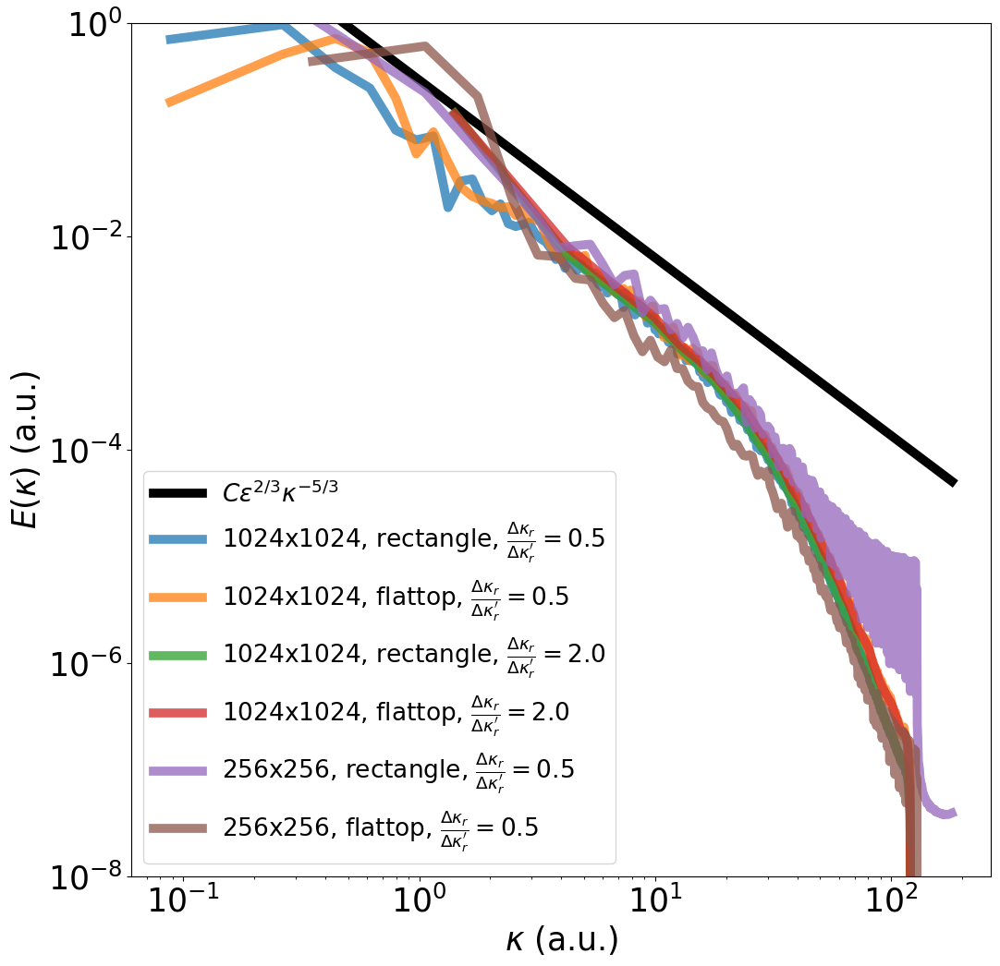

In [253]:
reload(vel)
import library.basics.formatarray as fa
__fontsize__ = 25
__figsize__ = (12, 12)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':19, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 7}
graph.update_figure_params(params)

cc = 1.75
energy = vel.get_energy(udata_test)

fig, ax = graph.plot(k[:, 0], vel.kolmogorov_53_uni(k[:, 0], 0.085, c=1.5),
                     color='k', label='$C \epsilon^{2/3} \kappa^{-5/3}$', fignum=1)

ek, _, k = vel.get_energy_spectrum(udata_test, dx=dx, dy=dy, nkout=1024, remove_undersampled_region=False, cc=cc)
ek_w, _, k_w = vel.get_energy_spectrum(udata_test, dx=dx, dy=dy, nkout=1024, remove_undersampled_region=False, window='flattop', cc=cc)

ek2, _, k2 = vel.get_energy_spectrum(udata_test, dx=dx, dy=dy, nkout=64, remove_undersampled_region=False, cc=cc)
ek2w, _, k2w = vel.get_energy_spectrum(udata_test, dx=dx, dy=dy, nkout=64, remove_undersampled_region=False, window='flattop', cc=cc)

ek3, _, k3 = vel.get_energy_spectrum(udata_test, x1=256, y1=256, dx=dx, dy=dy, nkout=256, remove_undersampled_region=False, cc=cc)
ek3w, _, k3w = vel.get_energy_spectrum(udata_test, x1=256, y1=256, dx=dx, dy=dy, nkout=256, remove_undersampled_region=False, window='flattop', cc=cc)


fig, ax = graph.plot(k[:, 0], ek[:, 0], alpha=0.75, label='1024x1024, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
fig, ax = graph.plot(k_w[:, 0], ek_w[:, 0], alpha=0.75, label='1024x1024, flattop, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
fig, ax = graph.plot(k2[:, 0], ek2[:, 0], alpha=0.75, label='1024x1024, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=2.0$')
fig, ax = graph.plot(k2w[:, 0], ek2w[:, 0], alpha=0.75, label='1024x1024, flattop, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=2.0$')
fig, ax = graph.plot(k3[:, 0], ek3[:, 0], alpha=0.75, label='256x256, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
fig, ax = graph.plot(k3w[:, 0], ek3w[:, 0], alpha=0.75, label='256x256, flattop, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
graph.labelaxes(ax, '$\kappa$ (a.u.)', '$E(\kappa)$ (a.u.)')
graph.tologlog(ax)
ax.set_ylim(10**-8, 10**0)
ax.legend(loc=3)

Using tqdm_notebook. If this is a mistake, set notebook=False
0.12500000000000058 0.2165063449212717 1.7320507593701653
Using tqdm_notebook. If this is a mistake, set notebook=False
0.12500000000000058 0.2165063449212717 1.7320507593701653
Using tqdm_notebook. If this is a mistake, set notebook=False
2.0000000000000093 3.464101518740347 1.7320507593701653
Using tqdm_notebook. If this is a mistake, set notebook=False
2.0000000000000093 3.464101518740347 1.7320507593701653
Using tqdm_notebook. If this is a mistake, set notebook=False
0.5000000000000023 0.8660253796850867 1.7320507593701653
Using tqdm_notebook. If this is a mistake, set notebook=False
0.5000000000000023 0.8660253796850867 1.7320507593701653


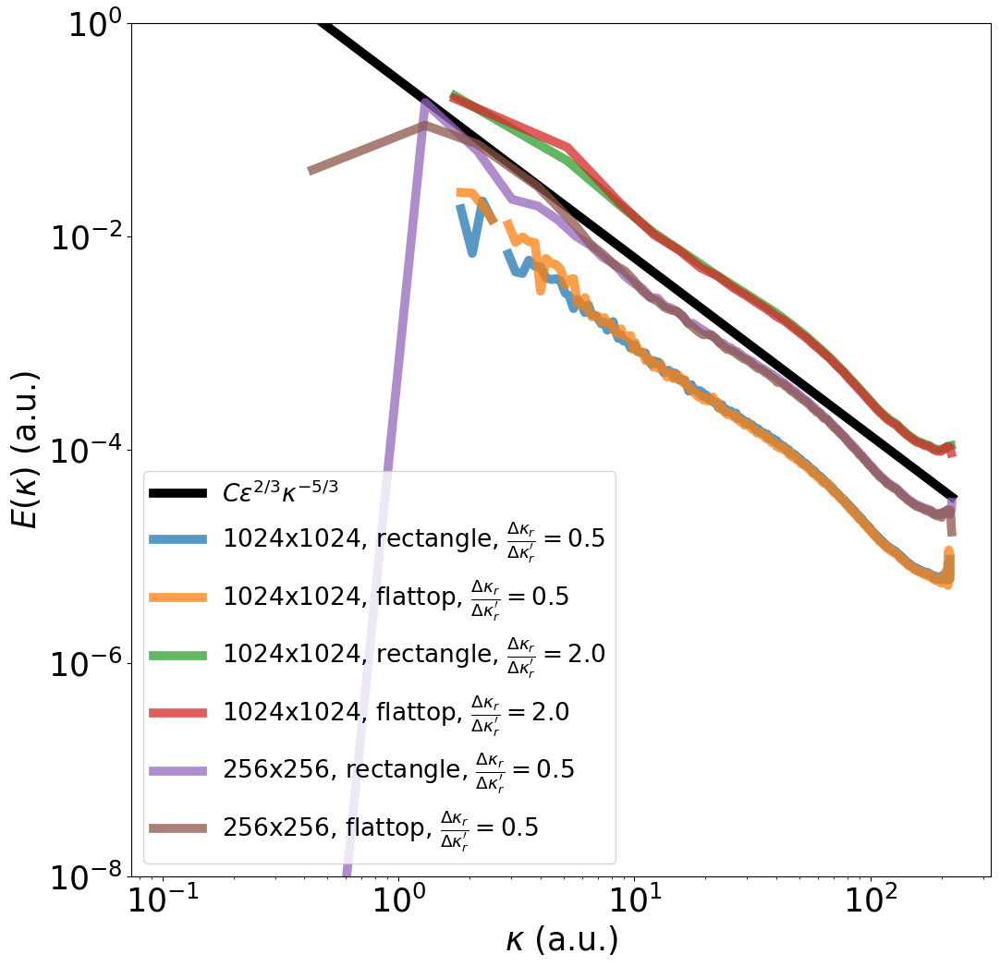

In [256]:
reload(vel)
cc = 1.75
energy = vel.get_energy(udata_test)

fig, ax = graph.plot(k[:, 0], vel.kolmogorov_53_uni(k[:, 0], 0.085, c=1.5),
                     color='k', label='$C \epsilon^{2/3} \kappa^{-5/3}$', fignum=1)

ek, _, k = vel.get_energy_spectrum(udata, dx=dx, dy=dy, dz=dz, nkout=1024, remove_undersampled_region=False, cc=cc)
ek_w, _, k_w = vel.get_energy_spectrum(udata, dx=dx, dy=dy, dz=dz, nkout=1024, remove_undersampled_region=False, window='flattop', cc=cc)

ek2, _, k2 = vel.get_energy_spectrum(udata, dx=dx, dy=dy, dz=dz, nkout=64, remove_undersampled_region=False, cc=cc)
ek2w, _, k2w = vel.get_energy_spectrum(udata, dx=dx, dy=dy, dz=dz, nkout=64, remove_undersampled_region=False, window='flattop', cc=cc)

ek3, _, k3 = vel.get_energy_spectrum(udata, dx=dx, dy=dy, dz=dz, x1=256, y1=256, nkout=256, remove_undersampled_region=False, cc=cc)
ek3w, _, k3w = vel.get_energy_spectrum(udata, dx=dx, dy=dy, dz=dz, x1=256, y1=256, nkout=256, remove_undersampled_region=False, window='flattop', cc=cc)


fig, ax = graph.plot(k[:, 0], ek[:, 0], alpha=0.75, label='1024x1024, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
fig, ax = graph.plot(k_w[:, 0], ek_w[:, 0], alpha=0.75, label='1024x1024, flattop, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
fig, ax = graph.plot(k2[:, 0], ek2[:, 0], alpha=0.75, label='1024x1024, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=2.0$')
fig, ax = graph.plot(k2w[:, 0], ek2w[:, 0], alpha=0.75, label='1024x1024, flattop, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=2.0$')
fig, ax = graph.plot(k3[:, 0], ek3[:, 0], alpha=0.75, label='256x256, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
fig, ax = graph.plot(k3w[:, 0], ek3w[:, 0], alpha=0.75, label='256x256, flattop, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
graph.labelaxes(ax, '$\kappa$ (a.u.)', '$E(\kappa)$ (a.u.)')
graph.tologlog(ax)
ax.set_ylim(10**-8, 10**0)
ax.legend(loc=3)

In [128]:
energy = vel.get_energy(udata2d)
ek2d, ks = vel.get_energy_spectrum_nd(udata2d, dx=dx, dy=dy)
print('Check Parseval theorem: ',  np.sum(energy[..., 0]), np.sum(ek2d[..., 0]))


energy = vel.get_energy(udata)
ek3d, ks = vel.get_energy_spectrum_nd(udata, dx=dx, dy=dy, dz=dz)
print('Check Parseval theorem: ',  np.sum(energy[..., 0]), np.sum(ek3d[..., 0]))




Check Parseval theorem:  32018.6345712979 32018.636350159773
Check Parseval theorem:  11454227.845276423 11454228.801425604


29.28408130764752


/Users/takumi/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:795: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/Users/takumi/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:795: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/Users/takumi/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:795: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/Users/takumi/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:795: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/Users/takumi/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:795: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/Users/takumi/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:795: OptimizeWarning: 

((1024, 1024, 2, 2, 3, 3), (3, 1024, 1024, 2, 2))

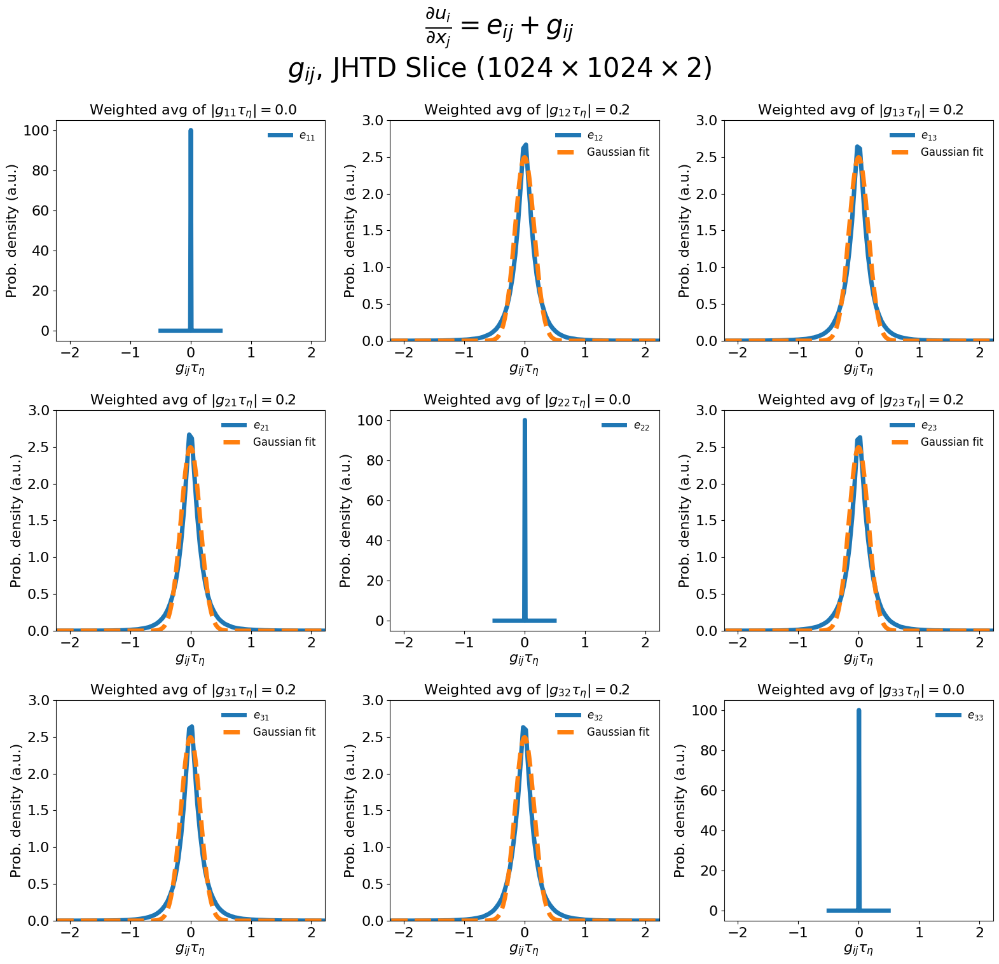

In [190]:
reload(graph)
tau_L = 2.02 # Large-eddy turnover time(JHTD Doc)
tau_eta =0.0446
tau = tau_eta

# vdata, xx1, yy1, zz1 = vel.get_sample_turb_field_3d()
# sij = vel.get_duidxj_tensor(vdata, xx=xx1, yy=yy1, zz=zz1) # Rate-of-strain tensor
eij, gij = vel.decompose_duidxj(sij) # Symmetric and asymmetric components

divergence = vel.div(udata, xx=xx1, yy=yy1, zz=zz1)
print(np.sqrt(np.nanmean(divergence ** 2)))

# Symmetric part
counter = 0
axes = []
for i in range(3):
    for j in range(3):
        counter += 1
        fig1, ax, bins, hist = graph.pdf(gij[:, :, :, 0, i, j] * tau, nbins=100, fignum=1, subplot=330+counter, 
                               label='$e_{%d %d}$' % (i+1,j+1), 
                               vmin=-50 * tau, vmax=50 * tau,
                               return_data = True,
                               figsize=(16, 16))
        uij_rms = np.nansum(np.abs(bins*hist)) / np.nansum(hist)
        graph.title(ax, ' Weighted avg of $|g_{%d %d} \\tau_\eta| = %.1f$' % (i+1, j+1, uij_rms))
        if i!=j:
            graph.plot_fit_curve(bins, hist, func=gaussian_norm, p0=[0, 0.16], ax=ax, label='Gaussian fit')
        axes.append(ax)

for i, ax in enumerate(axes):
#     graph.tosemilogy(ax)
    ax.legend(frameon=False)
    graph.labelaxes(ax, '$g_{ij} \\tau_\eta$ ', 'Prob. density (a.u.)')
    ax.set_xlim(-50*tau, 50*tau)
    if i in [1, 2, 3, 5, 6, 7]:
#         ax.set_ylim(10**-4, 10**0.9)# semilog
        ax.set_ylim(0, 3)# linear
graph.suptitle('$\\frac{\partial u_i}{\partial x_j} = e_{ij} + g_{ij}$ \n$g_{ij}$, JHTD Slice ($1024 \\times 1024\\times 2$)', 
               rect=[0, 0.03, 1, 0.9], fontsize=30)

gij.shape, vdata.shape

45.2914798206278


/Users/takumi/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:795: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/Users/takumi/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:795: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


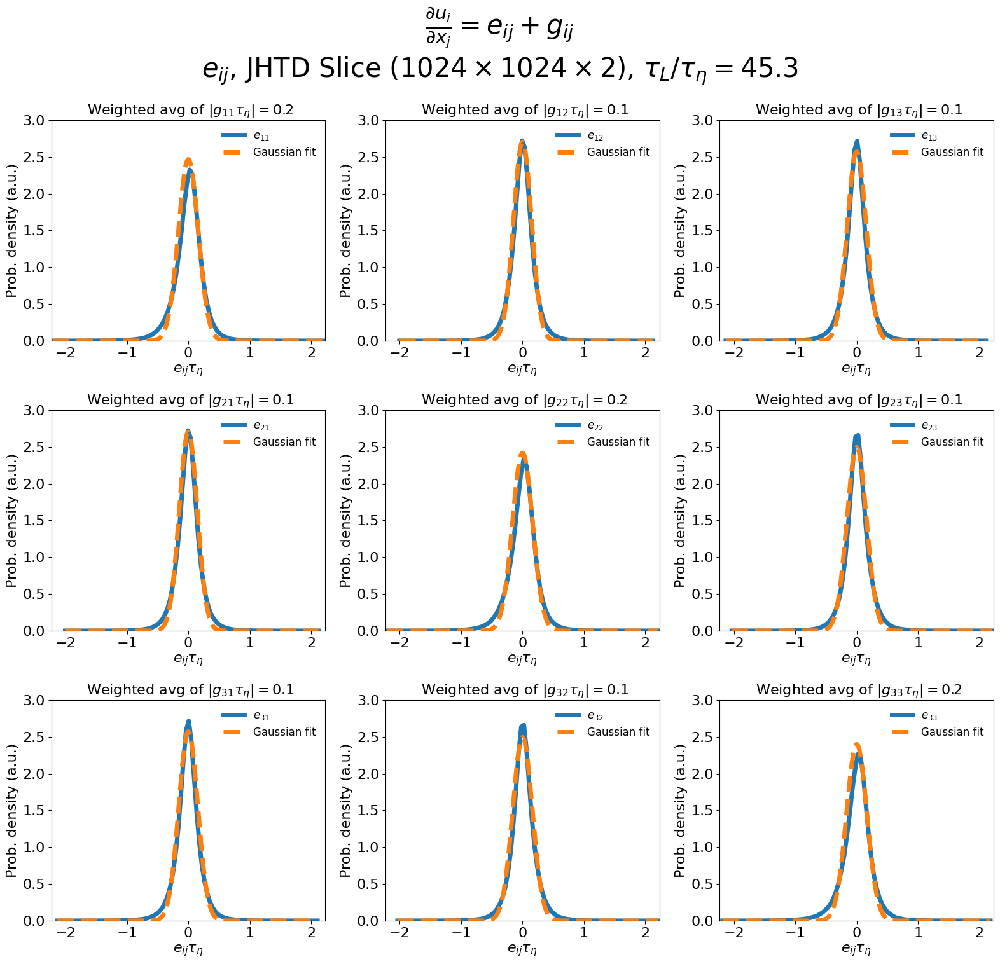

In [186]:
reload(vel)
def lorentzian_norm(x, x0, gamma):
    """1. / np.pi * gamma / ((x-x0)**2 + gamma ** 2)"""
    return 1. / np.pi * gamma / ((x-x0)**2 + gamma ** 2)
def gaussian_norm(x, x0, sigma):
    """ 1. / (np.sqrt(2 * np.pi * sigma ** 2.)) * np.exp(- (x - x0) ** 2. / (2. * sigma ** 2.)) """
    return 1. / (np.sqrt(2 * np.pi * sigma ** 2.)) * np.exp(- (x - x0) ** 2. / (2. * sigma ** 2.))

# divergence = vel.div(udata, xx=xx1, yy=yy1, zz=zz1)
# print(np.sqrt(np.nanmean(divergence ** 2)))
tau_L = 2.02 # Large-eddy turnover time(JHTD Doc)
tau_eta =0.0446
tau = tau_eta
print(tau_L / tau_eta)
# Symmetric part
counter = 0
axes = []
for i in range(3):
    for j in range(3):
        counter += 1
        fig1, ax, bins, hist = graph.pdf(eij[:, :, :, 0, i, j] * tau, nbins=100, fignum=1, subplot=330+counter, 
                               label='$e_{%d %d}$' % (i+1,j+1), 
                               vmin=-50 * tau, vmax=50 * tau,
                               return_data = True,
                               figsize=(16, 16))
        uij_rms = np.nansum(np.abs(bins*hist)) / np.nansum(hist)
        graph.title(ax, ' Weighted avg of $|g_{%d %d} \\tau_\eta| = %.1f$' % (i+1, j+1, uij_rms))
        graph.plot_fit_curve(bins, hist, func=gaussian_norm, p0=[0, 0.16], ax=ax, label='Gaussian fit')
        axes.append(ax) 


for ax in axes:
#     graph.tologlog(ax)
    ax.legend(frameon=False)
    graph.labelaxes(ax, '$e_{ij} \\tau_\eta$ ', 'Prob. density (a.u.)')
    ax.set_xlim(-50* tau, 50* tau)
#     ax.set_ylim(10**-6.5, 10**1) #semilog/loglog
    ax.set_ylim(0, 3) #linear
    
#     p = np.linspace(0, 40)
#     slope=-0.3
#     graph.plot(p, np.exp(slope * p), linestyle=':', ax=ax)
graph.suptitle('$\\frac{\partial u_i}{\partial x_j} = e_{ij} + g_{ij}$ \n$e_{ij}$, JHTD Slice ($1024 \\times 1024\\times 2$), $\\tau_L / \\tau_\eta = 45.3$', 
               rect=[0, 0.03, 1, 0.9], fontsize=30)


In [154]:
2*np.pi / 1024/0.00287

2.1379523176106496

# Generate a v-field with a spectrum of your choice

band_limited_noise2d():: this function may give a noise with a different f-dependence 
 The deviation depends on nsamples, samplerate, therefore, is difficult to generalize. 
 It should work for nsamples=1024, samplerate=1, exponent=[-7.5, 0]
band_limited_noise2d():: this function may give a noise with a different f-dependence 
 The deviation depends on nsamples, samplerate, therefore, is difficult to generalize. 
 It should work for nsamples=1024, samplerate=1, exponent=[-7.5, 0]
Using tqdm_notebook. If this is a mistake, set notebook=False



deltaf, nsamples, d 0.016583747927031434 201 0.3000000000000007
dx, 1/deltaf/n 0.3000000000000007 0.3000000000000014
Parseval (ux) 0.9999999999999999
Parseval (uy) 1.0


(1e-07, 10.0)

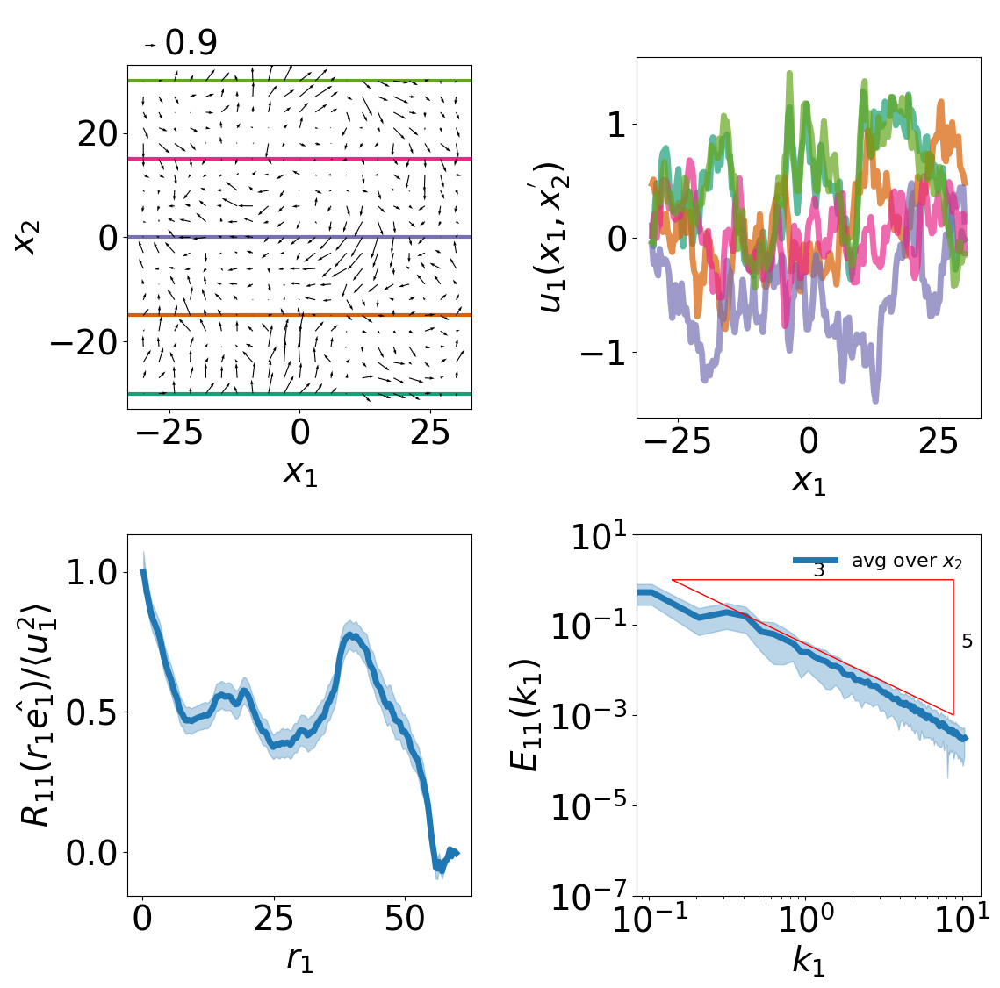

In [5]:
# Plotting settings
import tflow.velocity as vel
import tflow.graph as graph # if you are using ilpm, use ilpm.graph
__fontsize__ = 28
__figsize__ = (12, 12)
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize': 16, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
          'lines.linewidth': 5}
# graph.show_plot_styles()
graph.use_plot_style('default')
graph.update_figure_params(params)

# nice function
def inspectE11(vdata, xx, yy, y0=0, y1=None, expInd_loc=[1e-1, 8e-1], exponent=-4, expInd_kwargs={'w':1.5}, plotEachRow=False, inc=10):
    dx, dy = vel.get_grid_spacing(xx, yy)
    # plots the v-field
    vdata = vel.fix_udata_shape(vdata)
    # rrs, fs, f_errs, rrs, gs, g_errs = vel.get_two_point_vel_corr(vdata, xx, yy, )
    r1, corr1, corrErr1 = vel.get_two_point_vel_corr_roll(vdata[0, ...], xx, yy,  coarse=1., coarse2=1., y0=0, y1=1, )

    (e11, e22), (e11_err, e22_err), k11 = vel.get_1d_energy_spectrum(vdata, dx=dx, dy=dy, window=None, y0=y0, y1=y1)    
    

    fig, ax11, _ = graph.quiver(xx, yy, vdata[0, ..., 0], vdata[1, ..., 0], inc=inc, fignum=1, subplot=221, key_units='')
    
    fig, ax14, _ = graph.errorfill(k11, e11[..., 0], e11_err[:, 0], fignum=1, subplot=224, label='avg over $x_2$')
    # ux at different y
    graph.set_color_cycle('Dark2')
    colors = graph.get_color_from_cmap('Dark2', n=8)
    for i, y0 in enumerate(range(vdata.shape[1])[::int(vdata.shape[1]/4)]):
#         fig, ax12 = graph.scatter(xx[y0, :], vdata[0, y0, :, 0], fignum=1, subplot=222, s=8)
        fig, ax12 = graph.plot(xx[y0, :], vdata[0, y0, :, 0], fignum=1, subplot=222, alpha=0.7)
        graph.axhline(ax11, yy[y0, 0], linewidth=3, linestyle='-', color=colors[i])
        if plotEachRow:
            (e11, e22), (e11_err, e22_err), k11 = vel.get_1d_energy_spectrum(vdata, dx=dx, dy=dy, window=None, y0=y0, y1=y0+1)
            fig, ax14 = graph.plot(k11, e11[..., 0], fignum=1, subplot=224, color=colors[i])

    graph.set_color_cycle('tab10')
    # fig, ax13 = graph.plot(r1[:, 0], corr1[:,0] , fignum=1, subplot=223,  set_bottom_zero=True)
    fig, ax13, _ = graph.errorfill(r1[:, 0], corr1[:,0] , corrErr1[:, 0], fignum=1, subplot=223,)
#     fig, ax14 = graph.plot(k11, e11[..., 0], fignum=1, subplot=224)
    graph.tologlog(ax14)

    graph.labelaxes(ax11, '$x_1$', '$x_2$')
    graph.labelaxes(ax12, '$x_1$', '$u_1(x_1, x_2^{\'})$')
    graph.labelaxes(ax13, '$r_1$', '$R_{11}(r_1\hat{e_1}) / \langle u_1^2 \\rangle$')
    graph.labelaxes(ax14, '$k_1$', '$E_{11}(k_1)$')


    # Also plot FT of the autocorrelation function Rxx
    # t=r1[:, 0]
    # gt = corr1[:, 0]*np.nanmean(vdata[0, ...]**2)

    # gf_dft = vel.fft_1d(gt)
    # gf = vel.FFTOutput2CFTOutput_1d(gf_dft, t)
    # print(np.nansum(gt**2), np.nansum(np.abs(gf_dft)**2)/len(gt))
    # gf, f = vel.fourier_transform_1d(gt, 1/(t[1]-t[0]), t[0], return_freq=True, )
    # print(np.trapz(gt**2, t), np.trapz(np.abs(gf)**2, f))
    # graph.plot(2*np.pi* f, 1/(2*np.pi)*np.abs(gf), ax=ax14, label='FT of $R_{11}(r\hat{x_1})$\nDFT->CFT Approx')
#     ax14.legend(frameon=False)
    if exponent!=0:
        graph.draw_power_triangle(ax14, expInd_loc[0], expInd_loc[1], exponent, **expInd_kwargs)
    ax14.legend(frameon=False)
    fig.tight_layout()
    return fig, (ax11, ax12, ax13, ax14)

# vdata
L, N = 30, 201
exponent=-5/3.
vdata, xx, yy = vel.generate_sample_field(L, N, exponent=exponent, mag=1e4)
fig, axes = inspectE11(vdata, xx, yy, 
                       plotEachRow=False, inc=10, 
                       expInd_loc=[1.4e-1, 1e0], exponent=exponent, expInd_kwargs={'w':1.8, 'flip':False})
axes[3].set_ylim(1e-7, 1e1)

# Test space

In [473]:
## Fourier Transform Demo

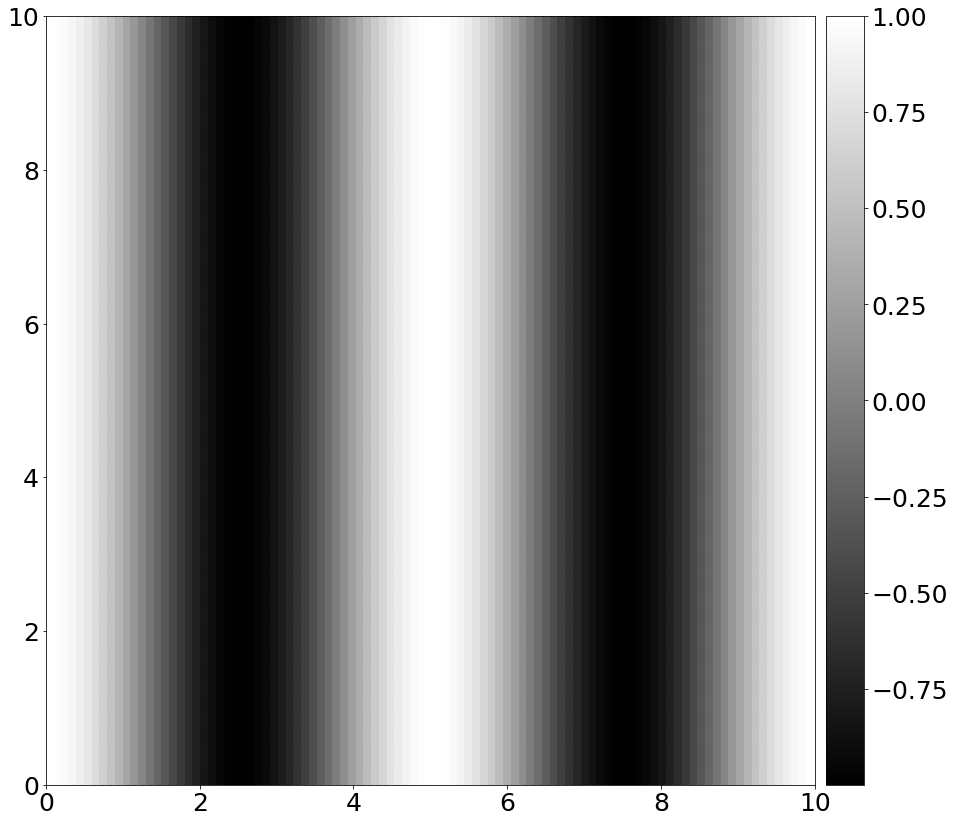

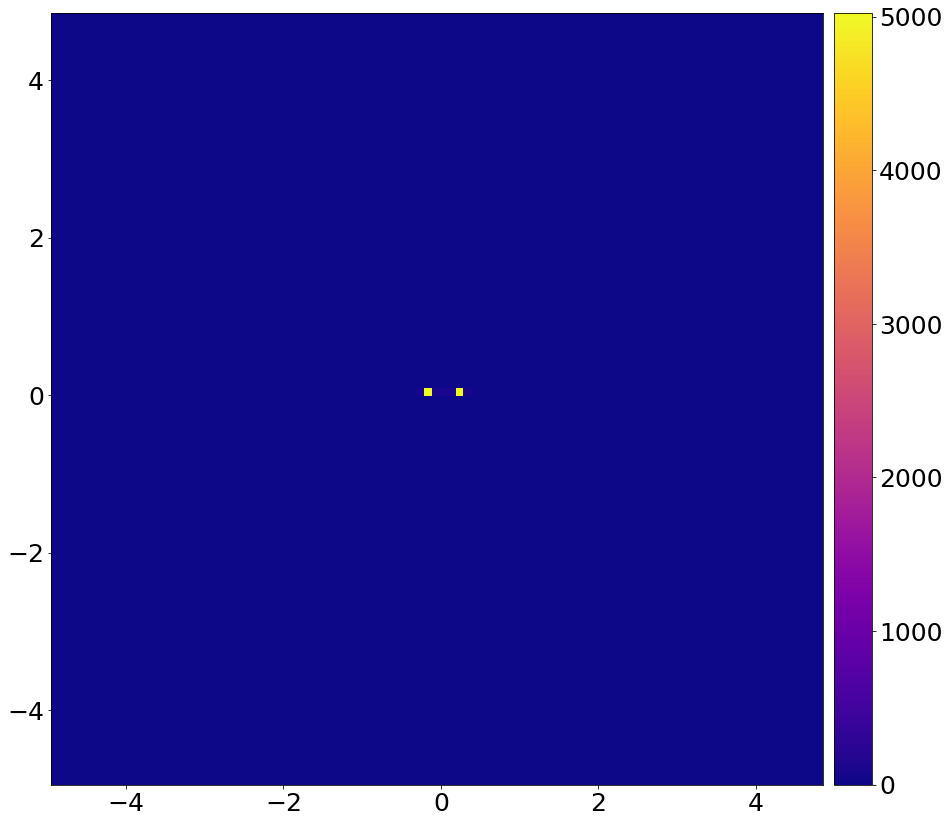

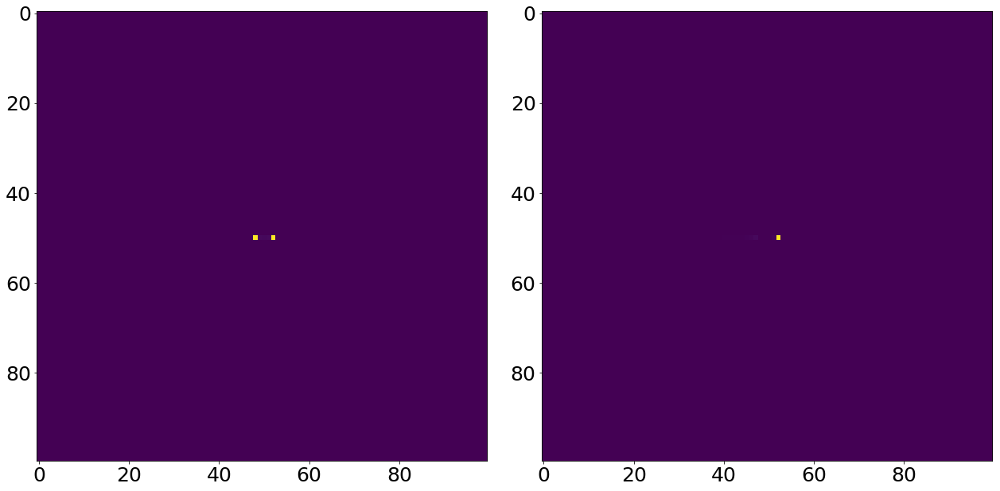

In [496]:
reload(vel)
N = 100 # number of samples per axis
L = 10 # px... sample domain size
x = np.linspace(0, L, N)
y = np.linspace(0, L, N)
xx, yy = np.meshgrid(x, y)

kx0 = 2 * np.pi / L * 2
ky0 = 0
e = np.cos(kx0 * xx + ky0 * yy)
e = e.reshape((e.shape[0], e.shape[1], 1))

# plt.figure()
# plt.imshow(e[..., 0], cmap='gray')
# plt.colorbar()
fig1, ax1, cc1 = graph.color_plot(xx, yy, e[..., 0], cmap='gray')
graph.add_colorbar(cc1, ax=ax1)

#########
kx = np.fft.fftfreq(N,d=x[1]-x[0])
ky = np.fft.fftfreq(N,d=y[1]-y[0])
kx = np.fft.fftshift(kx)
ky = np.fft.fftshift(ky)
kxx, kyy = np.meshgrid(kx, ky)

e_fft = np.fft.fftn(e, axes=(0,1))
e_fft_shift = np.fft.fftshift(e_fft, axes=(0,1))
fig2, ax2, cc2 = graph.color_plot(kxx, kyy, np.abs(e_fft_shift[..., 0]), cmap='plasma', fignum=2)
graph.add_colorbar(cc2, ax=ax2)

fig, (ax1, ax22) = plt.subplots(nrows=1, ncols=2)
ax1.imshow(e_fft_shift[:, :, 0].real, vmin=0)
ax22.imshow(e_fft_shift[:, :, 0].imag, vmin=0)
fig.tight_layout()


Is sampling theorem satisfied?  True
100.0 15.9154943092
6.28318530718 0.990000000000002 0.990000000000002


(<matplotlib.figure.Figure at 0x13a4d6c10>,
 <matplotlib.collections.QuadMesh at 0x13adfaed0>)

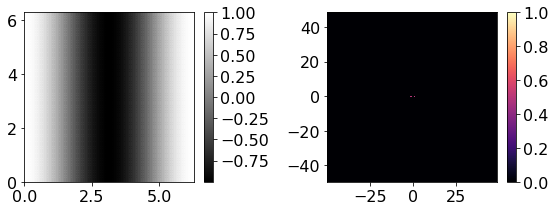

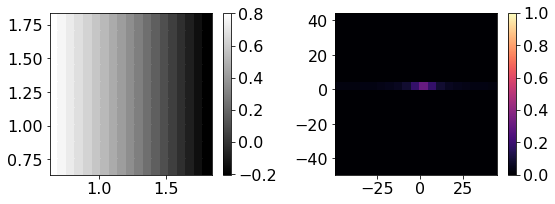

In [699]:
reload(graph)
def get_kgrid(zz, dx, dy):
    # k space grid
    height, width = zz.shape
    kx = np.fft.fftfreq(width, d=dx)  # this returns FREQUENCY (JUST INVERSE LENGTH) not ANGULAR FREQUENCY
    ky = np.fft.fftfreq(height, d=dy)
    kx = np.fft.fftshift(kx)
    ky = np.fft.fftshift(ky)
    kxx, kyy = np.meshgrid(kx, ky)
    kxx, kyy = kxx * 2 * np.pi, kyy * 2 * np.pi # Convert inverse length into wavenumber
    return kxx, kyy
    

N = 100 # number of samples per axis
L = 2 * np.pi # sample domain size
f_sampling = float(N) / L
k_sampling = 2*np.pi * f_sampling# sampling frequency
k = 1
print "Is sampling theorem satisfied? ", k_sampling >= 2 * k
print k_sampling, f_sampling
x = np.linspace(0, L, N)
y = np.linspace(0, L, N)
dx, dy = x[1] - x[0], y[1] - y[0]
xx, yy = np.meshgrid(x, y)
zz = np.cos(k * xx)# fast mode
period = 2*np.pi/k
graph.color_plot(xx, yy, zz, cmap='gray', subplot=121, cbar=True)

zz_fft = np.fft.fftn(zz, axes=(0, 1))
zz_fft = np.fft.fftshift(zz_fft)
n_samples = zz.size
zz_fft /= float(n_samples)

# k space grid
kxx, kyy = get_kgrid(zz, dx, dy)
print period, kxx[0, 1] - kxx[0, 0], kyy[1, 0]- kyy[0, 0]
graph.color_plot(kxx, kyy, np.abs(zz_fft), subplot=122, cbar=True, vmin=0, vmax=1)


# now crop area
x0, x1, y0, y1 = 10, 30, 10, 30
xx_c, yy_c, zz_c = xx[y0:y1, x0:x1], yy[y0:y1, x0:x1], zz[y0:y1, x0:x1]
zz_fft_c = np.fft.fftn(zz_c, axes=(0, 1))
zz_fft_c = np.fft.fftshift(zz_fft_c)
n_samples = zz_fft_c.size
zz_fft_c /= float(n_samples)
kxx, kyy = get_kgrid(zz_c, dx, dy)
graph.color_plot(xx_c, yy_c, zz_c, fignum=2, cmap='gray', subplot=121, cbar=True)
graph.color_plot(kxx, kyy, np.abs(zz_fft_c), fignum=2, subplot=122, cbar=True, vmin=0, vmax=1)


Is sampling theorem satisfied?  True
200.0 31.8309886184
period, deltak:  0.628318530718 0.9950000000000188


(<matplotlib.figure.Figure at 0x14be7cd50>,
 <matplotlib.axes._subplots.AxesSubplot at 0x14be93790>)

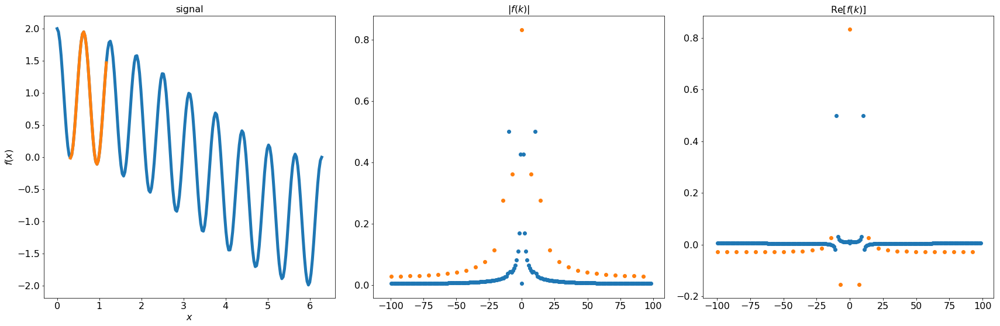

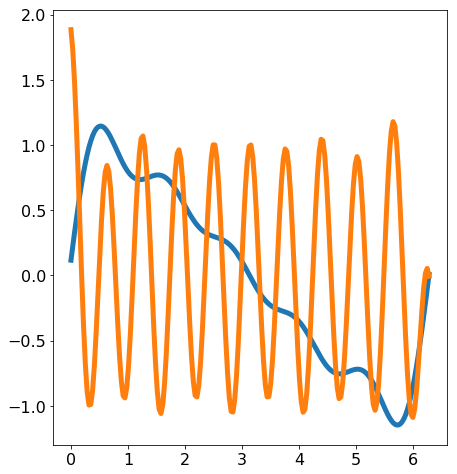

In [732]:
def get_k(z, dx):
    k = np.fft.fftfreq(len(z), d=dx)
    k = np.fft.fftshift(k)
    k *=2*np.pi
    return k

N = 200 # number of samples per axis
L = 2 * np.pi # sample domain size
f_sampling = float(N) / L
k_sampling = 2*np.pi * f_sampling# sampling frequency
k, k_ls = 10, 0.5
print "Is sampling theorem satisfied? ", k_sampling >= 2 * k
print k_sampling, f_sampling
x = np.linspace(0, L, N)
dx = x[1] - x[0]
z = np.cos(k * x) + np.cos(k_ls * x)# fast mode + slow mode
period = 2*np.pi/k
graph.plot(x, z, subplot=131)

z_fft = np.fft.fft(z)
z_fft = np.fft.fftshift(z_fft)
n_samples = z.size
z_fft /= float(n_samples)

# k space grid
k = get_k(z, dx)
print 'period, deltak: ', period, k[1]-k[0]
graph.scatter(k, np.abs(z_fft), subplot=132)
graph.scatter(k, z_fft.real, subplot=133)

# now crop area
x0, x1= 10, 38
x_c, z_c = x[x0:x1], z[x0:x1]
fig, ax = graph.plot(x_c, z_c, subplot=131)
z_fft_c = np.fft.fft(z_c)
z_fft_c = np.fft.fftshift(z_fft_c)
n_samples_c = z_fft_c.size
z_fft_c /= float(n_samples_c)
k_c = get_k(z_c, dx)
fig, ax2 = graph.scatter(k_c, np.abs(z_fft_c), subplot=132)
fig, ax3 = graph.scatter(k_c, z_fft_c.real, subplot=133, figsize=(24, 8))

graph.title(ax, 'signal')
graph.title(ax2, '$|f(k)|$')
graph.title(ax3, 'Re$[f(k)]$')
graph.labelaxes(ax, '$x$', '$f(x)$')



fig.tight_layout()

# low pass (get large scale motion)
z_fft[np.abs(k) > 5] = 0 # 
z_fft = np.fft.ifftshift(z_fft) * n_samples
z_i = np.fft.ifft(z_fft) # inverse fft
graph.plot(x, z_i, fignum=2, subplot=131, figsize=(24, 8), label='large_scale motion')

graph.plot(x, z-z_i, fignum=2, subplot=131, figsize=(24, 8), label='original-large_scale motion')

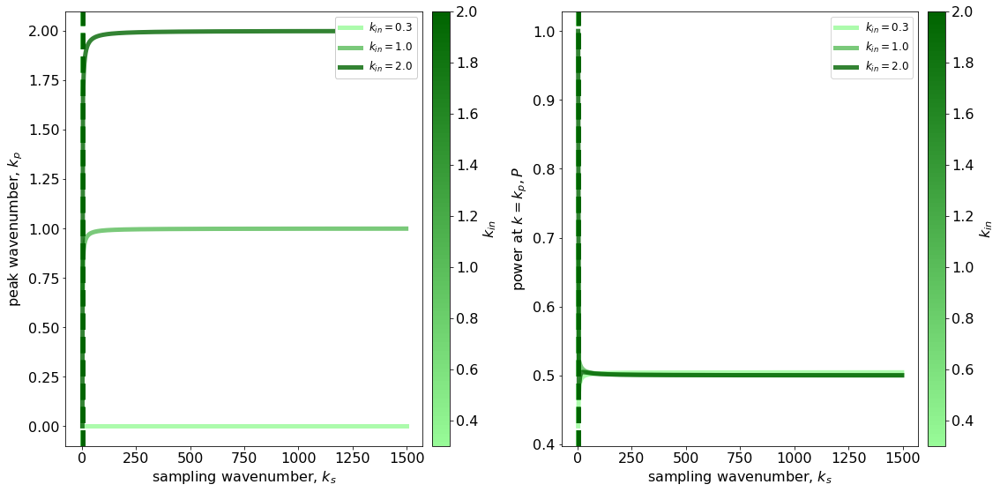

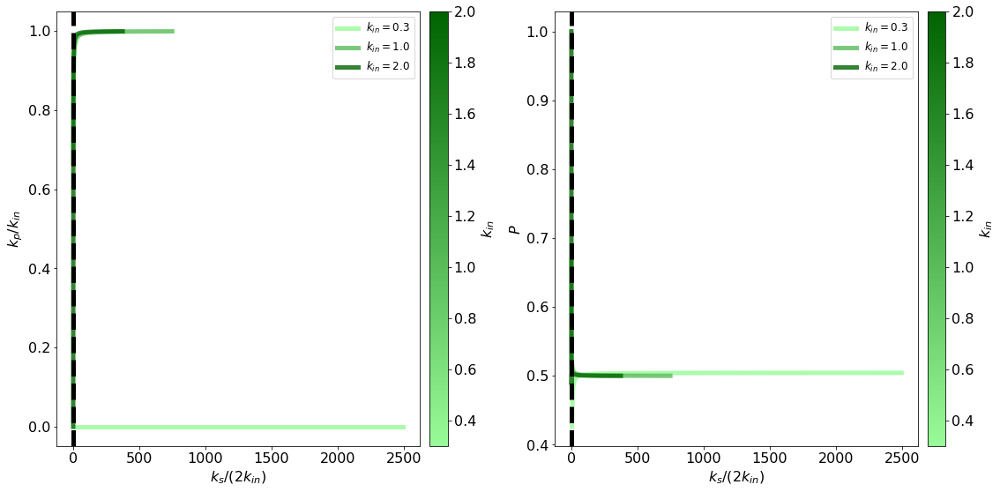

In [1304]:
reload(graph)
def get_k(z, dx):
    k = np.fft.fftfreq(len(z), d=dx)
    k = np.fft.fftshift(k)
    k *=2*np.pi
    return k

Nmax = 1500 # number of samples per axis
Ns = np.arange(0, Nmax, 3)[1:]
# Ns = [100]
ks = [0.3, 1., 2]
L = 2 * np.pi # sample domain size

# colors = graph.get_first_n_colors_from_color_cycle(20)
# colors = [cmap(float(k) / np.nanmax(ks)) for k in ks]
colors, cmap, sm = graph.get_colors_and_cmap_using_values(ks, color1='palegreen')
# colors = graph.get_colors_using_values(ks)
alpha=0.8
for i, k in enumerate(ks):
    ks_sampling = []
    ks_detected = []
    powers = []
    for N in Ns:
        f_sampling = float(N) / L
        k_sampling = 2*np.pi * f_sampling# sampling frequency

#         print "Is sampling theorem satisfied? ", k_sampling >= 2 * k
    #     print k_sampling, k
        x = np.linspace(0, L, N)
        dx = x[1] - x[0]
        z = np.cos(k * x)# fast mode + slow mode
        period = 2*np.pi/k
#         fig1, ax11 = graph.plot(x, z, subplot=131)


        z_fft = np.fft.fft(z)
        z_fft = np.fft.fftshift(z_fft)
        n_samples = z.size
        z_fft /= float(n_samples)

        # k space grid
        kk = get_k(z, dx)
        deltak = kk[1]-kk[0]
    #     print 'period, deltak: ', period, kk[1]-kk[0]
#         fig1, ax12 = graph.scatter(kk, np.abs(z_fft), subplot=132)
#         fig1, ax13 = graph.scatter(kk, z_fft.real, subplot=133, figsize=(24, 8))


        # insert data
    #     print fa.find_max(np.abs(z_fft)[N/2:])[0]
        ks_sampling.append(k_sampling)
        ks_detected.append(kk[N/2 + fa.find_max(np.abs(z_fft)[N/2:])[0]])
        powers.append(np.nanmax(np.abs(z_fft)[N/2:]))
        
    ks_sampling = np.asarray(ks_sampling)
    ks_detected = np.asarray(ks_detected)
    powers = np.asarray(powers)
    

    fig2, ax21 = graph.plot(ks_sampling, ks_detected, fignum=2, subplot=121, color=colors[i], alpha=alpha, label='$k_{in}=%.1f$' % k,)
    fig2, ax22 = graph.plot(ks_sampling, powers, fignum=2, subplot=122, figsize=(16, 8), color=colors[i], alpha=alpha, label='$k_{in}=%.1f$' % k,)
    graph.axvline(ax21, x=2*k, color=colors[i])
    graph.axvline(ax22, x=2*k, color=colors[i])
    graph.labelaxes(ax21, 'sampling wavenumber, $k_s$', 'peak wavenumber, $k_p$')
    graph.labelaxes(ax22, 'sampling wavenumber, $k_s$', 'power at $k=k_p, P$')
    
    
    # scale this
    fig3, ax31 = graph.plot(ks_sampling / (2*k), np.asarray(ks_detected) / k, fignum=3, subplot=121, label='$k_{in}=%.1f$' % k, color=colors[i], alpha=alpha)
    fig3, ax32 = graph.plot(ks_sampling / (2*k), np.asarray(powers), fignum=3, subplot=122, label='$k_{in}=%.1f$' % k, figsize=(16, 8), color=colors[i], alpha=alpha)
    graph.labelaxes(ax31, '$k_s / (2k_{in})$' , '$k_p / k_{in}$')
    graph.labelaxes(ax32, '$k_s / (2k_{in})$', '$P$')

graph.add_colorbar_alone(ax21, ks, cmap=cmap, label='$k_{in}$')
graph.add_colorbar_alone(ax22, ks, cmap=cmap, label='$k_{in}$')
graph.add_colorbar_alone(ax32, ks, cmap=cmap, label='$k_{in}$')
graph.add_colorbar_alone(ax31, ks, cmap=cmap, label='$k_{in}$')
graph.axvline(ax31, x=1, color='k')
graph.axvline(ax32, x=1, color='k')
# graph.setaxes(ax22, -0.1, 400, -0.1, 1.5)
# graph.setaxes(ax31, -0.1, 3, -0.1, 1.4)
# graph.setaxes(ax32, -0.1, 5, -0.1, 1.5)

ax21.legend(loc=1, framealpha=1)
ax22.legend()
ax31.legend()
ax32.legend()


# graph.labelaxes(ax11, '$x$' , 'y')
# graph.labelaxes(ax12, '$k$', 'Power')
# graph.labelaxes(ax13, '$k$', 'Re[$\mathcal{F}\{f(x) \}$]')
fig2.tight_layout()
fig3.tight_layout()


# graph.save('./DFT_sin_wave_sample', fignum=1)
# graph.save('./DFT_sin_wave_3p5pi', fignum=2)
# graph.save('./DFT_sin_wave_scaled_3p5pi',fignum=3)

In [1108]:
sm.to_rgba(1.5), sm.to_rgba(1), sm.to_rgba([0, 0.5, 1])

((0.596078431372549, 0.984313725490196, 0.596078431372549, 1.0),
 (0.596078431372549, 0.984313725490196, 0.596078431372549, 1.0),
 array([[0.59607843, 0.98431373, 0.59607843, 1.        ],
        [0.59607843, 0.98431373, 0.59607843, 1.        ],
        [0.59607843, 0.98431373, 0.59607843, 1.        ]]))

In [1100]:
colors = graph.get_color_list_gradient(n=10)
cmap_name = 'my_cmap'
cmap = mpl.colors.LinearSegmentedColormap.from_list(cmap_name, colors, N=200)

cmap(0), cmap(100), type(cmap)

((0.6784313725490196, 1.0, 0.1843137254901961, 1.0),
 (0.3375110848359445, 0.6945511873090945, 0.09169376293230862, 1.0),
 matplotlib.colors.LinearSegmentedColormap)

In [750]:
import h5py
from fapm import velocity as vel
datapath = '/Volumes/bigraid/takumi/bob_data/pivlab_outputs/hdf5data/PIVlab_Win64pix_W16px_Dt1_step1_PIV_vortex_File.h5'
with h5py.File(datapath) as f:
    ux_vortex = np.asarray(f['ux'])
    uy_vortex = np.asarray(f['uy'])
    udata_vortex = np.stack((ux_vortex, uy_vortex))
    
omega = vel.curl(udata_vortex)
print omega.shape

(199, 319, 1)


(<matplotlib.figure.Figure at 0x13ee439d0>,
 <matplotlib.collections.QuadMesh at 0x148d83c10>)

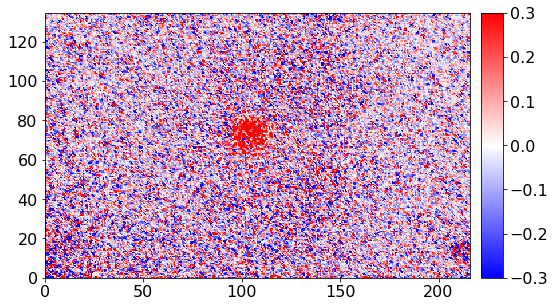

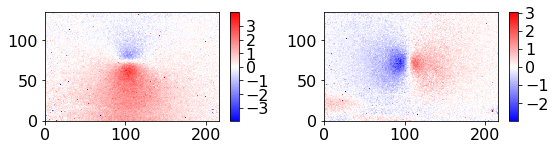

In [756]:
xx, yy = vel.get_equally_spaced_grid(udata_vortex, spacing=0.085*8)
graph.color_plot(xx, yy, omega[..., 0], cmap='bwr', vmin=-0.3, vmax=0.3)
graph.color_plot(xx, yy, udata_vortex[0, ..., 0], cmap='bwr', fignum=2, subplot=121)
graph.color_plot(xx, yy, udata_vortex[1, ..., 0], cmap='bwr', fignum=2, subplot=122)

(1024, 1024, 2)
Using tqdm_notebook. If this is a mistake, set notebook=False
0.5000000000000285 0.7071067811865477 1.4142135623730148
0.5000000000000285 0.7071067811865477 1.4142135623730148
0.46769375595116447 0.5004993929094558 1.0701434144477155
Using tqdm_notebook. If this is a mistake, set notebook=False
0.3528628566272914 0.4990234375000001 1.4142135623730148
0.3528628566272914 0.4990234375000001 1.4142135623730148
Using tqdm_notebook. If this is a mistake, set notebook=False
1.000000000000057 1.4142135623730954 1.4142135623730148
1.000000000000057 1.4142135623730954 1.4142135623730148
0.4286197547265242 0.5004993929094558 1.1677002457079786
Using tqdm_notebook. If this is a mistake, set notebook=False
0.7057257132545828 0.9980468750000002 1.4142135623730148
0.7057257132545828 0.9980468750000002 1.4142135623730148
Using tqdm_notebook. If this is a mistake, set notebook=False
2.000000000000114 2.8284271247461907 1.4142135623730148
2.000000000000114 2.8284271247461907 1.4142135623

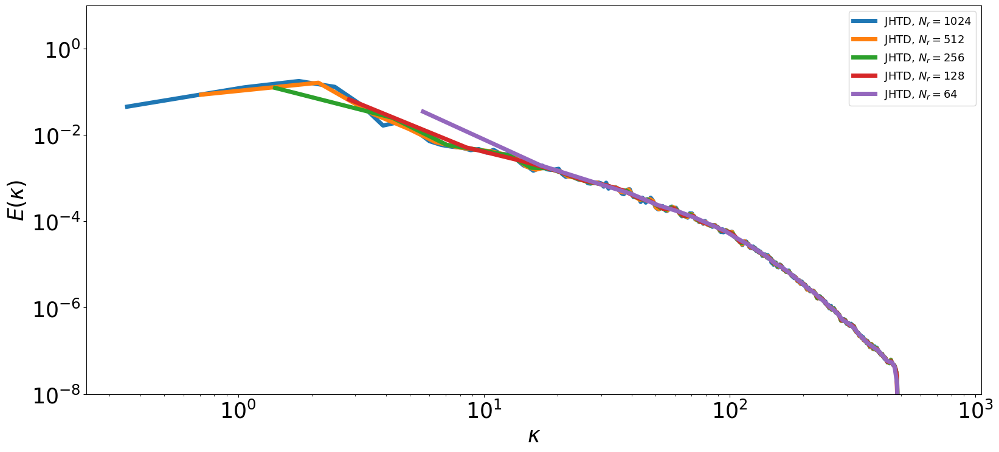

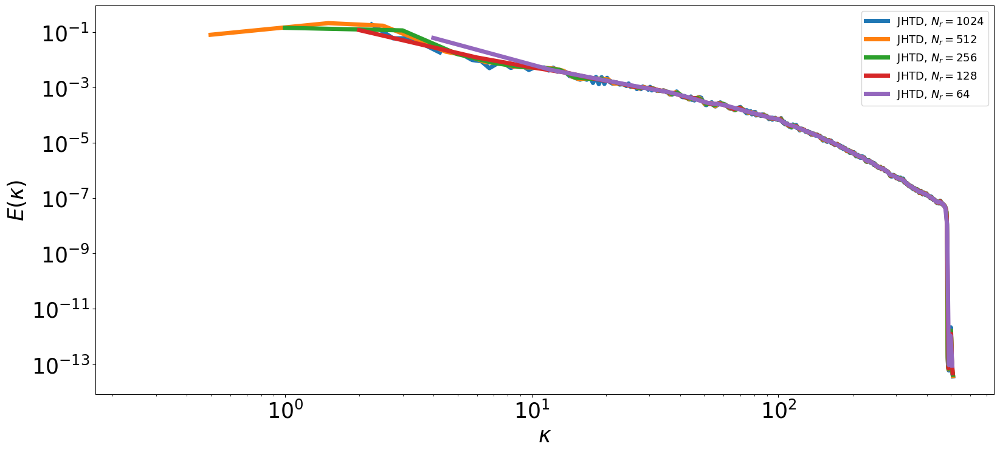

In [242]:
import importlib
## CHANGING deltak / deltakr
importlib.reload(vel)

nkouts = [1024, 512, 256, 128, 64]
dx = dy = 2*np.pi/1024
energy = vel.get_energy(udata_test)
print(energy.shape)
# fig, ax = graph.plot(k[:, 0], vel.kolmogorov_53_uni(k[:, 0], 0.085, c=1.5), color='k', label='$C \epsilon^{2/3} \kappa^{-5/3}$')
# fig, ax = graph.plot(k[:, 0], vel.kolmogorov_53_uni(k[:, 0], 0.085, c=1.5), color='k', label='$C \epsilon^{2/3} \kappa^{-5/3}$', fignum=2)

for nkout in nkouts:
    ek, _ , k = vel.get_energy_spectrum(udata2d, dx=dx, dy=dy, nkout=nkout, 
                                        remove_undersampled_region=False, 
                                        window='flattop')
    fig, ax = graph.plot(k[:, 0], ek[:, 0], label='JHTD, $N_{r}=%d$' % nkout)
    print(np.trapz(ek[:, 0], k[:, 0]), vel.get_spatial_avg_energy(udata_test)[0][0], vel.get_spatial_avg_energy(udata_test)[0][0] / np.trapz(ek[:, 0], k[:, 0]))
      
    
    ek, _, k = vel.get_energy_spectrum(udata, dx=dx, dy=dy, nkout=nkout, 
                                       remove_undersampled_region=True, 
                                       window='flattop')
    fig2, ax2 = graph.plot(k[:, 0], ek[:, 0], label='JHTD, $N_{r}=%d$' % nkout, fignum=2)
#     print np.trapz(ek[:, 0], k[:, 0]), vel.get_spatial_avg_energy(udata_test)[0][0], vel.get_spatial_avg_energy(udata_test)[0][0] / np.trapz(ek[:, 0], k[:, 0])
    
graph.tologlog(ax)
graph.labelaxes(ax, '$\kappa$', '$E(\kappa)$')
ax.set_ylim(10**-8, 10**1)
ax.legend()
fig.tight_layout()


graph.tologlog(ax2)
graph.labelaxes(ax2, '$\kappa$', '$E(\kappa)$')
# ax2.set_ylim(10**-8, 10**1)
ax2.legend()
fig2.tight_layout()

# graph.save('./jhtd_e_spec')

In [436]:
(4/np.pi)**2 * np.sqrt(2)

2.2926366730030256

In [ ]:
np.trapez()

Using tqdm_notebook. If this is a mistake, set notebook=False
0.4411862822788113 0.6239316239316242 1.4142135623730148
0.4411862822788113 0.6239316239316242 1.4142135623730148
Using tqdm_notebook. If this is a mistake, set notebook=False
0.44086119609428964 1.2469437652811735 2.8284271247462707
0.44086119609428964 1.2469437652811735 2.8284271247462707
Using tqdm_notebook. If this is a mistake, set notebook=False
0.4402086333857428 2.4901960784313726 5.656854249492381
0.4402086333857428 2.4901960784313726 5.656854249492381
Using tqdm_notebook. If this is a mistake, set notebook=False
0.43674242367404403 4.9411764705882355 11.313708498984761
0.43674242367404403 4.9411764705882355 11.313708498984761
Using tqdm_notebook. If this is a mistake, set notebook=False
0.4298100042506464 9.725490196078429 22.627416997969522
0.4298100042506464 9.725490196078429 22.627416997969522
Using tqdm_notebook. If this is a mistake, set notebook=False
0.4242640687119284 19.199999999999996 45.254833995939045
0

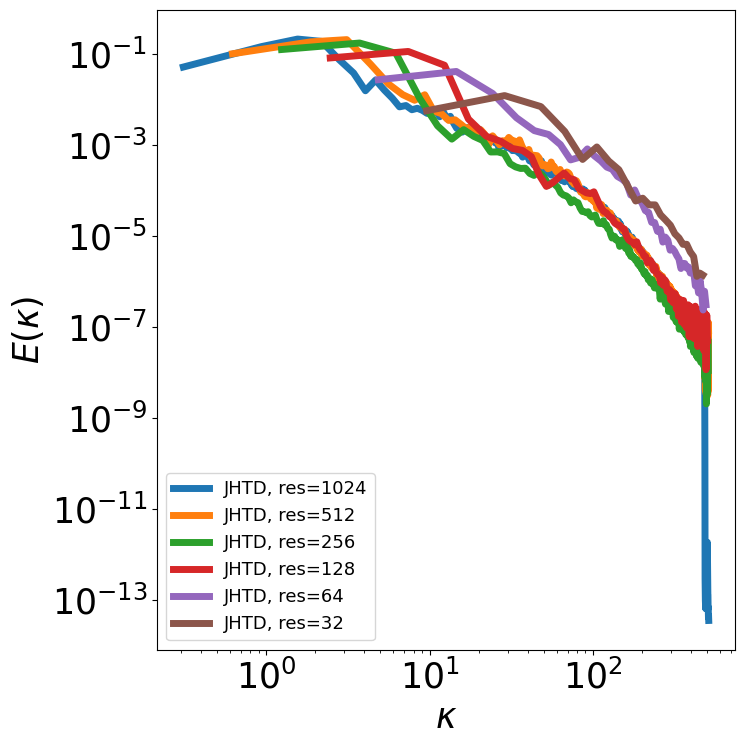

In [243]:
# CROPPING EFFECT ON E(K)
reload(vel)

resolutions = [1024, 512, 256, 128, 64]
# fig, ax = graph.plot(k[:, 0], vel.kolmogorov_53_uni(k[:, 0], 0.08), color='k', label='$C \epsilon^{2/3} \kappa^{-5/3}$')
for res in resolutions:
    x0, y0 = 0, 0
    ek, _, k = vel.get_energy_spectrum(udata_test, dx=dx, dy=dy, window='flattop', x1=x0 + res, y1=y0 + res)
    fig, ax = graph.plot(k[:, 0], ek[:, 0], label='JHTD, res=%d' % res, figsize=(8, 8))
    
graph.tologlog(ax)
graph.labelaxes(ax, '$\kappa$', '$E(\kappa)$')
# ax.set_ylim(10**-8, 10**1)
ax.legend()
fig.tight_layout()


1.0
1.0
524811.6514194043 0.9999999999999432 524811.6514194042
0.12179420874071004
0.12184028358203186
524811.6514194213 0.9999999999999432 63919.01982253376


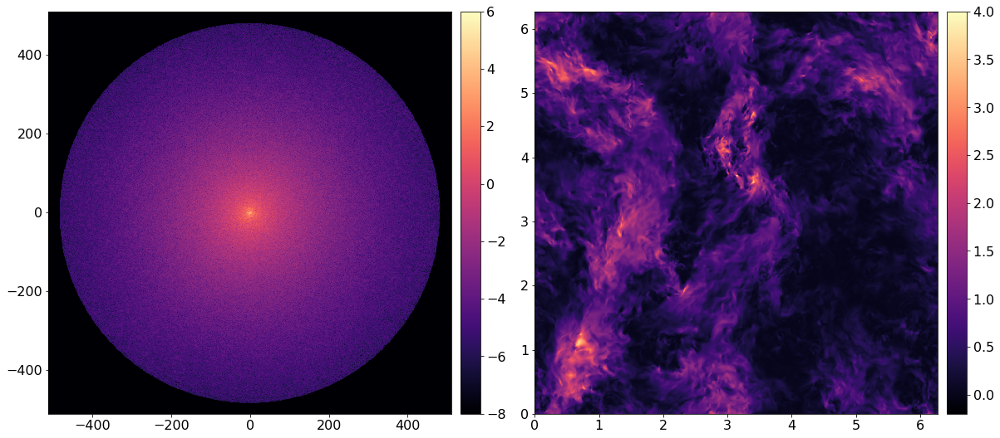

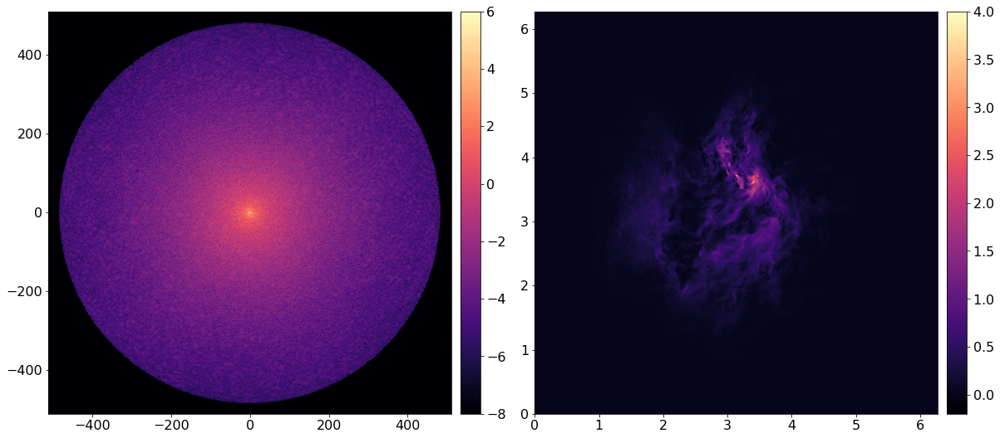

In [517]:
reload(vel)


xx, yy = vel.get_equally_spaced_grid(udata_test, spacing=dx)
energy = vel.get_energy(udata_test)
windows = vel.get_window_radial(xx, yy, wtype='flattop', duration=2)
udata_test_tapered = np.stack((udata_test[0, ...] * windows, udata_test[1, ...] * windows))
energy_tapered = vel.get_energy(udata_test_tapered)

# NO WINDOWING 
eks, ks = vel.get_energy_spectrum_nd(udata_test, dx=dx, dy=dy)
graph.color_plot(ks[0, ...], ks[1, ...], eks[..., 0], log10=True, option=None, vmax=6, vmin=-8, subplot=121)
graph.color_plot(xx, yy, energy[..., 0], subplot=122, figsize=(17, 8), vmin=-0.2, vmax=4)


a = np.sum(eks[..., 0]*(ks[0, 0, 1]-ks[0,0,0])**2)
print np.sum(eks[..., 0]*(ks[0, 0, 1]-ks[0,0,0])**2), ks[0, 0, 1]-ks[0,0,0], np.sum(energy[..., 0])

# WINDOWING
eks, ks = vel.get_energy_spectrum_nd(udata_test, dx=dx, dy=dy, x1=1024, y1=1024, window='flattop')
graph.color_plot(ks[0, ...], ks[1, ...], eks[..., 0], log10=True, option=None, fignum=2, vmax=6, vmin=-8, subplot=121)
graph.color_plot(xx, yy, energy_tapered[..., 0], fignum=2, subplot=122, figsize=(17, 8), vmin=-0.2, vmax=4)
print np.sum(eks[..., 0]*(ks[0, 0, 1]-ks[0,0,0])**2), ks[0, 0, 1]-ks[0,0,0], np.sum(energy_tapered[..., 0])
# # print a / np.sum(eks[..., 0]*(ks[0, 0, 1]-ks[0,0,0])**2), (1024/64)**2
# # print 421/256.

# # xx, 
# # window = vel.get_window_radial()

Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Using tqdm_notebook. If this is a mistake, set notebook=False
Saving figure to './espec_jhtd/ek_general_0_cc1p75_eps0p085.pdf'... ... Done


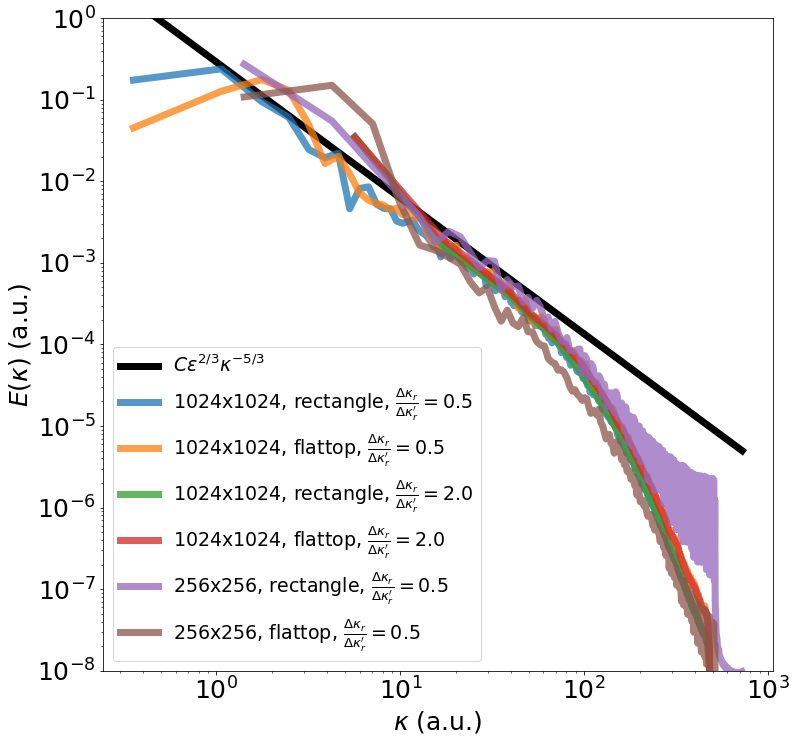

In [678]:
reload(vel)
import library.basics.formatarray as fa
__fontsize__ = 25
__figsize__ = (12, 12)
# See all available arguments in matplotlibrc
params = {'figure.figsize': __figsize__,
          'font.size': __fontsize__,  #text
        'legend.fontsize':19, # legend
         'axes.labelsize': __fontsize__, # axes
         'axes.titlesize': __fontsize__,
         'xtick.labelsize': __fontsize__, # tick
         'ytick.labelsize': __fontsize__,
         'lines.linewidth': 7}
graph.update_figure_params(params)

cc = 1.75
energy = vel.get_energy(udata_test)

fig, ax = graph.plot(k[:, 0], vel.kolmogorov_53_uni(k[:, 0], 0.085, c=1.5),
                     color='k', label='$C \epsilon^{2/3} \kappa^{-5/3}$', fignum=1)

ek, _, k = vel.get_energy_spectrum(udata_test, dx=dx, dy=dy, nkout=1024, remove_undersampled_region=False, cc=cc)
ek_w, _, k_w = vel.get_energy_spectrum(udata_test, dx=dx, dy=dy, nkout=1024, remove_undersampled_region=False, window='flattop', cc=cc)

ek2, _, k2 = vel.get_energy_spectrum(udata_test, dx=dx, dy=dy, nkout=64, remove_undersampled_region=False, cc=cc)
ek2w, _, k2w = vel.get_energy_spectrum(udata_test, dx=dx, dy=dy, nkout=64, remove_undersampled_region=False, window='flattop', cc=cc)

ek3, _, k3 = vel.get_energy_spectrum(udata_test, x1=256, y1=256, dx=dx, dy=dy, nkout=256, remove_undersampled_region=False, cc=cc)
ek3w, _, k3w = vel.get_energy_spectrum(udata_test, x1=256, y1=256, dx=dx, dy=dy, nkout=256, remove_undersampled_region=False, window='flattop', cc=cc)


fig, ax = graph.plot(k[:, 0], ek[:, 0], alpha=0.75, label='1024x1024, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
fig, ax = graph.plot(k_w[:, 0], ek_w[:, 0], alpha=0.75, label='1024x1024, flattop, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
fig, ax = graph.plot(k2[:, 0], ek2[:, 0], alpha=0.75, label='1024x1024, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=2.0$')
fig, ax = graph.plot(k2w[:, 0], ek2w[:, 0], alpha=0.75, label='1024x1024, flattop, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=2.0$')
fig, ax = graph.plot(k3[:, 0], ek3[:, 0], alpha=0.75, label='256x256, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
fig, ax = graph.plot(k3w[:, 0], ek3w[:, 0], alpha=0.75, label='256x256, flattop, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$')
graph.labelaxes(ax, '$\kappa$ (a.u.)', '$E(\kappa)$ (a.u.)')
graph.tologlog(ax)
ax.set_ylim(10**-8, 10**0)
ax.legend(loc=3)
graph.save('./espec_jhtd/' + 'ek_general_0_cc1p75_eps0p085')

Using tqdm_notebook. If this is a mistake, set notebook=False
0.5000000000000285 0.7071067811865477 1.4142135623730148


TypeError: unsupported operand type(s) for *: 'float' and 'QuadMesh'

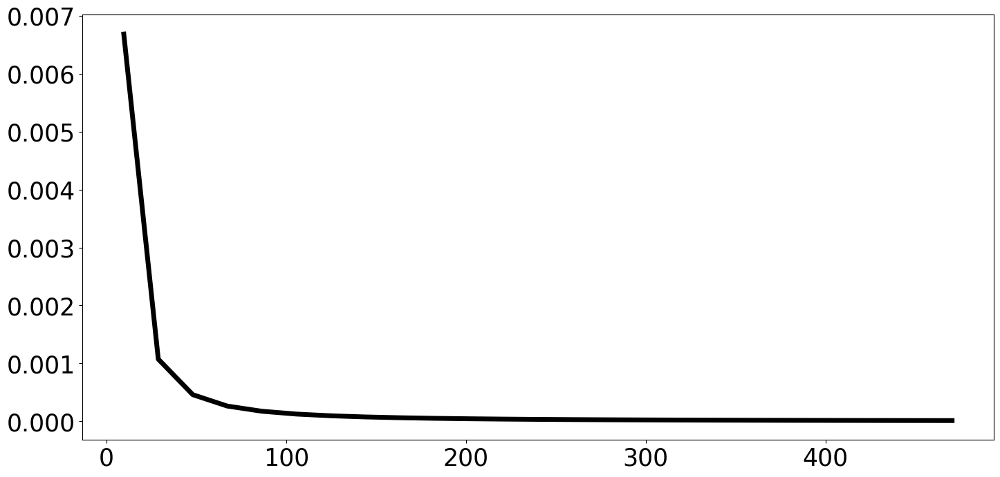

In [244]:
reload(vel)
fig, ax = graph.plot(k[:, 0], vel.kolmogorov_53_uni(k[:, 0], 0.085, c=1.5),
                     color='k', label='$C \epsilon^{2/3} \kappa^{-5/3}$', fignum=1)


ek, _, k = vel.get_energy_spectrum(udata2d, dx=dx, dy=dy, nkout=1024, remove_undersampled_region=False, cc=cc)
# ek2, _, k2 = vel.get_energy_spectrum(udata2d, dx=dx, dy=dy, nkout=1024, remove_undersampled_region=False, cc=cc)
fig, ax = graph.plot(k[:, 0], ek[:, 0], alpha=0.75, label='1024x1024, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$,\n average')
fig, ax = graph.plot(k2[0:, 0], ek2[0:, 0], alpha=0.75, label='1024x1024, rectangle, $\\frac{\Delta \kappa_r}{\Delta \kappa_r\'}=0.5$,\n weighted average')
graph.labelaxes(ax, '$\kappa$ (a.u.)', '$E(\kappa)$ (a.u.)')
graph.tologlog(ax)
ax.set_xlim(10**-0.5, 10**3)
ax.set_ylim(10**-8, 10**0)
ax.legend(loc=3)
# graph.save('./espec_jhtd/' + 'ek_general_1_weighted_avg')

(<matplotlib.figure.Figure at 0x150a8f250>,
 <matplotlib.collections.QuadMesh at 0x155307c10>)

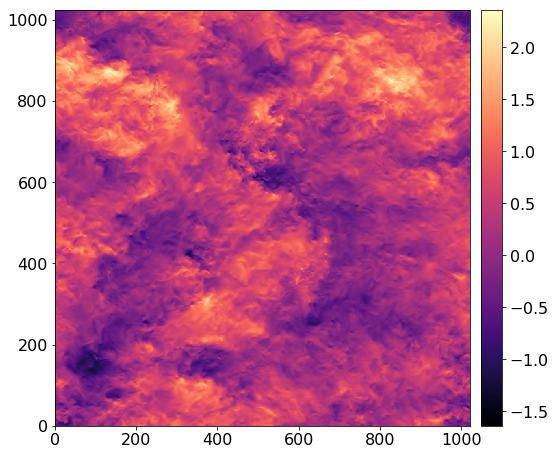

In [575]:
xx, yy = vel.get_equally_spaced_grid(udata_test)
graph.color_plot(xx, yy, udata_test[0, ..., 0])

## FILTERED TURBULENT FIELD

(<Figure size 2000x3000 with 12 Axes>,
 <AxesSubplot:>,
 <matplotlib.collections.QuadMesh at 0x7ffc9482bc90>)

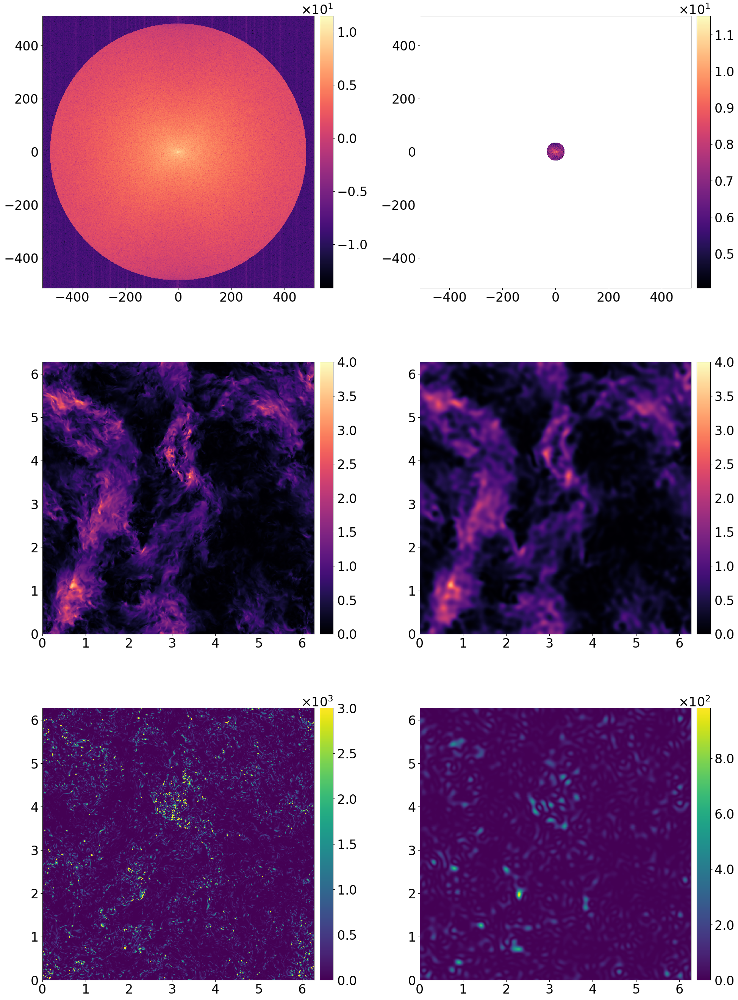

In [49]:
import copy
udata, xxx, yyy, zzz = vel.get_sample_turb_field_3d()
udata = udata[:2, :, :, 0, 0]
xx, yy = xxx[..., 0], yyy[..., 0]
dx, dy = vel.get_grid_spacing(xx, yy)
kxx, kyy = vel.get_kgrids(xx.shape[0], xx.shape[1], dx=dx, dy=dy, shift=True)
krr = np.sqrt(kxx ** 2 + kyy ** 2)

uk = np.fft.fftshift(np.fft.fftn(udata, axes=(1, 2)))

def apply_low_pass_filter(uk, krr, krMax):
    uk_ = copy.deepcopy(uk)
    keep = krr < krMax
    for d in range(uk_.shape[0]):
        uk_[d, ...][~keep] = 0
    return uk_

# def apply_high_pass_filter(uk, krr, krMin):
#     uk_ = copy.deepcopy(uk)
#     keep = krr > krMin
#     for d in range(uk_.shape[0]):
#         uk_[d, ...][~keep] = 0
#     return uk_

uk_filtered = apply_low_pass_filter(uk, krr, 32)
udata_filtered = np.fft.ifftn(np.fft.ifftshift(uk_filtered), axes=(1, 2)).real

energy = vel.get_energy(udata)
energy_filtered = vel.get_energy(udata_filtered)

enst = vel.get_enstrophy(udata, xx=xx, yy=yy)[..., 0]
enst_filtered = vel.get_enstrophy(udata_filtered, xx=xx, yy=yy)[..., 0]


# power
graph.color_plot(kxx, kyy, np.abs(uk[0, ...])**2 + np.abs(uk[0, ...])**2, log10=True, subplot=321, figsize=(20, 30))
graph.color_plot(kxx, kyy, np.abs(uk_filtered[0, ...])**2 + np.abs(uk_filtered[0, ...])**2, log10=True, subplot=322, figsize=(20, 30))
# energy
graph.color_plot(xx, yy, energy, log10=False, subplot=323, vmin=0, vmax=4, figsize=(20, 30))
graph.color_plot(xx, yy, energy_filtered, log10=False, subplot=324, vmin=0, vmax=4, figsize=(20, 30))

# enstrophy
graph.color_plot(xx, yy, enst, vmin=0, vmax=3000, cmap='viridis', log10=False, subplot=325, figsize=(20, 30))
graph.color_plot(xx, yy, enst_filtered, vmin=0, vmax=None, cmap='viridis', log10=False, subplot=326, figsize=(20, 30))



In [43]:

import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual, interactive_output


In [81]:
import copy

def vfieldConstuctor(m=32, phase0=0, phase1=0, signRand=False, exponent=-5./3., inc=1):

    kx, ky = vel.get_kgrids(m, m)
    kr = np.sqrt(kx**2+ky**2)
    dkx, dky = vel.get_grid_spacing(kx, ky)
    ek = 10*kr**(exponent/2.)
    ek[kr==0] = 1e-18
    ekx_cft, (y, x) = vel.fourier_transform_nd(ek, [dky, dkx], [0, 0])
    eky_cft = copy.deepcopy(ekx_cft)
    xx, yy = np.meshgrid(x[0, :], y[:, 0])
    dx, dy = vel.get_grid_spacing(xx, yy)
    # graph.color_plot(kx, ky, ek, log10=True)
    
    theta0 = phase0/(2*np.pi)
    theta1 = phase1/(2*np.pi)
    ekx_cft *= np.exp(theta0*1j)
    eky_cft *= np.exp(theta1*1j)
    win = vel.get_window_radial(kx, ky, )
#     eky_cft *= win

    ux = np.sqrt(np.abs(ekx_cft.real))
    uy = np.sqrt(np.abs(eky_cft.imag))
    if signRand:
        rot = np.cos(np.random.random(size=uy.shape)*2*np.pi)
        locx, locy = np.random.random(size=uy.shape) > 0.5, np.random.random(size=uy.shape) > 0.5
        ux[locx] *= rot[locx]
        uy[locy] *= rot[locy]
    udata=np.stack((ux, uy))
    ek_, ek_err, kr_ = vel.get_energy_spectrum(udata, dx=dx, dy=dy)
    # graph.color_plot(xx, yy, ek_cft.real)
    fig1, ax11, Q = graph.quiver(xx, yy, ux, uy, fignum=1, subplot=121, inc=inc)
    fig1, ax12 =graph.plot(kr_, ek_[..., 0], fignum=1, subplot=122, figsize=(16, 6))
    graph.tologlog(ax12)
    
    xlim = np.log10(ax12.get_xlim())
    ylim = np.log10(ax12.get_ylim())
    w, h = xlim[1]-xlim[0], ylim[1]-ylim[0]
    graph.draw_power_triangle(ax12, 10**(xlim[0]+w*0.2), 10**(ylim[0]+h*0.7), exponent, flip=True, w=w*0.7)
    
w = interactive(vfieldConstuctor,
                m = widgets.IntSlider(min=8,max=64,step=1),
#                 n = widgets.IntSlider(min=8,max=64,step=1),
                phase0=widgets.FloatSlider(min=0,max=360,step=10,value=0),
                phase1=widgets.FloatSlider(min=0,max=360,step=10,value=0),
                signRand=False,
                exponent=widgets.FloatSlider(min=-5.1,max=-0.1,step=0.125,value=-5./3.), # value=0
                inc=widgets.IntSlider(min=1,max=16,step=1),
                continuous_update=False
                )
display(w)

interactive(children=(IntSlider(value=8, description='m', max=64, min=8), FloatSlider(value=0.0, description='…

In [87]:
# Dependecies for clean_udata()
from tqdm import tqdm
from scipy.signal import butter, medfilt

def clean_udata(udata,
                mask=None,
                method='nn', max_iter=10, tol=0.05, kernel_radius=2, kernel_sigma=2,
                fill_value=0, # for method=='fill'
                cutoff=np.inf,
                median_filter=True,
                replace_zeros=True,
                showtqdm=True, verbose=False, notebook=True, make_copy=True):
    """
    ND interpolation using direct convolution (replac_nan(...))

    Parameters
    ----------
    udata: nd array, velocity field data with shape (no of components, y, x, (z), t) or  (no of components, y, x, (z))
    mask: nd array, same shape as udata, default: None
        ... If it were not None, this function interpolates the
    method: str- options are 'fill', 'nn', 'local mean', 'idw'
        ... 'fill' (fill by a constant "fill_value")
        ... 'nn' (nearest neighbor filling),
        ... 'local mean',
        ... 'idw' (convolution with a Gaussian kernel)
    max_iter
    tol
    kernel_radius
    kernel_sigma
    fill_value
    cutoff
    median_filter
    replace_zeros: bool default: True
        ... Some softwares assign 0 as a velocity instead of na or np.nan
    showtqdm: bool, default: True
        ... If True, show tqdm for the processes: 1. removing np.nan 2. applying a median filter
    verbose: bool, default: False
        ... If True, it shows a tqdm progress bar for the iterations of the direct convolution method
    notebook: bool, If True, it uses tqdm_notebook instead of tqdm
    make_copy: bool, default: True
        ... If True, it creates a copy of the given udata, then modify the copied array.
            Without copying, it modifies the given array directly. (Why?- it should create a new copy

    Returns
    -------
    udata_i: Clean udata- no np.nan, no values greater than cutoff, a median filter is applied if specified
    """

    if notebook:
        from tqdm import tqdm_notebook as tqdm
        # print('Using tqdm_notebook. If this is a mistake, set notebook=False')
    else:
        from tqdm import tqdm

    if make_copy:
        udata_c = copy.deepcopy(udata) # make a deepcopy otherwise the passed udata would be modified
    else:
        udata_c = udata
    udata_c = fix_udata_shape(udata_c)
    dim = udata_c.shape[0]

    if dim == 2:
        ncomp, height, width, duration = udata_c.shape
    else:
        ncomp, height, width, depth, duration = udata_c.shape

    if mask is not None:
        udata_c[mask] = np.nan
    # manual cleaning
    udata_c[np.logical_or(np.abs(udata_c) > cutoff, np.isinf(udata_c))] = np.nan
    if replace_zeros:
        udata_c[udata_c == 0] = np.nan

    nnans = np.count_nonzero(np.isnan(udata_c))
    if nnans == 0:  # udata is already clean (No nan values and no values beyond cutoff)
        return udata_c

    # Method 1
    if method == 'nn':  # nearest neighbor filling
        udata_i = replace_nan_w_nn_udata(udata_c, notebook=notebook, showtqdm=showtqdm)
    elif method == 'fill':  # fill nans by a constant "fill_value"
        udata_i = copy.deepcopy(udata_c)
        udata_i[np.isnan(udata_i)] = fill_value
    else: # inpainting
        # Initialization of an inpainted field
        udata_i = np.empty_like(udata_c)
        for t in tqdm(range(duration), desc='replacing nans', disable=not showtqdm):
            for i in range(ncomp):
                udata_i[i, ..., t] = replace_nans(udata_c[i, ..., t], max_iter=max_iter, tol=tol,
                                                  kernel_radius=kernel_radius,
                                                  kernel_sigma=kernel_sigma, method=method, showtqdm=verbose)
    if median_filter:
        for t in tqdm(range(duration), desc='median filter', disable=not showtqdm):
            for i in range(ncomp):
                udata_i[i, ..., t] = medfilt(udata_i[i, ..., t], 2*kernel_radius+1)


    if notebook:
        from tqdm import tqdm as tqdm

    return udata_i

def fix_udata_shape(udata):
    """
    It is better to always have udata with shape (height, width, depth, duration) (3D) or  (height, width, duration) (2D)
    This method fixes the shape of udata whose shape is (height, width, depth) or (height, width)

    Parameters
    ----------
    udata: nd array,
          ... with shape (height, width, depth) (3D) or  (height, width, duration) (2D)
          ... OR shape (height, width, depth, duration) (3D) or  (height, width, duration) (2D)

    Returns
    -------
    udata: nd array, with shape (height, width, depth, duration) (3D) or  (height, width, duration) (2D)

    """
    shape = udata.shape  # shape=(dim, nrows, ncols, nstacks) if nstacks=0, shape=(dim, nrows, ncols)
    if shape[0] == 2:
        ux, uy = udata[0, ...], udata[1, ...]
        try:
            dim, nrows, ncols, duration = udata.shape
            return udata
        except:
            dim, nrows, ncols = udata.shape
            duration = 1
            ux = ux.reshape((ux.shape[0], ux.shape[1], duration))
            uy = uy.reshape((uy.shape[0], uy.shape[1], duration))
            return np.stack((ux, uy))

    elif shape[0] == 3:
        dim = 3
        ux, uy, uz = udata[0, ...], udata[1, ...], udata[2, ...]
        try:
            nrows, ncols, nstacks, duration = ux.shape
            return udata
        except:
            nrows, ncols, nstacks = ux.shape
            duration = 1
            ux = ux.reshape((ux.shape[0], ux.shape[1], ux.shape[2], duration))
            uy = uy.reshape((uy.shape[0], uy.shape[1], uy.shape[2], duration))
            uz = uz.reshape((uz.shape[0], uz.shape[1], uz.shape[2], duration))
            return np.stack((ux, uy, uz))
        
def replace_nan_w_nn_udata(udata, notebook=False, verbose=False, showtqdm=True):
    """
    The fastest and most robust function to fill the missing values in udata

    Parameters
    ----------
    udata
    verbose: str, default: False

    Returns
    -------
    udata_filled: ND array with shape (dim, height, width, depth, duration) or  (dim, height, width, duration)
            ... missing values (np.nan) are filled with the nearest neighbors
    """
    if notebook:
        from tqdm import tqdm_notebook as tqdm
        # print('Using tqdm_notebook. If this is a mistake, set notebook=False')
    else:
        from tqdm import tqdm

    udata = fix_udata_shape(udata)
    dim, duration = udata.shape[0], udata.shape[-1]

    udata_filled = np.empty_like(udata)
    for t in tqdm(range(duration), desc='replace_nan_w_nn_udata', disable=not showtqdm):
        for i in range(dim):
            udata_filled[i, ..., t] = replace_nan_w_nn(udata[i, ..., t], verbose=verbose)

    if notebook:
        from tqdm import tqdm as tqdm

    return udata_filled

def replace_nans(array, max_iter=50, tol=0.05, kernel_radius=2, kernel_sigma=2, method='nn',
                 notebook=True, verbose=False, showtqdm=True):
    """Replace NaN elements in an array using an iterative image inpainting algorithm.
    The algorithm is the following:
    1) For each element in the input array, replace it by a weighted average
    of the neighbouring elements which are not NaN themselves. The weights depends
    of the method type. If ``method=localmean`` weight are equal to 1/( (2*kernel_size+1)**2 -1 )
    2) Several iterations are needed if there are adjacent NaN elements.
    If this is the case, information is "spread" from the edges of the missing
    regions iteratively, until the variation is below a certain threshold.

    - Generalized to nD array by Takumi Matsuzawa (UChicago) 2020/02/20
    ... one could use array multiplication over loops for better runtime.

    Parameters
    ----------
    array : nd np.ndarray
    an array containing NaN elements that have to be replaced
    max_iter : int
    the number of iterations
    kernel_size : int
    the size of the kernel, default is 1
    method : str
        ... the method used to replace invalid values. Valid options are
        'nn' (nearest neighbor filling- the fastest method)`localmean`, 'idw' (Gaussian kernel).
    Returns
    -------
    filled : nd np.ndarray
    a copy of the input array, where NaN elements have been replaced.
    """

    def makeGaussianKernel(size, sigma, dim):
        x = np.arange(size)
        xi = tuple([x for i in range(dim)])
        grids = np.meshgrid(*xi)
        pos = np.empty(grids[0].shape + (dim,))
        for i in range(dim):
            pos[..., i] = grids[i]

        # Get Gaussian distribution
        mean = np.ones(dim) * size / 2
        cov = []
        for i in range(dim):
            cov_tmp = []
            for j in range(dim):
                if j == i:
                    cov_tmp.append(sigma)
                else:
                    cov_tmp.append(0)
            cov.append(cov_tmp)
        rv = multivariate_normal(mean=mean, cov=cov)
        gkernel = rv.pdf(pos) / np.sum(rv.pdf(pos))
        return gkernel

    if notebook:
        from tqdm import tqdm_notebook as tqdm
        # print('Using tqdm_notebook. If this is a mistake, set notebook=False')
    else:
        from tqdm import tqdm

    array = np.asarray(array)
    dim = len(array.shape)

    # fill new array with input elements
    filled = copy.deepcopy(array)

    # make kernel
    kernel_size = kernel_radius * 2 + 1
    kernel_shape = ()
    for i in range(dim):
        kernel_shape += (2 * kernel_size + 1,)
    kernel = np.empty(kernel_shape)

    # indices where array is NaN
    ind_nans = np.asarray(np.nonzero(np.isnan(array)))

    # number of NaN elements
    n_nans = len(ind_nans[0])

    # arrays which contain replaced values to check for convergence
    replaced_new = np.zeros(n_nans)
    replaced_old = np.zeros(n_nans)

    # Make a kernel
    if method == 'localmean':
        #         print('kernel_size', kernel_size)
        kernel = np.ones(kernel_shape)
    elif method == 'idw':  # inverse distance weighting (with gaussian kernel)
        kernel = makeGaussianKernel(kernel_size, kernel_sigma, dim)
    #         print(kernel.shape, 'kernel')
    elif method == 'nn':  # newarest neighbor
        filled = replace_nan_w_nn(array, notebook=notebook)
    else:
        raise ValueError('method is not valid. Choose from idw and localmean')

    # make several passes
    # until we reach convergence
    for it in tqdm(range(max_iter), desc='Loop until it gets below tolerance', disable=not showtqdm):
        # for each NaN element
        for p in tqdm(range(n_nans), desc='looping over missing values', disable=not showtqdm):
            nan_indices = tuple(ind_nans[:, p])

            # initialize nan values to zero
            filled[nan_indices] = 0.0
            n = 0

            # loop over the kernel
            for kindices in itertools.product(range(kernel_size), repeat=dim):
                # Check if a kernel includes region outside the boundaries
                isInsideBoundary = True
                for q in range(dim):
                    index = nan_indices[q] + kindices[q] - kernel_radius
                    isInsideBoundary *= index < array.shape[q] and index >= 0
                # if the element at (indices) were inside the boundary,
                # convolve the original array with the kernel
                if isInsideBoundary:
                    indices = ()
                    for q in range(dim):
                        index = nan_indices[q] + kindices[q] - kernel_radius
                        indices += (index,)
                    # Convolute the array with the kernel if the array element is not nan
                    if not np.isnan(filled[indices]):
                        # Don't sum itself
                        if not all([kindices[q] - kernel_radius == 0 for q in range(dim)]):
                            # convolve kernel with original array
                            filled[nan_indices] = filled[nan_indices] + filled[indices] * kernel[kindices]
                            n = n + 1 * kernel[kindices]

            # divide value by effective number of added elements
            if n != 0:
                filled[nan_indices] = filled[nan_indices] / n
            else:
                filled[nan_indices] = np.nan
            replaced_new[p] = filled[nan_indices]

        # check if mean square difference between values of replaced elements is below a threshold
        if verbose:
            print('convergence check: ', np.nanmean((replaced_new - replaced_old) ** 2))
        variance = np.nanmean((replaced_new - replaced_old) ** 2)
        if variance < tol:
            break
        else:
            if it == max_iter - 1 and not np.isnan(variance):
                print('... replace_nan: did not converge within %d iterations.\n \
                      Refining max_int and tol. is recommended' % it)
                print('variance: ', variance)
            replaced_old = copy.deepcopy(replaced_new)

    if notebook:
        from tqdm import tqdm as tqdm

    return filled

# Example
# Load from Frame t to t+1
with h5py.File(dataname, mode='r') as f:
    ux = f['ux'][..., t:t+1]
    uy = f['uy'][..., t:t+1]
    udata = np.stack((ux, uy))
    # Fastest method to remove all nans- replace them with the nearest neighbors
    udata_clean = clean_udata(udata, method='nn', median_filter=False, notebook=False) # remove nans
    # Second fastest method to remove all nans- replace them with the local means
    #- With this exaple, it computes teh local average by convolving with a 5x5 kernel
    udata_clean = clean_udata(udata, method='localmean', kernel_radius=2, median_filter=False, notebook=False) # remove nans
#     # Slowwest method to remove all nans- replace them with the gaussian-weighted means
#     # Like the second method, 
#     udata_clean = clean_udata(udata, method='idw', kernel_radius=2, median_filter=False, notebook=False) # remove nans

    

NameError: name 'h5py' is not defined